# **CP462 Project: Predictive Analytics for Hit Songs**


# หัวข้อ : **Predictive Analytics for Hit Songs: การใช้ข้อมูล Spotify ในการคาดการณ์ความนิยมเพลง**

**สมาชิก:**
<br>1) นายติณณภพ ทองหนุน (ID : 66102010139)
<br>2) นางสาวไอลดา เกะผิง ชัว (ID : 66102010159)
<br>2) นายกรวิชญ์ ชูน้อย (ID : 66102010564)
<br><br>
**Dataset:** Spotify Tracks Dataset <br>
**Source:** https://www.kaggle.com/datasets/maharshipandya/-spotify-tracks-dataset

## **Import Packages**

In [ ]:
import warnings

warnings.filterwarnings("ignore", category=DeprecationWarning)

In [ ]:
!pip install -U jupyter_client ipykernel tornado traitlets -qq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.1/106.1 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.0/118.0 kB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 443.9/443.9 kB 35.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.4/85.4 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 78.2 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires ipykernel==6.17.1, but you have ipykernel 7.1.0 which is incompatible.
google-colab 1.0.0 requires tornado==6.5.1, but you have tornado 6.5.2 which is incompatible.
notebook 6.5.7 requires jupyter-client<8,>=5.3.4, but you have jupyter-client 8.6.3 which is incompatible.
jupyter-kernel-gateway 2.5.2 requires jupyter-client<8.0,>=5.2.0, but you have jupyter-client 8.6.3 which is incompatible.


In [ ]:
!pip install feature-engine -qq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 230.0/230.0 kB 8.4 MB/s eta 0:00:00


In [ ]:
!pip install imbalanced-learn -qq

In [ ]:
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from mlxtend.frequent_patterns import apriori, association_rules
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score, precision_score, f1_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import RobustScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE

/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  # -----------------------------------------------------------------------------


## **Import Dataset**

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# โหลด dataset
file_path = "/content/dataset.csv"
df = pd.read_csv(file_path)

/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  # -----------------------------------------------------------------------------
/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  # -----------------------------------------------------------------------------
/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  # ----------

ตรวจสอบข้อมูลพื้นฐาน

In [ ]:
df.head()

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [ ]:
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 114000 entries, 0 to 113999
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        114000 non-null  int64  
 1   track_id          114000 non-null  object 
 2   artists           113999 non-null  object 
 3   album_name        113999 non-null  object 
 4   track_name        113999 non-null  object 
 5   popularity        114000 non-null  int64  
 6   duration_ms       114000 non-null  int64  
 7   explicit          114000 non-null  bool   
 8   danceability      114000 non-null  float64
 9   energy            114000 non-null  float64
 10  key               114000 non-null  int64  
 11  loudness          114000 non-null  float64
 12  mode              114000 non-null  int64  
 13  speechiness       114000 non-null  float64
 14  acousticness      114000 non-null  float64
 15  instrumentalness  114000 non-null  float64
 16  liveness          11

,Unnamed: 0,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,114000.000000,114000.000000,1.140000e+05,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000
mean,56999.500000,33.238535,2.280292e+05,0.566800,0.641383,5.309140,-8.258960,0.637553,0.084652,0.314910,0.156050,0.213553,0.474068,122.147837,3.904035
std,32909.109681,22.305078,1.072977e+05,0.173542,0.251529,3.559987,5.029337,0.480709,0.105732,0.332523,0.309555,0.190378,0.259261,29.978197,0.432621
min,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,-49.531000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,28499.750000,17.000000,1.740660e+05,0.456000,0.472000,2.000000,-10.013000,0.000000,0.035900,0.016900,0.000000,0.098000,0.260000,99.218750,4.000000
50%,56999.500000,35.000000,2.129060e+05,0.580000,0.685000,5.000000,-7.004000,1.000000,0.048900,0.169000,0.000042,0.132000,0.464000,122.017000,4.000000
75%,85499.250000,50.000000,2.615060e+05,0.695000,0.854000,8.000000,-5.003000,1.000000,0.084500,0.598000,0.049000,0.273000,0.683000,140.071000,4.000000
max,113999.000000,100.000000,5.237295e+06,0.985000,1.000000,11.000000,4.532000,1.000000,0.965000,0.996000,1.000000,1.000000,0.995000,243.372000,5.000000


### **Cleaning**
หาค่า missing values / duplicate rows

In [ ]:
print("Missing values:")
print(df.isnull().sum())
print("\nDuplicate rows:")
print(df.duplicated().sum())

Missing values:
Unnamed: 0          0
track_id            0
artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

Duplicate rows:
0


ตรวจสอบประเภทข้อมูล

In [ ]:
df.dtypes

,0
Unnamed: 0,int64
track_id,object
artists,object
album_name,object
track_name,object
popularity,int64
duration_ms,int64
explicit,bool
danceability,float64
energy,float64


ลบ missing value

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)
df.dropna(inplace=True)

In [ ]:
print(df.isnull().sum())

Unnamed: 0          0
track_id            0
artists             0
album_name          0
track_name          0
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64


In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)
#drop column ที่ไม่จำเป็น
df = df.drop(columns=["Unnamed: 0"])
df = df.drop(columns=["track_id", "artists", "album_name", "track_name"])

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)
df.head()

,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

numerical_features = [
    'popularity', 'duration_ms', 'danceability', 'energy', 'valence',
    'acousticness', 'instrumentalness', 'liveness', 'speechiness',
    'tempo', 'loudness'
]
categorical_features = [
    'explicit',       # 0/1
    'key',            # 0-11
    'mode',           # 0/1
    'time_signature', # 3-7
    'track_genre'     # 0-113
]

ตรวจสอบค่าผิดปกติ


* popularity → [0,100]
* duration_ms → [30,000, 600,000]
* danceability/energy/valence/acousticness/instrumentalness/liveness/speechiness → [0,1]
* tempo → [40, 250]
* loudness → [-60, 0]
* key → [0,11]
* mode → {0,1}
* time_signature → [3,7]
* speechiness → > 0.66 ถือว่าเป็น podcast



In [ ]:
# คำนวณค่า mean, median, mode, std, min, max, quartiles ของคอลัมน์ที่เป็น numeric
# เลือกเฉพาะคอลัมน์ที่เป็น numeric
numeric_df = df[numerical_features]

# ค่าเฉลี่ย (Mean)
mean_values = numeric_df.mean()

# ค่ามัธยฐาน (Median)
median_values = numeric_df.median()

# ค่าฐานนิยม (Mode) → อาจมีหลายค่า เลือกค่าแรก
mode_values = numeric_df.apply(lambda x: stats.mode(x, keepdims=True).mode[0])

# ส่วนเบี่ยงเบนมาตรฐาน (Standard Deviation)
std_values = numeric_df.std()

# ค่าต่ำสุด (Minimum)
min_values = numeric_df.min()

# ค่าสูงสุด (Maximum)
max_values = numeric_df.max()

# ควอร์ไทล์ (Quartiles: Q1=25%, Q2=50%, Q3=75%)
quartiles = numeric_df.quantile([0.25, 0.5, 0.75])

print("ค่าเฉลี่ย (Mean):\n", mean_values, "\n")
print("ค่ามัธยฐาน (Median):\n", median_values, "\n")
print("ค่าฐานนิยม (Mode):\n", mode_values, "\n")
print("ส่วนเบี่ยงเบนมาตรฐาน (Std):\n", std_values, "\n")
print("ค่าต่ำสุด (Min):\n", min_values, "\n")
print("ค่าสูงสุด (Max):\n", max_values, "\n")
print("ควอร์ไทล์ (Quartiles):\n", quartiles, "\n")

ค่าเฉลี่ย (Mean):
 popularity              33.238827
duration_ms         228031.153387
danceability             0.566801
energy                   0.641383
valence                  0.474066
acousticness             0.314907
instrumentalness         0.156051
liveness                 0.213554
speechiness              0.084652
tempo                  122.147695
loudness                -8.258950
dtype: float64 

ค่ามัธยฐาน (Median):
 popularity              35.000000
duration_ms         212906.000000
danceability             0.580000
energy                   0.685000
valence                  0.464000
acousticness             0.169000
instrumentalness         0.000042
liveness                 0.132000
speechiness              0.048900
tempo                  122.017000
loudness                -7.004000
dtype: float64 

ค่าฐานนิยม (Mode):
 popularity               0.0000
duration_ms         162897.0000
danceability             0.6470
energy                   0.8760
valence                  0.96

ตรวจสอบค่าผิดปกติ

In [ ]:
# เงื่อนไข
conditions = {
    "popularity": lambda x: (x < 0) | (x > 100),
    "duration_ms": lambda x: (x < 30000) | (x > 600000),
    "danceability": lambda x: (x < 0) | (x > 1),
    "energy": lambda x: (x < 0) | (x > 1),
    "valence": lambda x: (x < 0) | (x > 1),
    "acousticness": lambda x: (x < 0) | (x > 1),
    "instrumentalness": lambda x: (x < 0) | (x > 1),
    "liveness": lambda x: (x < 0) | (x > 1),
    "speechiness": lambda x: (x < 0) | (x > 1),
    "tempo": lambda x: (x < 40) | (x > 250),
    "loudness": lambda x: (x < -60) | (x > 0),
    "key": lambda x: (x < 0) | (x > 11),
    "mode": lambda x: ~x.isin([0, 1]),
    "time_signature": lambda x: (x < 3) | (x > 7),
}

# ตรวจสอบค่าผิดปกติ
outliers = {}
for col, rule in conditions.items():
    if col in df.columns:
        mask = rule(df[col])
        outliers[col] = df[mask]

# รวมผลลัพธ์
for col, data in outliers.items():
    print(f"{col}: พบ {len(data)} ค่า outlier")

# ตรวจสอบ podcast (speechiness > 0.66)
podcasts = df[df["speechiness"] > 0.66]
print(f"\nพบ {len(podcasts)} track ที่ speechiness > 0.66 (นับเป็น podcast)")


popularity: พบ 0 ค่า outlier
duration_ms: พบ 619 ค่า outlier
danceability: พบ 0 ค่า outlier
energy: พบ 0 ค่า outlier
valence: พบ 0 ค่า outlier
acousticness: พบ 0 ค่า outlier
instrumentalness: พบ 0 ค่า outlier
liveness: พบ 0 ค่า outlier
speechiness: พบ 0 ค่า outlier
tempo: พบ 174 ค่า outlier
loudness: พบ 90 ค่า outlier
key: พบ 0 ค่า outlier
mode: พบ 0 ค่า outlier
time_signature: พบ 1136 ค่า outlier

พบ 880 track ที่ speechiness > 0.66 (นับเป็น podcast)


ตรวจสอบ outlier

In [ ]:
# --- ฟังก์ชันตรวจสอบ Outliers ด้วย Z-Score ---
def detect_outliers_zscore(data, threshold=3):
    z_scores = np.abs(stats.zscore(data, nan_policy='omit'))
    return np.where(z_scores > threshold)[0]   # คืน index ที่เป็น outlier

# --- ฟังก์ชันตรวจสอบ Outliers ด้วย IQR ---
def detect_outliers_iqr(data, k=1.5):
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - k * IQR
    upper_bound = Q3 + k * IQR
    return np.where((data < lower_bound) | (data > upper_bound))[0]

outlier_results = {}

for col in numerical_features:
    data = df[col].dropna().values

    z_outliers = detect_outliers_zscore(data)
    iqr_outliers = detect_outliers_iqr(data)

    outlier_results[col] = {
        "Z-score count": len(z_outliers),
        "IQR count": len(iqr_outliers)
    }

# --- Step 6: แสดงผล ---
outlier_summary = pd.DataFrame(outlier_results).T
print(outlier_summary)

                  Z-score count  IQR count
popularity                    0          2
duration_ms                 946       5616
danceability                157        620
energy                        0          0
valence                       0          0
acousticness                  0          0
instrumentalness              0      25246
liveness                   3634       8642
speechiness                2079      13211
tempo                       201        617
loudness                   2475       6173


### **Transforming**

เอาตัวที่ผิดกฏ ผิดธรรมชาติออก

In [ ]:
print(f"Original shape: {df.shape}")

# ตัด Podcast (ต้องทำก่อน Log เพราะค่า Threshold 0.66 อิงจากค่าดิบ)
df_final = df[df['speechiness'] <= 0.66].copy()

# แก้ Time Signature ที่ผิดปกติ (Fix Invalid Values)
# กฎ: ควรอยู่ระหว่าง 3-7 ถ้าไม่อยู่ให้แก้เป็นค่า Median ของข้อมูลทั้งหมด
ts_median = df_final['time_signature'].median()
df_final.loc[
    (df_final['time_signature'] < 3) | (df_final['time_signature'] > 7),
    'time_signature'
] = ts_median

# ตัดค่าที่เป็นไปไม่ได้
df_final = df_final[
    (df_final['duration_ms'] >= 30000) & (df_final['duration_ms'] <= 600000) & # 30วิ - 10นาที
    (df_final['tempo'] >= 40) & (df_final['tempo'] <= 250) &
    (df_final['loudness'] >= -60) & (df_final['loudness'] <= 0)
].copy()

# Drop Null ใน Column สำคัญ (ถ้ามี)
df_final.dropna(subset=['popularity'], inplace=True)

print(f"Shape after global cleaning: {df_final.shape}")

Original shape: (113999, 16)
Shape after global cleaning: (112267, 16)


### **Enriching**


In [ ]:
# กำหนดเกณฑ์
threshold = 70

# สร้าง column ใหม่ "is_hit"
df_final["is_hit"] = df_final["popularity"].apply(lambda x: 1 if x >= threshold else 0)

# ดูตัวอย่าง
df_final[["popularity", "is_hit"]].head(10)

,popularity,is_hit
0,73,1
1,55,0
2,57,0
3,71,1
4,82,1
5,58,0
6,74,1
7,80,1
8,74,1
9,56,0


In [ ]:
print("Class Distribution:")
print(df_final['is_hit'].value_counts(normalize=True))

Class Distribution:
is_hit
0    0.951295
1    0.048705
Name: proportion, dtype: float64


### **Transform/ต่อ**

เปลี่ยนชนิดข้อมูล

In [ ]:
#column explicit เดิมเป็น boolean แปลงเป็น [0/1]
df_final['explicit'] = df_final['explicit'].astype(int)

In [ ]:
# 1. เช็คจาก Genre (ถ้ามี column 'track_genre')
# นี่คือวิธีกำจัด "ไม่ใช่เพลง" ที่แม่นยำที่สุด
non_music_genres = [
    'white-noise', 'rain', 'sleep', 'asmr', 'comedy',
    'spoken-word', 'study', 'sound-effects', 'grindcore' # grindcore บางทีก็ noise จัดๆ ถ้าไม่ชอบก็ตัดได้
]

# กรองเอาเฉพาะ row ที่ genre ตรงกับรายการข้างบน
junk_genre_df = df_final[df_final['track_genre'].isin(non_music_genres)]

print(f"เจอ Genre ที่ไม่ใช่เพลง: {len(junk_genre_df)} เพลง")
# ถ้าอยากลบ: df_final = df_final[~df_final['track_genre'].isin(non_music_genres)]


# 2. เช็ค "เพลงตาย" (Dead Tracks)
# คือเพลงที่ค่า Energy, Popularity, Tempo เป็น 0 หรือต่ำผิดปกติพร้อมกัน
dead_tracks_df = df_final[
    (df_final['popularity'] == 0) &
    (df_final['tempo'] < 30) &       # ช้าเกินมนุษย์เล่น
    (df_final['energy'] < 0.01)      # ไม่มีพลังงานเลย
]

print(f"เจอเพลงที่ดูเหมือนข้อมูลเสีย (Dead Tracks): {len(dead_tracks_df)} เพลง")

เจอ Genre ที่ไม่ใช่เพลง: 3074 เพลง
เจอเพลงที่ดูเหมือนข้อมูลเสีย (Dead Tracks): 0 เพลง


In [ ]:
print(f"จำนวนข้อมูลก่อนลบ: {df_final.shape}")

df_final = df_final[~df_final['track_genre'].isin(non_music_genres)].copy()

print(f"จำนวนข้อมูลหลังลบ: {df_final.shape}")

จำนวนข้อมูลก่อนลบ: (112267, 17)
จำนวนข้อมูลหลังลบ: (109193, 17)


In [ ]:
# ==============================================================================
# 🧹 โค้ดลบข้อมูลซ้ำแบบ Advance (ดูที่เนื้อใน Audio Features เท่านั้น)
# ==============================================================================

# 1. ระบุคอลัมน์ที่เป็น "DNA ของเพลง" (ตัด Popularity และ is_hit ออกจากการพิจารณา)
# เราจะเช็คซ้ำเฉพาะค่าเหล่านี้ ถ้าค่าพวกนี้เหมือนกัน = เพลงเดียวกันแน่นอน
check_cols = [
    'duration_ms', 'loudness', 'tempo', 'liveness', 'valence',
    'instrumentalness', 'acousticness', 'speechiness', 'danceability', 'energy',
    'key', 'mode', 'time_signature'  # ใส่เพิ่มเผื่อไว้ ถ้าใน df ไม่มี เดี๋ยวโค้ดบรรทัดถัดไปจะตัดออกให้เอง
]

# กรองเอาเฉพาะคอลัมน์ที่มีอยู่จริงใน df_final (กัน Error)
subset_cols = [c for c in check_cols if c in df_final.columns]

print(f"📊 จำนวนแถวก่อนลบซ้ำ: {len(df_final)}")

# 2. สั่งลบซ้ำโดยใช้ subset (พระเอกของเรา)
# subset=subset_cols : "เช็คซ้ำแค่คอลัมน์พวกนี้นะ Popularity ต่างกันก็ช่างมัน"
# keep='first'       : "ถ้าเจอซ้ำ ให้เก็บตัวแรกไว้"
df_final = df_final.drop_duplicates(subset=subset_cols, keep='first').reset_index(drop=True)

print(f"✅ จำนวนแถวหลังลบซ้ำ: {len(df_final)}")
print("-" * 50)

# 3. เช็คซ้ำอีกรอบเพื่อความชัวร์ (ด้วยโค้ดตรวจสอบเดิมของคุณ)
dupe_check = df_final.duplicated(subset=subset_cols, keep=False)
print(f"🔍 ตรวจสอบความซ้ำเหลืออยู่ไหม: {dupe_check.sum()} แถว (ควรเป็น 0)")

📊 จำนวนแถวก่อนลบซ้ำ: 109193
✅ จำนวนแถวหลังลบซ้ำ: 78893
--------------------------------------------------
🔍 ตรวจสอบความซ้ำเหลืออยู่ไหม: 0 แถว (ควรเป็น 0)


In [ ]:
# สร้าง interaction features
df_final["energy_loudness_mul"] = df_final["energy"] * df_final["loudness"]

df_final["dance_valence_mul"] = df_final["danceability"] * df_final["valence"]
df_final["dance_valence_avg"] = (df_final["danceability"] + df_final["valence"]) / 2

df_final["valence_tempo_mul"] = df_final["valence"] * df_final["tempo"]

df_final["acoustic_speech_mul"] = df_final["acousticness"] * df_final["speechiness"]
df_final["acoustic_speech_sum"] = df_final["acousticness"] + df_final["speechiness"]

Split train/test

In [ ]:
# กำหนด X และ y
X = df_final.drop(columns=['popularity', 'is_hit'])
y = df_final['is_hit']

# เพิ่ม stratify=y เพื่อรักษาสัดส่วน 0/1 ให้เท่ากันทั้ง Train และ Test
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.1,
    random_state=42,
    shuffle=True,
    stratify=y
)

print(f"Train shape: {X_train.shape}, Test shape: {X_test.shape}")

Train shape: (71003, 21), Test shape: (7890, 21)


In [ ]:
# --- Log Transformation ---
# ใช้กับข้อมูลที่เบ้ขวา (Right Skewed) เพื่อดัดกราฟให้สวย
cols_to_log = ['duration_ms', 'liveness', 'speechiness', 'instrumentalness']

for col in cols_to_log:
    X_train[col] = np.log1p(X_train[col])
    X_test[col]  = np.log1p(X_test[col])

# --- Robust Scaling ---
# ใช้กับข้อมูลที่มี Outlier (แต่รูปทรงกราฟโอเค) หรือหน่วยเป็น dB
cols_robust = ['loudness', 'tempo']
scaler_robust = RobustScaler()

X_train[cols_robust] = scaler_robust.fit_transform(X_train[cols_robust])
X_test[cols_robust]  = scaler_robust.transform(X_test[cols_robust])

# --- MinMax Scaling ---
# ปรับข้อมูลที่เหลือ (รวมถึงตัวที่ Log แล้ว) ให้อยู่ในช่วง 0-1
cols_minmax = cols_to_log + ['danceability', 'energy', 'valence', 'acousticness']
scaler_minmax = MinMaxScaler()

X_train[cols_minmax] = scaler_minmax.fit_transform(X_train[cols_minmax])
X_test[cols_minmax]  = scaler_minmax.transform(X_test[cols_minmax])

print("\n--- Train Set Statistics (Processed) ---")
print(X_train.describe().round(2))

print("\n--- Test Set Statistics (Processed) ---")
# สังเกตว่า Test set อาจมีค่า min < 0 หรือ max > 1 ได้บ้าง (ซึ่งถูกต้องแล้วตามธรรมชาติ)
print(X_test.describe().round(2))


--- Train Set Statistics (Processed) ---
       duration_ms  explicit  danceability    energy       key  loudness  \
count     71003.00  71003.00      71003.00  71003.00  71003.00  71003.00   
mean          0.66      0.08          0.55      0.64      5.28     -0.24   
std           0.12      0.27          0.18      0.25      3.56      0.97   
min           0.00      0.00          0.00      0.00      0.00     -7.24   
25%           0.59      0.00          0.43      0.46      2.00     -0.60   
50%           0.66      0.00          0.56      0.68      5.00      0.00   
75%           0.73      0.00          0.69      0.85      8.00      0.40   
max           1.00      1.00          1.00      1.00     11.00      1.40   

           mode  speechiness  acousticness  instrumentalness  liveness  \
count  71003.00     71003.00      71003.00          71003.00  71003.00   
mean       0.63         0.11          0.32              0.18      0.25   
std        0.48         0.14          0.34         

In [ ]:
# สร้างตัวแปรชั่วคราวเพื่อคำนวณค่าเฉลี่ยจาก Train set เท่านั้น (ป้องกัน Data Leakage)
train_temp = X_train.copy()
train_temp['is_hit'] = y_train

# คำนวณ Hit Rate ของแต่ละแนวเพลง
genre_hit_rate = train_temp.groupby('track_genre')['is_hit'].mean()

# Map ค่าลงไปใน X_train และ X_test
X_train['genre_encoded'] = X_train['track_genre'].map(genre_hit_rate)
X_test['genre_encoded'] = X_test['track_genre'].map(genre_hit_rate)

# กรณีเจอ Genre ใน Test ที่ไม่มีใน Train (ค่าจะเป็น NaN) ให้เติมด้วยค่าเฉลี่ยรวม
global_mean = y_train.mean()
X_train['genre_encoded'].fillna(global_mean, inplace=True)
X_test['genre_encoded'].fillna(global_mean, inplace=True)

# ลบคอลัมน์ track_genre ที่เป็นตัวหนังสือออก
X_train = X_train.drop(columns=['track_genre'])
X_test = X_test.drop(columns=['track_genre'])

/tmp/ipython-input-3606085458.py:14: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train['genre_encoded'].fillna(global_mean, inplace=True)
/tmp/ipython-input-3606085458.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=Tr

In [ ]:
new_outlier_rows = df_final[
    (df_final['popularity'] < 0) | (df_final['popularity'] > 100) |
    (df_final['duration_ms'] < 30000) | (df_final['duration_ms'] > 600000) |
    (df_final['danceability'] < 0) | (df_final['danceability'] > 1) |
    (df_final['energy'] < 0) | (df_final['energy'] > 1) |
    (df_final['valence'] < 0) | (df_final['valence'] > 1) |
    (df_final['acousticness'] < 0) | (df_final['acousticness'] > 1) |
    (df_final['instrumentalness'] < 0) | (df_final['instrumentalness'] > 1) |
    (df_final['liveness'] < 0) | (df_final['liveness'] > 1) |
    (df_final['speechiness'] < 0) | (df_final['speechiness'] > 1) |
    (df_final['tempo'] < 40) | (df_final['tempo'] > 250) |
    (df_final['loudness'] < -60) | (df_final['loudness'] > 0) |
    (df_final['key'] < 0) | (df_final['key'] > 11) |
    (df_final['mode'] < 0) | (df_final['mode'] > 1) |
    (df_final['time_signature'] < 3) | (df_final['time_signature'] > 7)
]

print("\nจำนวน row ที่มี outlier อย่างน้อย 1 column:", len(new_outlier_rows))


จำนวน row ที่มี outlier อย่างน้อย 1 column: 0


### **Validate**
ตรวจสอบ cirtical missing value

In [ ]:
missing_counts = df_final.isnull().sum()
missing_percent = df_final.isnull().mean() * 100

missing_summary = pd.DataFrame({
    'missing_count': missing_counts,
    'missing_percent': missing_percent
}).sort_values(by='missing_percent', ascending=False)

print(missing_summary)

                     missing_count  missing_percent
popularity                       0              0.0
duration_ms                      0              0.0
explicit                         0              0.0
danceability                     0              0.0
energy                           0              0.0
key                              0              0.0
loudness                         0              0.0
mode                             0              0.0
speechiness                      0              0.0
acousticness                     0              0.0
instrumentalness                 0              0.0
liveness                         0              0.0
valence                          0              0.0
tempo                            0              0.0
time_signature                   0              0.0
track_genre                      0              0.0
is_hit                           0              0.0
energy_loudness_mul              0              0.0
dance_valenc

ตรวจสอบค่าผิดปกติ

In [ ]:
# ---------- 1) เกณฑ์โดเมนสำหรับคอลัมน์อื่น ๆ ----------
valid_ranges = {
    'popularity': (0, 100),
    'duration_ms': (30000, 600000),
    'danceability': (0, 1),
    'energy': (0, 1),
    'valence': (0, 1),
    'acousticness': (0, 1),
    'instrumentalness': (0, 1),
    'liveness': (0, 1),
    'speechiness': (0, 1),
    'key': (0, 11),
    'mode': (0, 1),
    'time_signature': (3, 7),
    'is_hit': (0, 1),
}

# กรองเฉพาะคอลัมน์ที่มีอยู่ใน df_final
valid_ranges = {c:r for c,r in valid_ranges.items() if c in df_final.columns}

# ---------- 2) ทำ Standardization เฉพาะ tempo และ loudness ----------
std_cols = [c for c in ["tempo", "loudness"] if c in df_final.columns]
scaler = StandardScaler()
df_std = pd.DataFrame(index=df_final.index)

if std_cols:
    df_std[[f"{c}_std" for c in std_cols]] = scaler.fit_transform(df_final[std_cols])

# ---------- 3) เช็ค outlier ----------
outlier_summary = {}

# 3.1 โดเมนเบสสำหรับคอลัมน์อื่น ๆ
domain_masks = []
for col, (lo, hi) in valid_ranges.items():
    mask = (df_final[col] < lo) | (df_final[col] > hi)
    outlier_summary[col] = int(mask.sum())
    domain_masks.append(mask)

# 3.2 Z-score สำหรับ tempo และ loudness
z_masks = []
for c in std_cols:
    z_col = f"{c}_std"
    z_mask = (df_std[z_col].abs() > 3)  # |z| > 3
    outlier_summary[c] = int(z_mask.sum())
    z_masks.append(z_mask)

# ---------- 4) รวมเงื่อนไขทั้งหมด ----------
all_masks = []
if domain_masks: all_masks.append(pd.concat(domain_masks, axis=1).any(axis=1))
if z_masks:      all_masks.append(pd.concat(z_masks, axis=1).any(axis=1))
any_outlier_mask = pd.concat(all_masks, axis=1).any(axis=1) if all_masks else pd.Series(False, index=df_final.index)

outlier_rows = df_final[any_outlier_mask]

# ---------- 5) แสดงผล ----------
print("จำนวน outlier ต่อ feature:")
for col, cnt in outlier_summary.items():
    if col in ["tempo", "loudness"] and col in std_cols:
        print(f"{col}: {cnt}  [from standardized values, Z-score |z|>3]")
    else:
        lo, hi = valid_ranges[col]
        print(f"{col}: {cnt}  | valid_range=({lo}, {hi}) [Domain]")

print("\nจำนวน row ที่มี outlier อย่างน้อย 1 column:", int(any_outlier_mask.sum()))

จำนวน outlier ต่อ feature:
popularity: 0  | valid_range=(0, 100) [Domain]
duration_ms: 0  | valid_range=(30000, 600000) [Domain]
danceability: 0  | valid_range=(0, 1) [Domain]
energy: 0  | valid_range=(0, 1) [Domain]
valence: 0  | valid_range=(0, 1) [Domain]
acousticness: 0  | valid_range=(0, 1) [Domain]
instrumentalness: 0  | valid_range=(0, 1) [Domain]
liveness: 0  | valid_range=(0, 1) [Domain]
speechiness: 0  | valid_range=(0, 1) [Domain]
key: 0  | valid_range=(0, 11) [Domain]
mode: 0  | valid_range=(0, 1) [Domain]
time_signature: 0  | valid_range=(3, 7) [Domain]
is_hit: 0  | valid_range=(0, 1) [Domain]
tempo: 25  [from standardized values, Z-score |z|>3]
loudness: 1686  [from standardized values, Z-score |z|>3]

จำนวน row ที่มี outlier อย่างน้อย 1 column: 1708


ตรวจสอบ schema และชนิดข้อมูล

In [ ]:
# 1. ดูข้อมูลสรุปของ DataFrame
print(df_final.info())

# 2. ดูตัวอย่าง row แรก ๆ
print(df_final.head())

# 3. ดู data types ของแต่ละ column แบบเฉพาะเจาะจง
print(df_final.dtypes)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78893 entries, 0 to 78892
Data columns (total 23 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   popularity           78893 non-null  int64  
 1   duration_ms          78893 non-null  int64  
 2   explicit             78893 non-null  int64  
 3   danceability         78893 non-null  float64
 4   energy               78893 non-null  float64
 5   key                  78893 non-null  int64  
 6   loudness             78893 non-null  float64
 7   mode                 78893 non-null  int64  
 8   speechiness          78893 non-null  float64
 9   acousticness         78893 non-null  float64
 10  instrumentalness     78893 non-null  float64
 11  liveness             78893 non-null  float64
 12  valence              78893 non-null  float64
 13  tempo                78893 non-null  float64
 14  time_signature       78893 non-null  int64  
 15  track_genre          78893 non-null 

In [ ]:
new_numerical_features = [
    'duration_ms', 'danceability', 'energy', 'valence',
    'acousticness', 'instrumentalness', 'liveness', 'speechiness',
    'tempo', 'loudness', 'energy_loudness_mul', 'dance_valence_mul',
    'valence_tempo_mul', 'acoustic_speech_mul', 'acoustic_speech_sum',
]
new_categorical_features = [
    'explicit',               # 0/1
    'key',                    # 0-11
    'mode',                   # 0/1
    'time_signature',         # 3-7
    'is_hit',
]

ตรวจสอบ consistency

In [ ]:
# --- เลือกคอลัมน์ numeric ทั้งหมดจาก df_final ---
numeric_cols = df_final[new_numerical_features]

# --- ตรวจสอบ NaN / Inf ---
print("=== ตรวจสอบค่าที่เป็น NaN/Inf ===")
for col in numeric_cols:
    nan_count = df_final[col].isna().sum()
    inf_count = np.isinf(df_final[col]).sum()
    if nan_count > 0 or inf_count > 0:
        print(f"{col}: NaN={nan_count}, Inf={inf_count}")

# --- ตรวจสอบ Outlier ด้วย Z-score ---
print("\n=== ตรวจสอบ Outlier โดยใช้ Z-score |z| > 4 ===")
for col in numeric_cols:
    # popularity เป็น raw score จึงใช้ min/max ตรวจ
    if col == 'popularity':
        continue
    mean = df_final[col].mean()
    std = df_final[col].std()
    if std > 0:  # ป้องกันหารด้วยศูนย์
        z_scores = (df_final[col] - mean) / std
        outliers = df_final[np.abs(z_scores) > 4]
        if len(outliers) > 0:
            print(f"{col}: {len(outliers)} outliers (|z|>4)")
            display(outliers[[col]].head(5))

# --- popularity ใช้ min/max ตรวจเพราะเป็น raw score ---
print("\n=== ตรวจสอบ popularity ด้วยช่วงที่เหมาะสม (0–100) ===")
invalid_popularity = df_final[(df_final['popularity'] < 0) | (df_final['popularity'] > 100)]
print(f"popularity out-of-range: {len(invalid_popularity)} rows")
if len(invalid_popularity) > 0:
    display(invalid_popularity[['popularity']].head(5))

# --- ตรวจสอบ explicit และ track_genre ---
non_binary_explicit = df_final[~df_final['explicit'].isin([0, 1])]
print("\nexplicit non-binary rows:", len(non_binary_explicit))
if len(non_binary_explicit) > 0:
    display(non_binary_explicit.head(5))

invalid_genre = df_final[df_final['track_genre'].isnull() | (df_final['track_genre'] == '')]
print("track_genre invalid rows:", len(invalid_genre))
if len(invalid_genre) > 0:
    display(invalid_genre.head(5))

print("\n=== Possible Values ===")
print("explicit:", df_final['explicit'].unique())
print("mode:", df_final['mode'].unique())
print("time_signature:", df_final['time_signature'].unique())

=== ตรวจสอบค่าที่เป็น NaN/Inf ===

=== ตรวจสอบ Outlier โดยใช้ Z-score |z| > 4 ===
duration_ms: 220 outliers (|z|>4)


,duration_ms
811,578064
1218,591693
1488,560280
1532,579760
1763,568506


liveness: 505 outliers (|z|>4)


,liveness
990,0.981
1050,0.969
1053,0.992
1776,0.966
1928,0.985


speechiness: 975 outliers (|z|>4)


,speechiness
729,0.403
993,0.542
1049,0.453
1331,0.477
1357,0.412


tempo: 1 outliers (|z|>4)


,tempo
7254,243.372


loudness: 607 outliers (|z|>4)


,loudness
90,-28.276
3057,-41.808
3076,-31.544
3090,-31.753
3091,-28.927


energy_loudness_mul: 162 outliers (|z|>4)


,energy_loudness_mul
2710,-11.538450
3820,-13.819702
5052,-12.227958
5093,-11.738640
5137,-11.614500


valence_tempo_mul: 2 outliers (|z|>4)


,valence_tempo_mul
11730,205.730100
17054,208.153308


acoustic_speech_mul: 1026 outliers (|z|>4)


,acoustic_speech_mul
337,0.187620
729,0.326027
976,0.209703
1006,0.186620
1031,0.218064



=== ตรวจสอบ popularity ด้วยช่วงที่เหมาะสม (0–100) ===
popularity out-of-range: 0 rows

explicit non-binary rows: 0
track_genre invalid rows: 0

=== Possible Values ===
explicit: [0 1]
mode: [0 1]
time_signature: [4 3 5]


ลบค่าที่เป็นค่า extreme ออกเพราะอยู่ใน column ที่น่าสงสัยว่าอาจจะไม่ใช่เพลง

### **Publishing**

In [ ]:
df_final.to_csv("SuperCoolData.csv", index=False, float_format="%.6f")

# โหลดออกมาเก็บในเครื่อง
from google.colab import files
files.download("SuperCoolData.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## **Explore Data Analysis**

### **Data Overview**

In [ ]:
df_train = X_train.copy()
df_train['is_hit'] = y_train

In [ ]:
print(f"Raw df shape: {df.shape}")
print(f"Clean df shape: {df_final.shape}")
print(f"Train df shape: {df_train.shape}")

Raw df shape: (113999, 16)
Clean df shape: (102154, 23)
Train df shape: (91938, 22)


In [ ]:
raw_cols = set(df.columns)
clean_cols = set(df_final.columns)
train_cols = set(df_train.columns)

print("คอลัมน์ที่มีใน raw แต่หายไปใน clean:")
print(raw_cols - clean_cols)

print("\nคอลัมน์ที่ถูกเพิ่มใหม่ใน clean:")
print(clean_cols - raw_cols)

print("\nคอลัมน์ที่ถูกเพิ่มใหม่ใน train:")
print(train_cols - raw_cols)

คอลัมน์ที่มีใน raw แต่หายไปใน clean:
set()

คอลัมน์ที่ถูกเพิ่มใหม่ใน clean:
{'dance_valence_avg', 'is_hit', 'dance_valence_mul', 'energy_loudness_mul', 'acoustic_speech_mul', 'valence_tempo_mul', 'acoustic_speech_sum'}

คอลัมน์ที่ถูกเพิ่มใหม่ใน train:
{'dance_valence_avg', 'dance_valence_mul', 'is_hit', 'energy_loudness_mul', 'acoustic_speech_mul', 'valence_tempo_mul', 'genre_encoded', 'acoustic_speech_sum'}


In [ ]:
print("Shape:", df_train.shape) # ขนาดข้อมูล
print("\nHead:\n", df_train.head()) # 5 แถวแรก
print("\nTail:\n", df_train.tail()) # 5 แถวสุดท้าย
print("\nInfo:\n"); df_train.info() # ชนิดข้อมูล
print("\nDescribe:\n", df_train.describe())

Shape: (91938, 22)

Head:
        duration_ms  explicit  danceability    energy  key  loudness  mode  \
20802     0.633416         0      0.708686  0.764995   10  0.132720     1   
78102     0.696399         0      0.165685  0.988000    4  0.218814     0   
47503     0.394646         0      0.677627  0.294986    0 -0.969734     1   
11166     0.597474         0      0.363821  0.592992    5 -0.414724     1   
14795     0.552825         0      0.809361  0.286986    1 -0.589162     0   

       speechiness  acousticness  instrumentalness  ...     tempo  \
20802     0.047662      0.027209          0.002279  ...  0.048238   
78102     0.214228      0.006948          0.001919  ...  1.440911   
47503     0.028848      0.891566          0.000001  ... -0.490161   
11166     0.038376      0.702811          0.000359  ...  0.024546   
14795     0.033022      0.602410          0.000000  ... -0.805304   

       time_signature  energy_loudness_mul  dance_valence_mul  \
20802               4         

In [ ]:
print('Column name:',df_train.columns)

Column name: Index(['duration_ms', 'explicit', 'danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature', 'energy_loudness_mul',
       'dance_valence_mul', 'dance_valence_avg', 'valence_tempo_mul',
       'acoustic_speech_mul', 'acoustic_speech_sum', 'genre_encoded',
       'is_hit'],
      dtype='object')


### **data quality check**

In [ ]:
print(df_train.isnull().sum())

duration_ms            0
explicit               0
danceability           0
energy                 0
key                    0
loudness               0
mode                   0
speechiness            0
acousticness           0
instrumentalness       0
liveness               0
valence                0
tempo                  0
time_signature         0
energy_loudness_mul    0
dance_valence_mul      0
dance_valence_avg      0
valence_tempo_mul      0
acoustic_speech_mul    0
acoustic_speech_sum    0
genre_encoded          0
is_hit                 0
dtype: int64


In [ ]:
print(df_train.duplicated().sum())

0


In [ ]:
# หาแถวที่ซ้ำกันทั้งหมด (รวมตัวต้นฉบับและตัวซ้ำ)
dupe_rows = df_train[df_train.duplicated(keep=False)]

# เรียงลำดับเพื่อให้แถวที่เหมือนกันมาอยู่ติดกัน
# เรียงตาม track_name (หรือ track_id ถ้ามี)
if 'track_name' in df_train.columns:
    sort_col = 'track_name'
elif 'track_id' in df_train.columns:
    sort_col = 'track_id'
else:
    sort_col = df_train.columns[0]

dupe_rows_sorted = dupe_rows.sort_values(by=sort_col)

# เลือกโชว์เฉพาะคอลัมน์ที่น่าสงสัย (ตัวระบุตัวตน vs ตัวเลขที่เราแก้)
cols_to_inspect = [
    c for c in ['duration_ms', 'loudness', 'tempo', 'liveness', 'valence', 'instrumentalness', 'acousticness', 'speechiness', 'danceability', 'energy']
    if c in df_train.columns
]

print(f"จำนวนแถวที่ซ้ำกันทั้งหมด: {len(dupe_rows_sorted)}")
print("-" * 50)

if not dupe_rows_sorted.empty:
    display(dupe_rows_sorted[cols_to_inspect].head(10))
else:
    print("ไม่มีข้อมูลซ้ำเลย!")

จำนวนแถวที่ซ้ำกันทั้งหมด: 0
--------------------------------------------------
ไม่มีข้อมูลซ้ำเลย!


ตรวจสอบค่าผิดปกติ

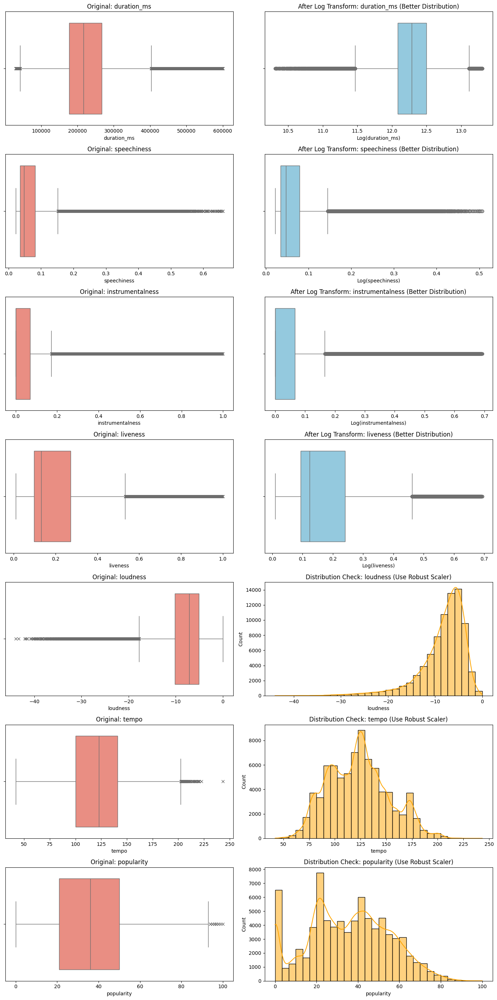

In [ ]:
# กำหนดคอลัมน์ที่จะตรวจสอบ
cols_to_log = ['duration_ms', 'speechiness', 'instrumentalness', 'liveness']
cols_others = ['loudness', 'tempo', 'popularity']

all_target_cols = cols_to_log + cols_others

# สร้าง DataFrame จำลองเพื่อดูผล Log Transform
df_check = df_final[all_target_cols].copy()

for col in cols_to_log:
    if col in df_check.columns:
        df_check[f'{col}_log'] = np.log1p(df_check[col])

# วาดกราฟเปรียบเทียบ
plt.figure(figsize=(14, 4 * len(all_target_cols)))

for i, col in enumerate(all_target_cols):
    # --- กราฟซ้าย: Original Data ---
    plt.subplot(len(all_target_cols), 2, 2*i + 1)
    sns.boxplot(x=df_final[col], color='salmon', flierprops={"marker": "x"})
    plt.title(f'Original: {col}')

    # --- กราฟขวา: Transformed Data ---
    plt.subplot(len(all_target_cols), 2, 2*i + 2)

    if col in cols_to_log:
        sns.boxplot(x=df_check[f'{col}_log'], color='skyblue')
        plt.title(f'After Log Transform: {col} (Better Distribution)')
        plt.xlabel(f'Log({col})')
    else:
        sns.histplot(x=df_final[col], bins=30, kde=True, color='orange')
        plt.title(f'Distribution Check: {col} (Use Robust Scaler)')
        plt.xlabel(col)

plt.tight_layout()
plt.show()

In [ ]:
# --- Expected schema (กำหนดเองตาม dataset ของคุณ) ---
expected_schema = {
    "popularity": "int64",
    "duration_ms": "float64",
    "explicit": "int64",
    "danceability": "float64",
    "energy": "float64",
    "key": "int64",
    "loudness": "float64",
    "mode": "int64",
    "speechiness": "float64",
    "acousticness": "float64",
    "instrumentalness_log": "float64",
    "liveness": "float64",
    "valence": "float64",
    "tempo": "float64",
    "time_signature": "int64",
    "track_genre_encoded": "int64",
    "is_hit": "int64"
}

# --- Check data types ---
print("Data Type Validation")
for col, dtype in expected_schema.items():
    if col in df_final.columns:
        if df_final[col].dtype != dtype:
            print(f"Column {col}: expected {dtype}, found {df_final[col].dtype}")
    else:
        print(f"Missing column: {col}")

# --- Check missing values ---
print("\nMissing Values")
print(df_final.isnull().sum())

# --- Check duplicates ---
print("\nDuplicates")
print(f"Total duplicate rows: {df_final.duplicated().sum()}")

# --- Consistency checks (ตัวอย่าง) ---
print("\nConsistency Checks")

# duration_ms ต้อง > 0
if (df_final['duration_ms'] <= 0).any():
    print("Found invalid duration_ms <= 0")

# explicit ต้องเป็น 0/1
if not df_final['explicit'].isin([0, 1]).all():
    print("Found invalid values in explicit")

# mode ต้องเป็น 0/1
if not df_final['mode'].isin([0, 1]).all():
    print("Found invalid values in mode")

# is_hit ต้องเป็น 0/1
if not df_final['is_hit'].isin([0, 1]).all():
    print("Found invalid values in mode")

# time_signature ควรเป็น [3, 4, 5] (แล้วแต่ dataset)
valid_time_signatures = [3, 4, 5]
if not df_final['time_signature'].isin(valid_time_signatures).all():
    print("Found unexpected values in time_signature")

# danceability, energy, speechiness, acousticness, instrumentalness, liveness, valence ควรอยู่ [0, 1]
bounded_cols = ["danceability", "energy", "speechiness", "acousticness", "instrumentalness", "liveness", "valence"]
for col in bounded_cols:
    if not df_final[col].between(0, 1).all():
        print(f"Found values outside [0,1] in {col}")

# ตรวจสอบว่า ยังมี podcast อยู่หรือไม่
podcast_remaining = df_final[df_final['speechiness'] > 0.66]

if podcast_remaining.empty:
    print("ไม่มี podcast เหลืออยู่แล้วใน dataset")
else:
    print(f"ยังเหลือ {len(podcast_remaining)} track ที่เป็น podcast")
    display(podcast_remaining.head())

Data Type Validation
Column duration_ms: expected float64, found int64
Missing column: instrumentalness_log
Missing column: track_genre_encoded

Missing Values
popularity             0
duration_ms            0
explicit               0
danceability           0
energy                 0
key                    0
loudness               0
mode                   0
speechiness            0
acousticness           0
instrumentalness       0
liveness               0
valence                0
tempo                  0
time_signature         0
track_genre            0
is_hit                 0
energy_loudness_mul    0
dance_valence_mul      0
dance_valence_avg      0
valence_tempo_mul      0
acoustic_speech_mul    0
acoustic_speech_sum    0
dtype: int64

Duplicates
Total duplicate rows: 0

Consistency Checks
ไม่มี podcast เหลืออยู่แล้วใน dataset


In [ ]:
print(X_train.describe().round(2))

       duration_ms  explicit  danceability    energy       key  loudness  \
count     71003.00  71003.00      71003.00  71003.00  71003.00  71003.00   
mean          0.66      0.08          0.55      0.64      5.28     -0.24   
std           0.12      0.27          0.18      0.25      3.56      0.97   
min           0.00      0.00          0.00      0.00      0.00     -7.24   
25%           0.59      0.00          0.43      0.46      2.00     -0.60   
50%           0.66      0.00          0.56      0.68      5.00      0.00   
75%           0.73      0.00          0.69      0.85      8.00      0.40   
max           1.00      1.00          1.00      1.00     11.00      1.40   

           mode  speechiness  acousticness  instrumentalness  ...   valence  \
count  71003.00     71003.00      71003.00          71003.00  ...  71003.00   
mean       0.63         0.11          0.32              0.18  ...      0.48   
std        0.48         0.14          0.34              0.33  ...      0.26   

In [ ]:
print("--- ดูค่าใน df_final (ต้นฉบับ ต้องเป็นค่าดิบ) ---")
print(df_final[['duration_ms', 'loudness']].head(3))

print("\n" + "="*50 + "\n")

print("--- ดูค่าใน X_train (ที่แปลงแล้ว ต้องเป็น 0-1 หรือค่าทศนิยมเล็กๆ) ---")
print(X_train[['duration_ms', 'loudness']].head(3))

--- ดูค่าใน df_final (ต้นฉบับ ต้องเป็นค่าดิบ) ---
   duration_ms  loudness
0       230666    -6.746
1       149610   -17.235
2       210826    -9.734


--- ดูค่าใน X_train (ที่แปลงแล้ว ต้องเป็น 0-1 หรือค่าทศนิยมเล็กๆ) ---
       duration_ms  loudness
73283     0.584000 -0.060779
4506      0.714813  0.440008
68383     0.663429 -1.017506


### **Descriptive Statistics**

In [ ]:
# --- 1. Central Tendency ---
central_tendency = pd.DataFrame({
    "Mean": df_train[new_numerical_features].mean(),
    "Median": df_train[new_numerical_features].median(),
    "Mode": df_train[new_numerical_features].mode().iloc[0]   # เอา mode แถวแรก
})

# --- 2. Measures of Dispersion ---
dispersion = pd.DataFrame({
    "Range": df_train[new_numerical_features].max() - df_train[new_numerical_features].min(),
    "Variance": df_train[new_numerical_features].var(),
    "Std Dev": df_train[new_numerical_features].std(),
    "IQR": df_train[new_numerical_features].quantile(0.75) - df_train[new_numerical_features].quantile(0.25)
})

# --- 3. Shape of Distribution ---
shape = pd.DataFrame({
    "Skewness": df_train[new_numerical_features].skew(),
    "Kurtosis": df_train[new_numerical_features].kurtosis()
})

# รวมผลลัพธ์
summary_stats = pd.concat([central_tendency, dispersion, shape], axis=1)

pd.set_option("display.max_rows", None)
display(summary_stats)

,Mean,Median,Mode,Range,Variance,Std Dev,IQR,Skewness,Kurtosis
duration_ms,0.658072,0.660439,0.597744,1.000000,0.014973,0.122363,0.137105,-0.601923,2.164234
danceability,0.550144,0.560724,0.559647,1.000000,0.033560,0.183195,0.255168,-0.319285,-0.274456
energy,0.637797,0.679994,0.960999,1.000000,0.064402,0.253776,0.392008,-0.562327,-0.610965
valence,0.477834,0.466332,0.965829,1.000000,0.068662,0.262034,0.431156,0.127632,-1.054342
acousticness,0.322597,0.181727,0.996988,1.000000,0.113219,0.336480,0.593173,0.692749,-0.994790
instrumentalness,0.176225,0.000085,0.000000,1.000000,0.108696,0.329691,0.097546,1.573979,0.706957
liveness,0.252590,0.166527,0.140441,1.000000,0.040069,0.200171,0.215344,1.748958,2.792283
speechiness,0.106507,0.051798,0.020676,1.000000,0.019241,0.138711,0.090951,2.538734,6.907475
tempo,0.002521,0.000000,-0.072945,4.917854,0.514286,0.717137,1.000000,0.285812,-0.390943
loudness,-0.235024,0.000000,0.248426,8.644768,0.938752,0.968892,1.000000,-1.842135,4.883309


####Central Tendency (ค่ากลางของข้อมูล)

* popularity  
Mean ≈ 33.3, Median = 35 → ค่ากลาง (median) สูงกว่า mean เล็กน้อย → distribution ออกไปทาง left-skewed เล็กน้อย (สอดคล้องกับ skewness ≈ 0.03 ~ เกือบสมมาตร)  
Mode = 0 → มีเพลงจำนวนมากที่ popularity เป็น 0 (outlier group)

* duration_ms_log  
Mean ≈ Median → distribution ใกล้ สมมาตร  
Mode สูงกว่า mean → มีบางเพลงที่ duration log ตรงจุด mode เยอะ

* danceability, energy, valence  
Mean ใกล้ median → distribution ค่อนข้าง สมมาตร  
Mode ของ valence สูงมาก (0.961) แสดงว่ามี peak ของเพลงที่ valence สูง (เพลงฟังดู “happy”)

* acousticness  
Mean (0.31) > Median (0.163) → ข้อมูลกระจายไปทางค่าเล็กเยอะ (right-skewed)
มีจำนวนมากที่ acousticness ต่ำ (เพลงไม่ acoustic)

* instrumentalness_log, liveness_log, speechiness_log  
Mean > Median และ skewness > 1 → ข้อมูลมี long right tail (มีบางเพลงที่ instrumental/liveness/speechiness สูงมากแต่เป็นส่วนน้อย)

* tempo  
Mean ≈ Median → distribution สมมาตร  
Mode 151.9 > Mean → อาจมี cluster เพลงเร็วเยอะ

* loudness  
Mean -8.13 < Median -6.96 → ข้อมูลมี tail ด้านลบ → distribution left-skewed

####Measures of Dispersion (การกระจายของข้อมูล)

* popularity: Range = 100 → มีเพลงทุกระดับตั้งแต่ 0-100, Std ≈ 22 → กระจายค่อนข้างกว้าง

* duration_ms_log: Std ≈ 0.35 → ค่อนข้างกระจายปานกลาง

* danceability, energy, valence: Std 0.17–0.26 → มีความหลากหลายปานกลางถึงสูง

* acousticness: Std ≈ 0.33 → กระจายสูง แสดงว่ามีทั้งเพลง acoustic และ non-acoustic

* instrumentalness_log, liveness_log, speechiness_log: Std ต่ำ (≈ 0.05–0.22) → ส่วนมากอยู่ใกล้ 0 แต่มีค่า outlier บางเพลงสูงมาก

* tempo: Std ≈ 29 → ความเร็วของเพลงมีความหลากหลายสูง

* loudness: Std ≈ 4.65 → กระจายกว้าง มีทั้งเพลงเบาและดัง

####Shape of Distribution (รูปร่างของข้อมูล)

* Skewness  
≈ 0 → ใกล้สมมาตร (popularity, duration, tempo)  
< 0 → left-skewed (popularity เล็กน้อย, energy, valence เล็กน้อย, loudness ชัดเจน)  
0 → right-skewed (acousticness, instrumentalness, liveness, speechiness) → มีเพลงส่วนน้อยที่มีค่าสูงมาก

* Kurtosis  
ใกล้ 0 → รูปร่างใกล้ normal distribution (popularity, instrumentalness_log)  
< 0 → platykurtic (flat) เช่น energy, valence → กระจายค่อนข้างกว้าง  
0 → leptokurtic (peaked + heavy tails) เช่น liveness_log, speechiness_log → มี peak สูงและ tail ยาว

####สรุป
* ค่ากลาง: ส่วนใหญ่ mean ≈ median → distribution เกือบสมมาตร ยกเว้น acousticness และ features ที่เป็น log (instrumentalness, liveness, speechiness) ที่เบ้ขวา (right-skewed)

* การกระจาย: popularity, tempo, loudness มีความกระจายสูง แสดงถึงความหลากหลายของเพลง ส่วน speechiness/instrumentalness กระจายแคบแต่มี outlier

* รูปร่างข้อมูล: ส่วนมากมี distribution ใกล้ normal ยกเว้น speechiness/liveness ที่มี peak สูงและ tail ยาว

* Insight:
Dataset มีเพลงที่หลากหลายทั้งช้า-เร็ว เบา-ดัง acoustic/non-acoustic
ความนิยม (popularity) กระจายกว้างและค่อนข้างสมมาตร → เหมาะสำหรับใช้ในการสร้าง model ทำนาย

###**Univariate Analysis**

การวิเคราะห์ทีละตัวแปร (single variable)

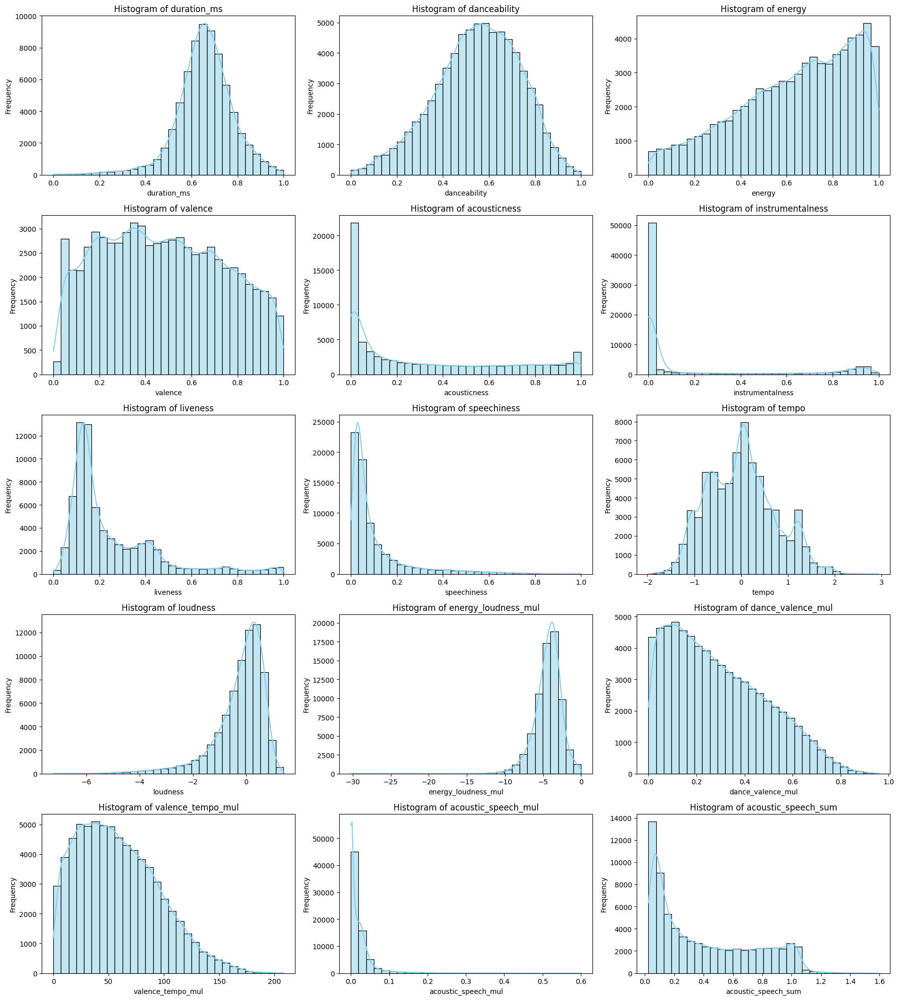

/tmp/ipython-input-3880980075.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_table, x="count", y="genre_encoded", palette="viridis")


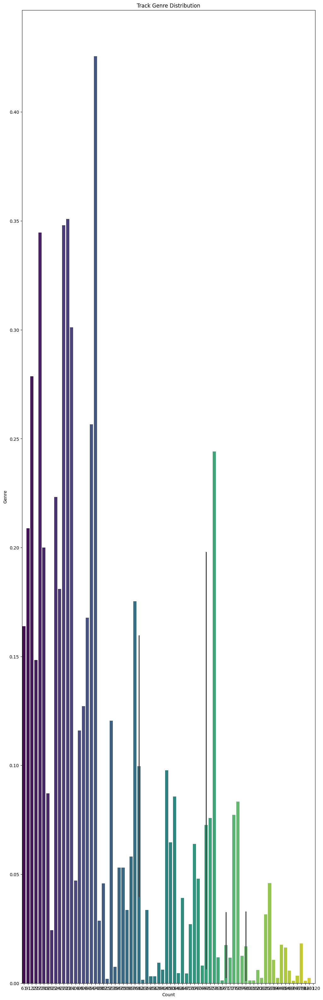

/tmp/ipython-input-3880980075.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=freq_table, x="count", y="genre_encoded", palette="viridis")


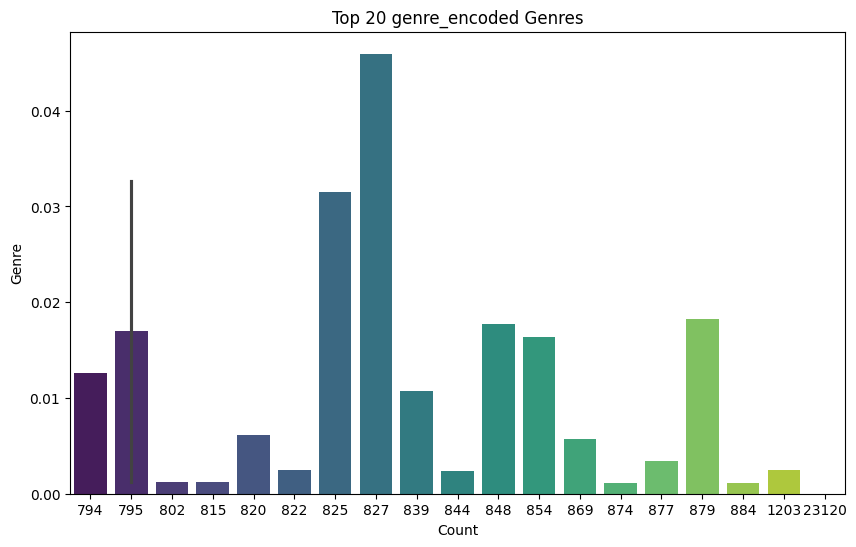


Frequency Table for explicit:

   explicit  count
0         0  65387
1         1   5616

Frequency Table for key:

    key  count
0     7   8520
1     0   8244
2     2   7554
3     9   7274
4     1   6591
5     4   5791
6     5   5726
7    11   5633
8     6   4717
9    10   4559
10    8   4284
11    3   2110

Frequency Table for mode:

   mode  count
0     1  44984
1     0  26019

Frequency Table for time_signature:

   time_signature  count
0               4  64259
1               3   5630
2               5   1114

Frequency Table for is_hit:

   is_hit  count
0       0  68343
1       1   2660

Frequency Table for genre_encoded:

    genre_encoded  count
0        0.000000  23120
1        0.002494   1203
2        0.001131    884
3        0.018203    879
4        0.003421    877
5        0.001144    874
6        0.005754    869
7        0.016393    854
8        0.017689    848
9        0.002370    844
10       0.010727    839
11       0.045949    827
12       0.031515    825
13       0

In [ ]:
# --- Univariate Analysis สำหรับ numerical --- #
num_cols = len(new_numerical_features)
n_cols = 3  # จำนวนกราฟต่อแถว
n_rows = math.ceil(num_cols / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*6, n_rows*4))
axes = axes.flatten()  # flatten ให้เป็น 1D array จะได้เข้าถึงง่าย

for i, col in enumerate(new_numerical_features):
    sns.histplot(df_train[col], bins=30, kde=True, color="skyblue", ax=axes[i])
    axes[i].set_title(f"Histogram of {col}")
    axes[i].set_xlabel(col)
    axes[i].set_ylabel("Frequency")

# ถ้ามีช่องว่าง (เพราะจำนวน feature ไม่พอดี 3) ให้ปิดกราฟเปล่า
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

# --- Univariate Analysis สำหรับ categorical ---
freq_table = df_train['genre_encoded'].value_counts().reset_index()
freq_table.columns = ["genre_encoded", "count"]

plt.figure(figsize=(12,40))  # สูงพอสำหรับ 114 แถว
sns.barplot(data=freq_table, x="count", y="genre_encoded", palette="viridis")
plt.title("Track Genre Distribution")
plt.xlabel("Count")
plt.ylabel("Genre")
plt.show()

top_n = 20
freq_table = df_train['genre_encoded'].value_counts().head(top_n).reset_index()
freq_table.columns = ["genre_encoded", "count"]

plt.figure(figsize=(10,6))
sns.barplot(data=freq_table, x="count", y="genre_encoded", palette="viridis")
plt.title(f"Top {top_n} genre_encoded Genres")
plt.xlabel("Count")
plt.ylabel("Genre")
plt.show()

for col in new_categorical_features:
    freq_table = df_train[col].value_counts().reset_index()
    freq_table.columns = [col, "count"]

    print(f"\nFrequency Table for {col}:\n")
    print(freq_table)

###**Bivariate Analysis**

numerical vs numerical

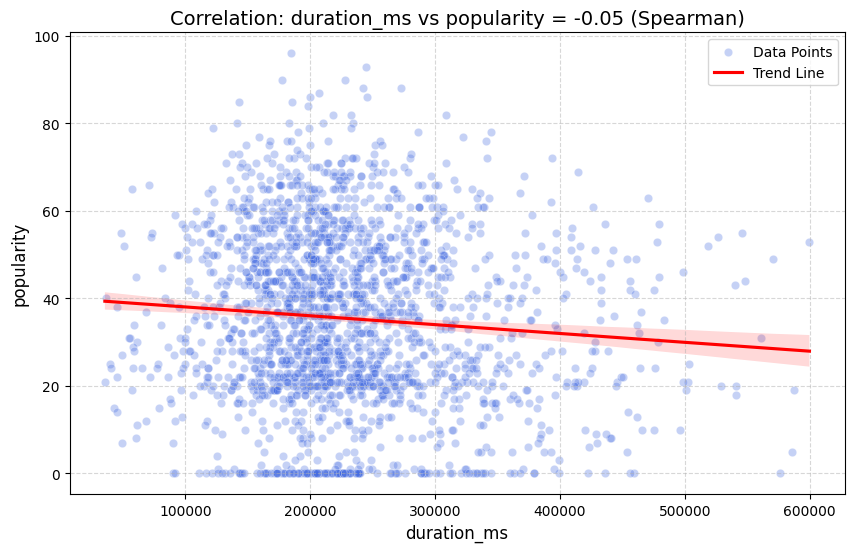

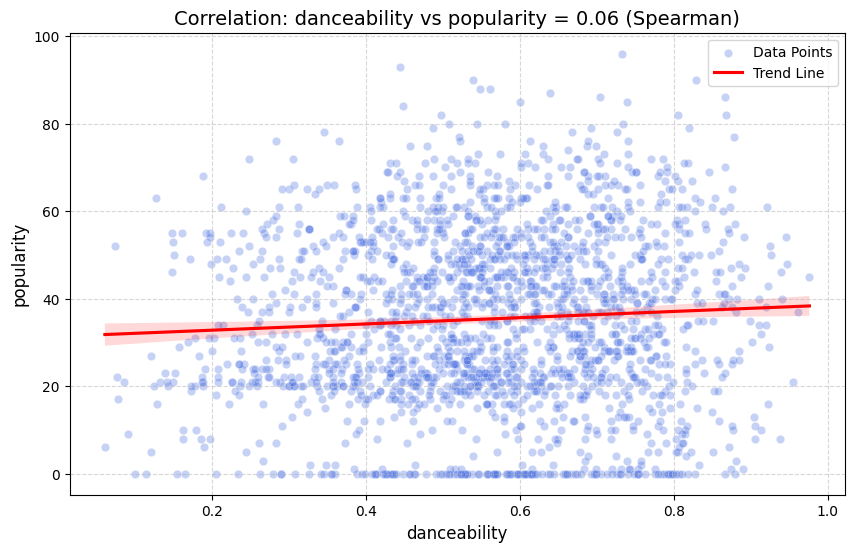

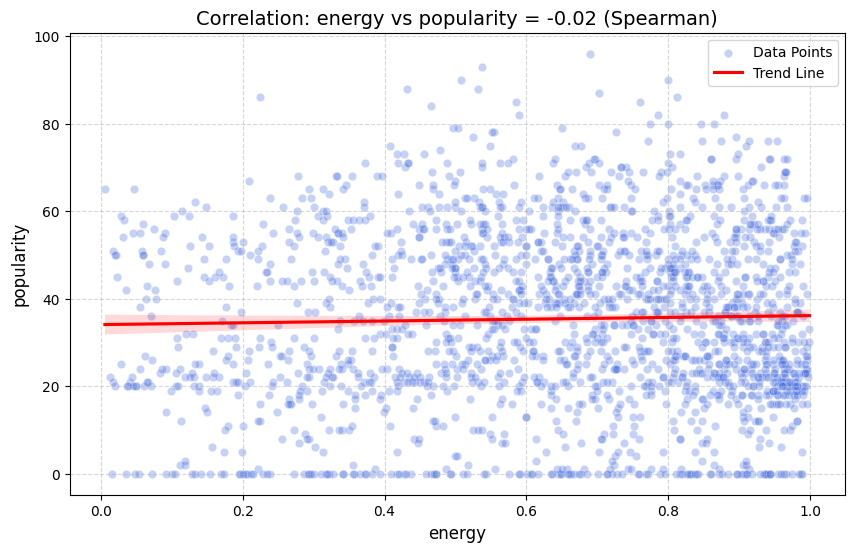

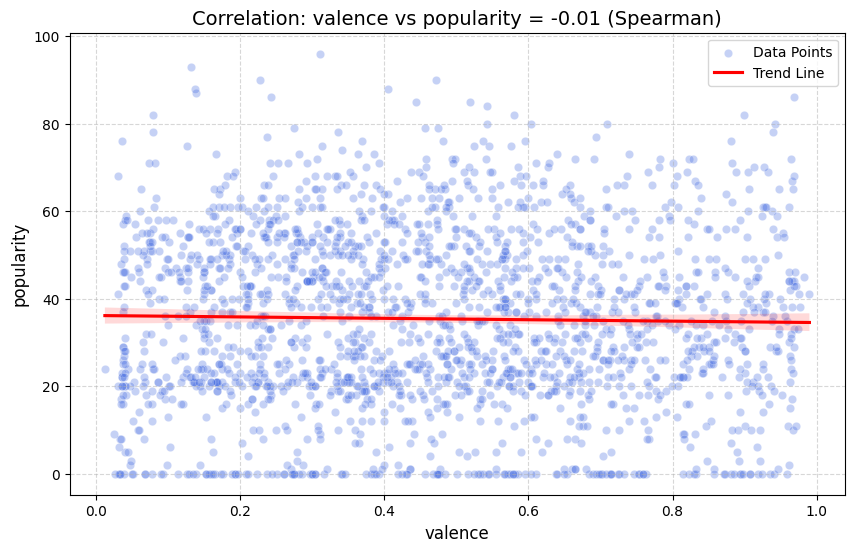

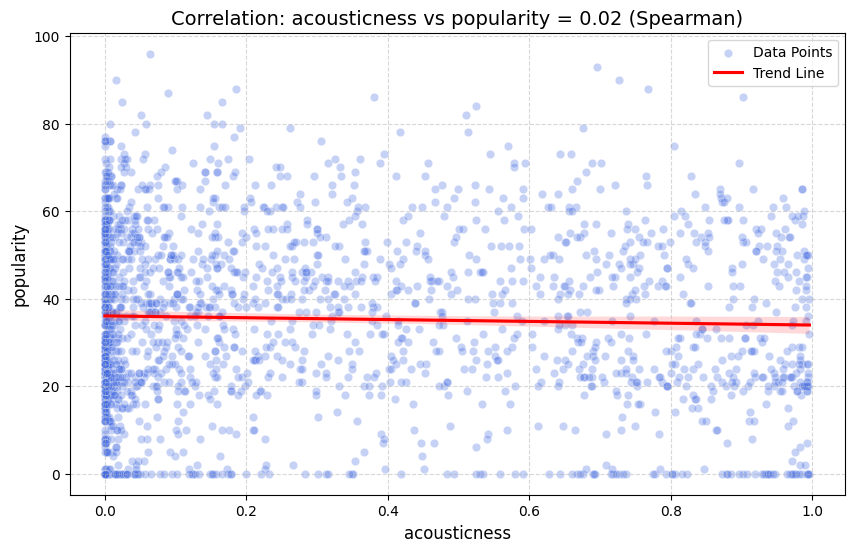

...

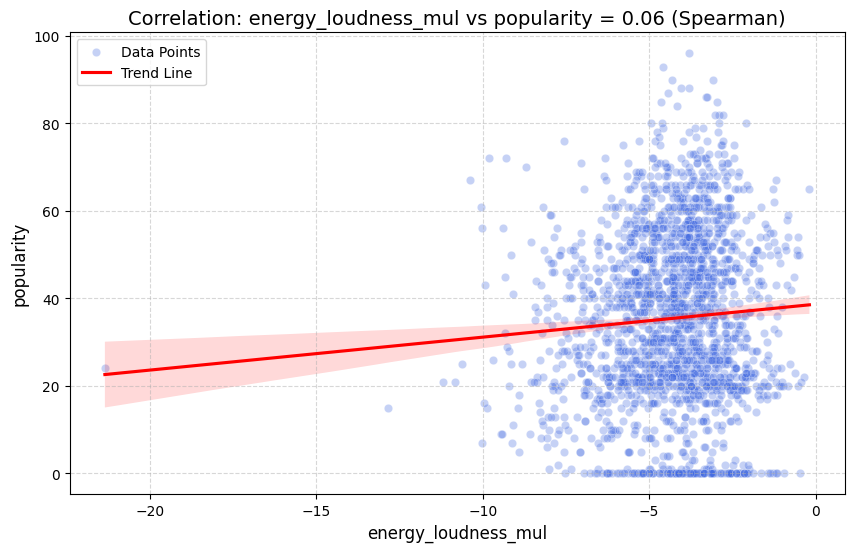

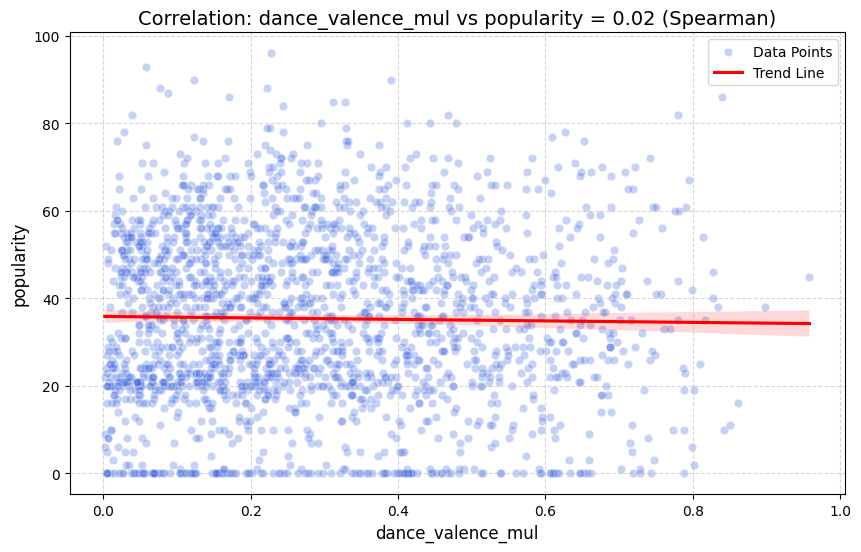

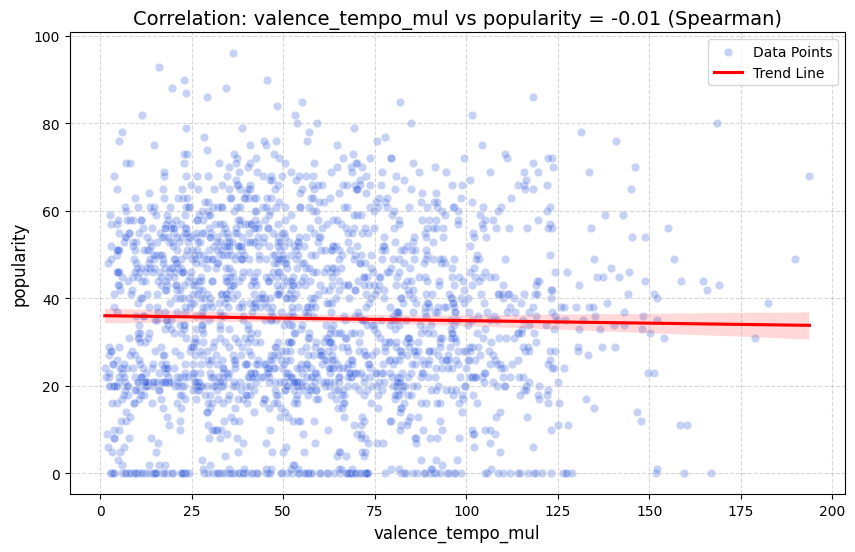

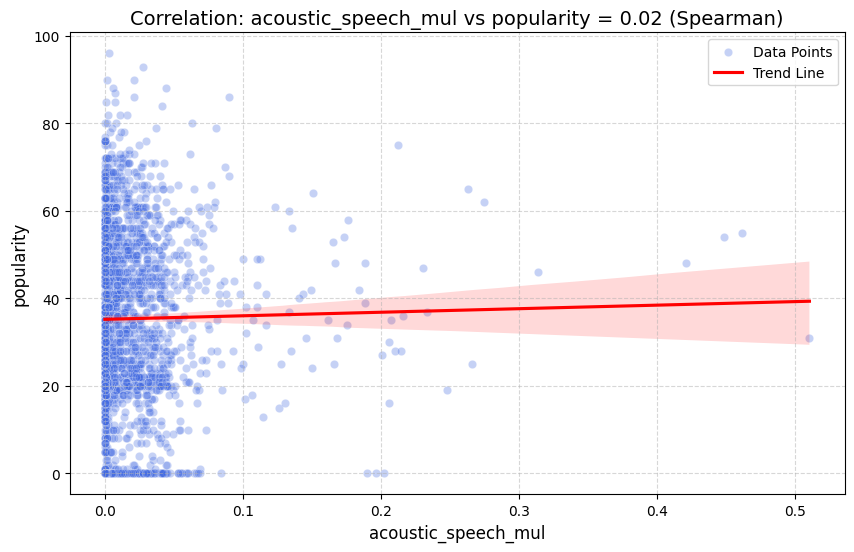

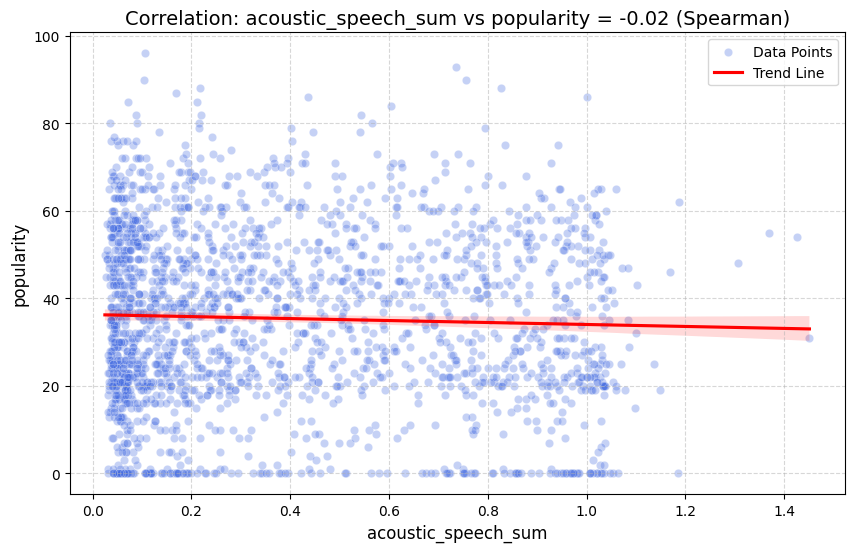

In [ ]:
def bivariate_analysis(df, feature_col, target_col="popularity"):
    # 1. คำนวณ Correlation (ใช้ข้อมูลทั้งหมดคำนวณ เพื่อความแม่นยำ)
    corr = df[feature_col].corr(df[target_col], method="spearman")

    # 2. เตรียมข้อมูลสำหรับพลอต (สุ่มมาแค่ 2000 จุด เพื่อกันกราฟรก/ช้า)
    if len(df) > 2000:
        plot_data = df.sample(n=2000, random_state=42)
    else:
        plot_data = df

    plt.figure(figsize=(10, 6))

    # 3. Plot Scatter (Feature อยู่แกน X, Target อยู่แกน Y)
    sns.scatterplot(data=plot_data, x=feature_col, y=target_col, alpha=0.3, color='royalblue', label='Data Points')

    # 4. เพิ่มเส้นแนวโน้ม (Regplot) สีแดง เพื่อดูทิศทาง
    sns.regplot(data=plot_data, x=feature_col, y=target_col, scatter=False, color='red', label='Trend Line')

    plt.title(f"Correlation: {feature_col} vs {target_col} = {corr:.2f} (Spearman)", fontsize=14)
    plt.xlabel(feature_col, fontsize=12)
    plt.ylabel(target_col, fontsize=12)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.legend()
    plt.show()

# Loop แสดงผล
for col in new_numerical_features:
    # ข้าม popularity และข้าม is_hit (เพราะ is_hit เป็น category 0/1 ไม่ควรใช้ scatter)
    if col not in ["popularity", "is_hit"]:
        bivariate_analysis(df_final, col, "popularity")

แสดงว่า feature ที่เป็น numerical จาก dataset นี้แต่ละตัวเดี่ยวๆ แทบไม่มีผลต่อ popularity เลย

Numerical vs Categorical

popularity vs categorical_features

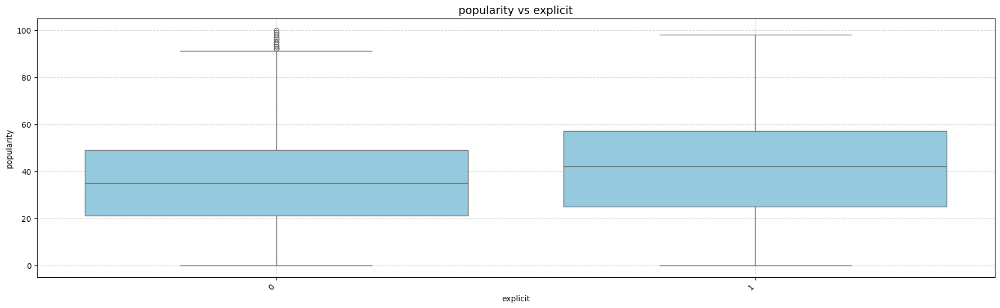

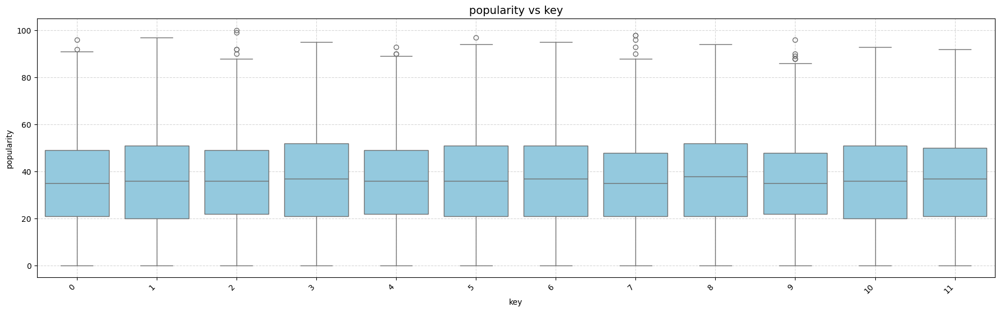

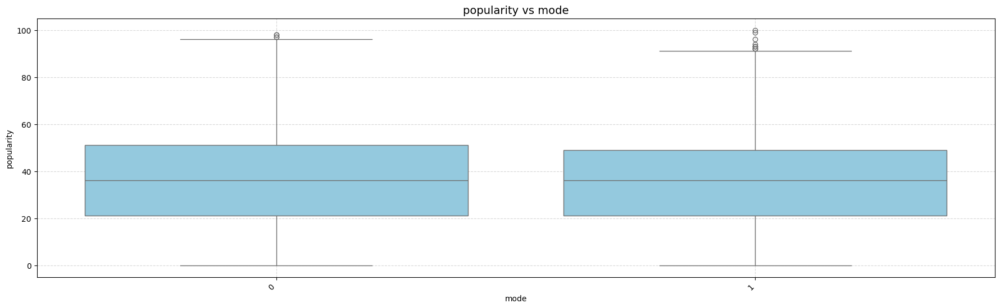

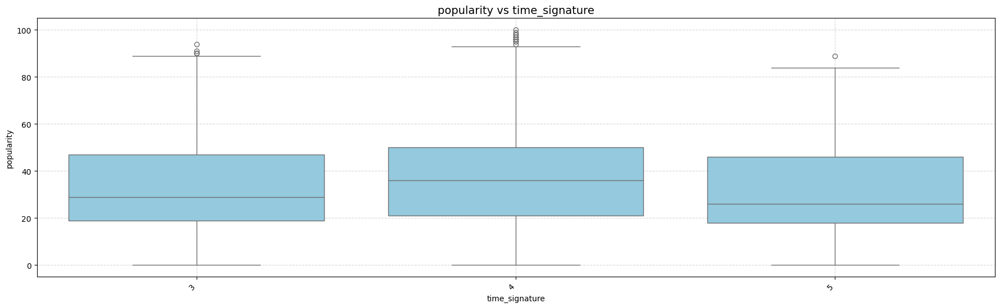

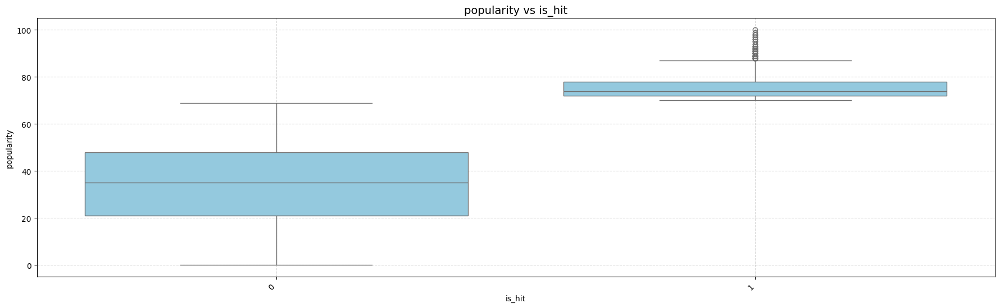

In [ ]:
def bivariate_analysis_cat(df, col_num, col_cat):
    plt.figure(figsize=(22, 6))
    #sns.violinplot(x=col_cat, y=col_num, data=df, inner="box", scale="width")
    sns.boxplot(x=col_cat, y=col_num, data=df, color="skyblue", linewidth=1)
    plt.title(f"{col_num} vs {col_cat}", fontsize=14)
    plt.xticks(rotation=45, ha="right")  # หมุน label กันชนกัน
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.show()

# Loop ทุก categorical feature
for col in new_categorical_features:
    bivariate_analysis_cat(df_final, "popularity", col)

is_hit vs numerical_features

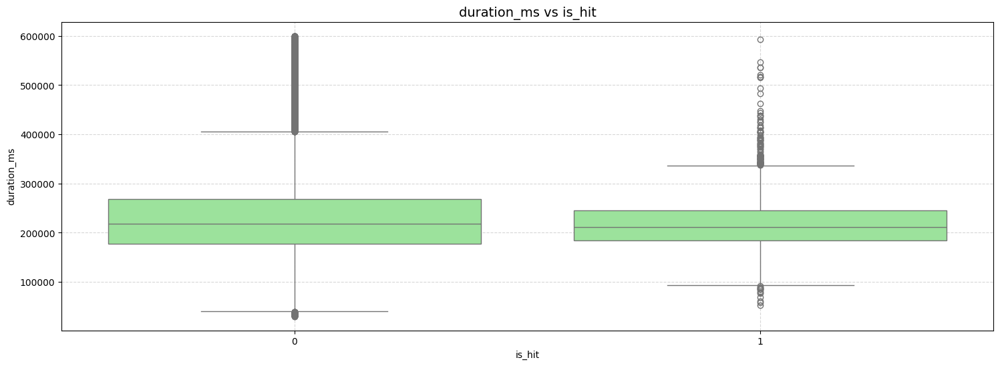

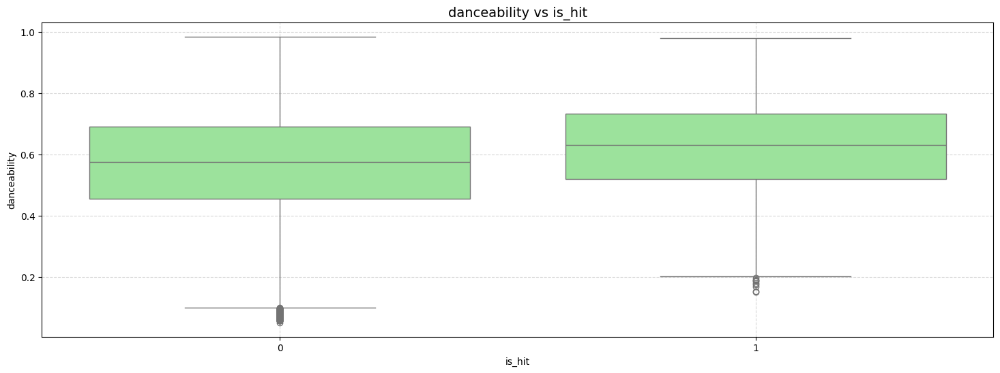

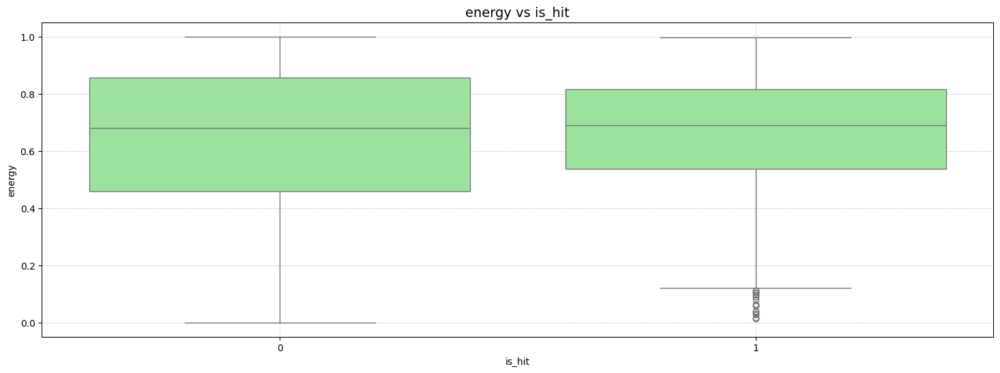

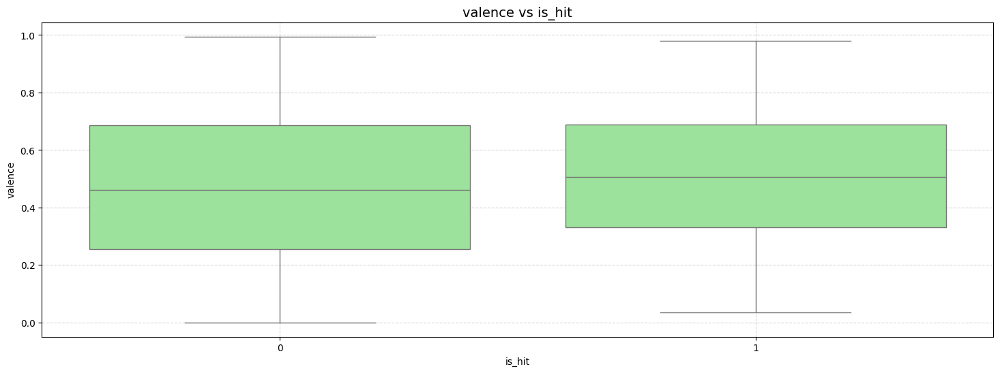

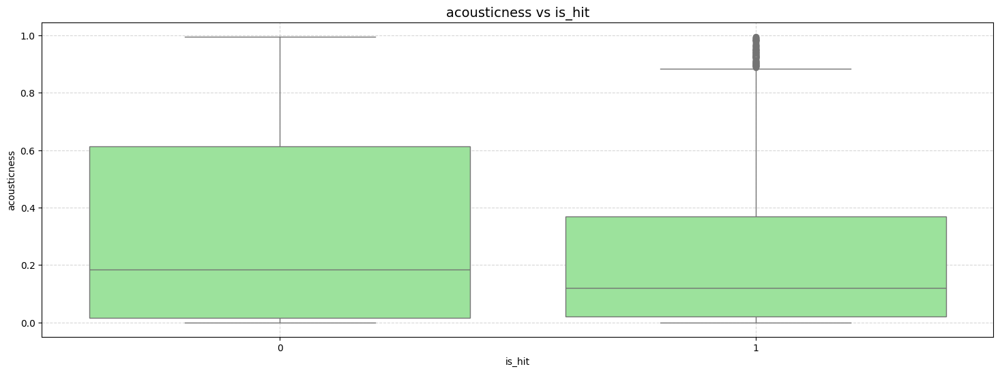

...

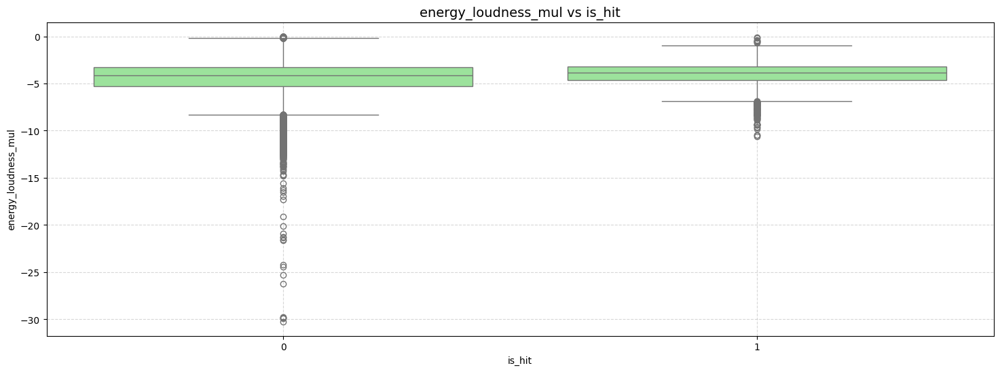

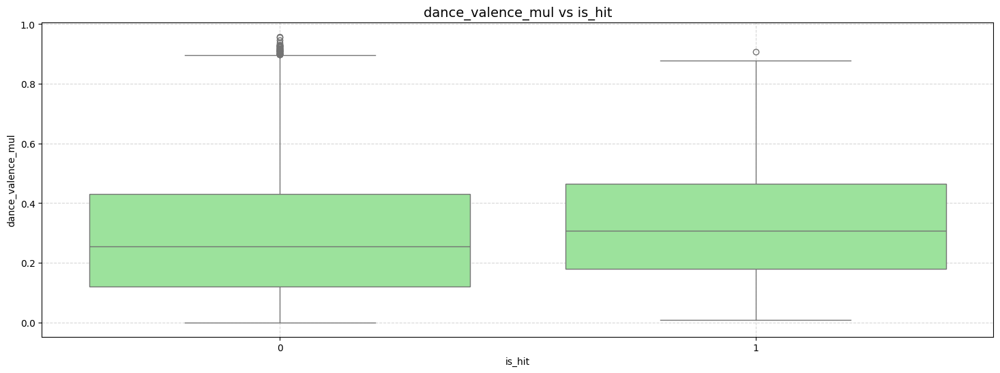

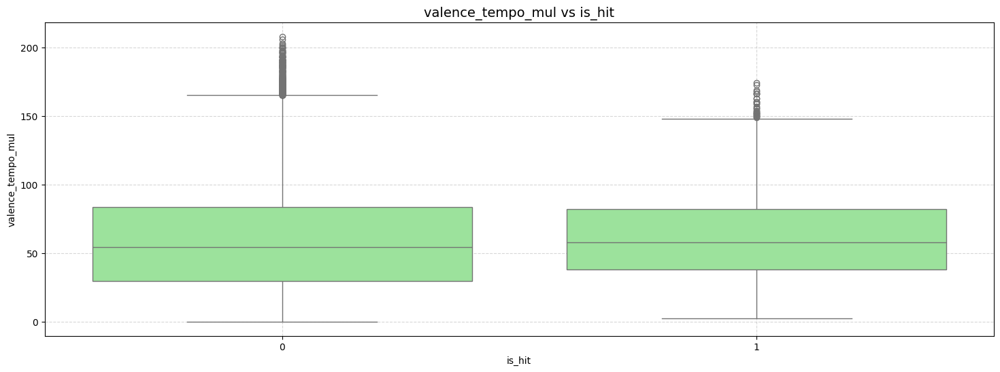

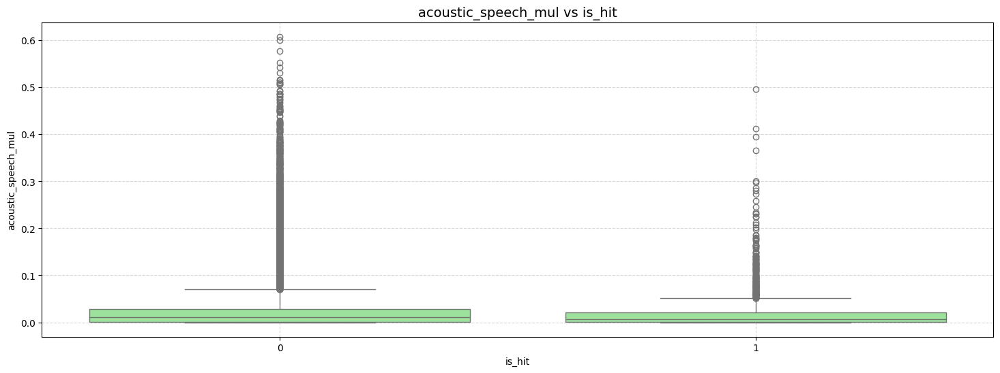

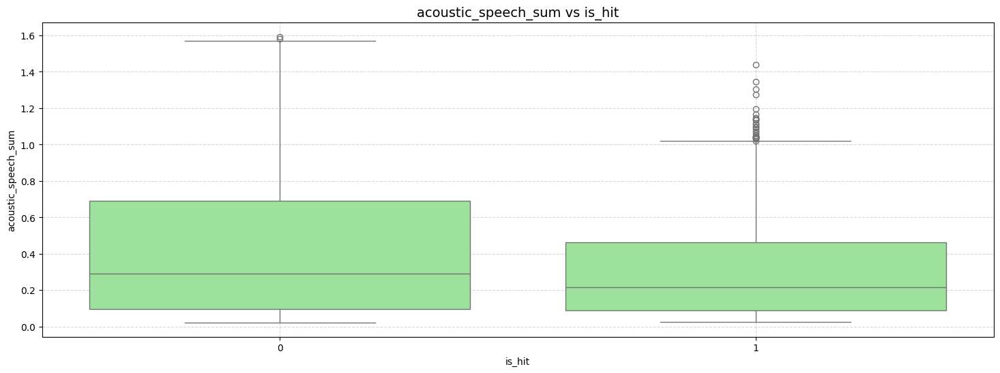

In [ ]:
def bivariate_analysis_num_vs_hit(df, col_num, col_cat="is_hit"):
    plt.figure(figsize=(18, 6))
    sns.boxplot(x=col_cat, y=col_num, data=df, color="lightgreen", linewidth=1)
    plt.title(f"{col_num} vs {col_cat}", fontsize=14)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.show()

# Loop ทุก numerical feature (ยกเว้น popularity ถ้าไม่อยากซ้ำ)
for col in new_numerical_features:
    if col != "popularity":  # ตัด popularity ออกถ้าไม่ต้องการ
        bivariate_analysis_num_vs_hit(df_final, col)

1. duration_ms_log
* ความยาวเพลงโดยรวมใกล้เคียงกันระหว่าง hit และ non-hit ไม่มีความแตกต่างเด่นชัดมาก

2. danceability
* เพลงที่เป็น hit มีค่า danceability สูงกว่าเล็กน้อย
* แสดงว่าเพลงที่ "เต้นได้" มีโอกาสเป็น hit มากกว่า

3. energy
* ค่า energy ของเพลง hit และ non-hit ใกล้เคียงกัน
* เพลง hit มักมี energy ค่อนข้างสูง แต่ไม่ต่างกันชัดเจน

4. valence (ความสดใส/บวกของเพลง)
* ทั้งสองกลุ่มกระจายใกล้กัน แต่ median ของ hit สูงกว่าเล็กน้อย → เพลง hit มีโทนบวก/สดใสกว่าเล็กน้อย

5. acousticness
* เพลงที่เป็น hit มีค่า acousticness ต่ำกว่า non-hit อย่างชัดเจน แปลว่าเพลง hit มักไม่ค่อย acoustic (แต่มีการใช้ดนตรีอิเล็กทรอนิกส์มากกว่า)

6. instrumentalness_log
* ทั้งสองกลุ่มมีค่าใกล้ศูนย์ แต่ non-hit มีค่ากระจายมากกว่า
* เพลง hit มักมี vocal (ไม่ใช่ instrumental ล้วน)

7. liveness_log
* ทั้งสองใกล้กันมาก แต่ non-hit มีค่ากระจายสูงกว่า
* เพลง hit มักไม่ใช่ live performance

8. speechiness_log
* กระจายคล้ายกัน แต่ hit มี outliers สูงกว่า หมายถึงเพลง hit อาจมีบางส่วนที่มี spoken words/rap ผสมบ้าง

9. tempo
* ค่า tempo ของทั้งสองกลุ่มใกล้เคียงกัน ไม่ใช่ปัจจัยหลักในการแยก hit vs non-hit

10. loudness
* เพลง hit มี loudness สูงกว่า (เสียงดัง/ชัดกว่า) อย่างชัดเจน ถือว่าเป็น feature ที่น่าจะมีผลต่อความเป็น hit มากที่สุด

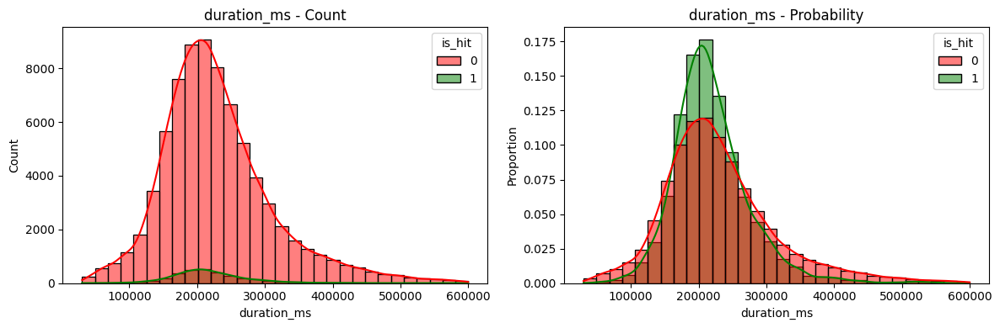

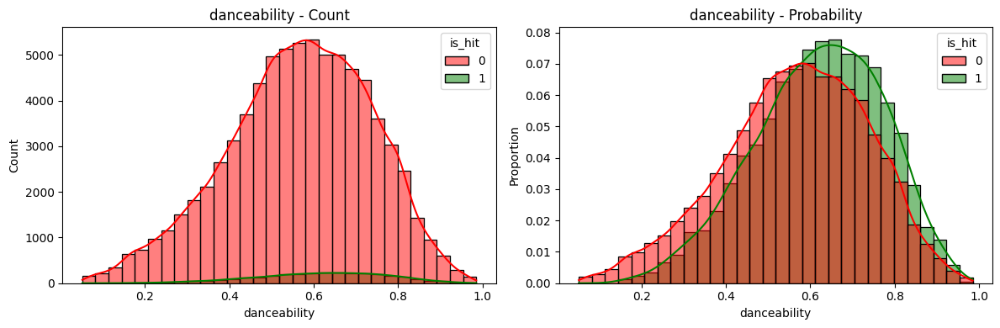

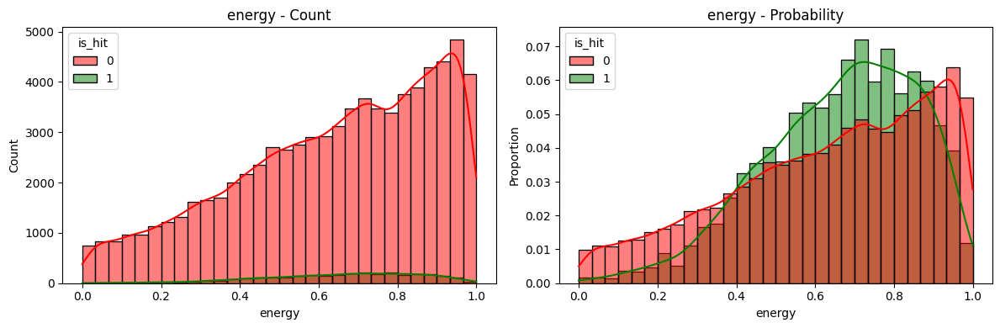

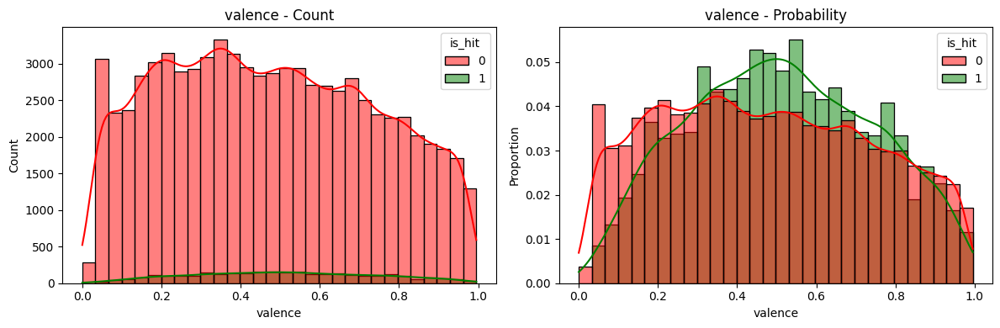

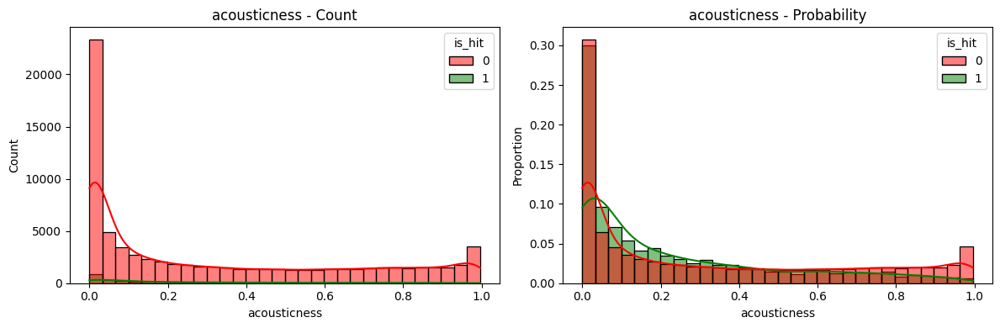

...

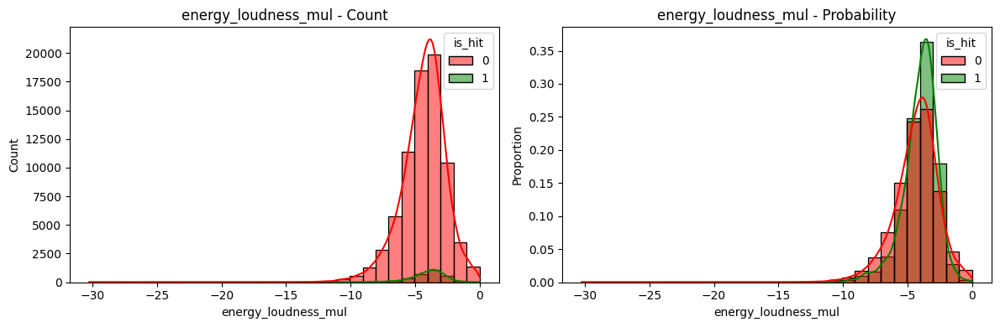

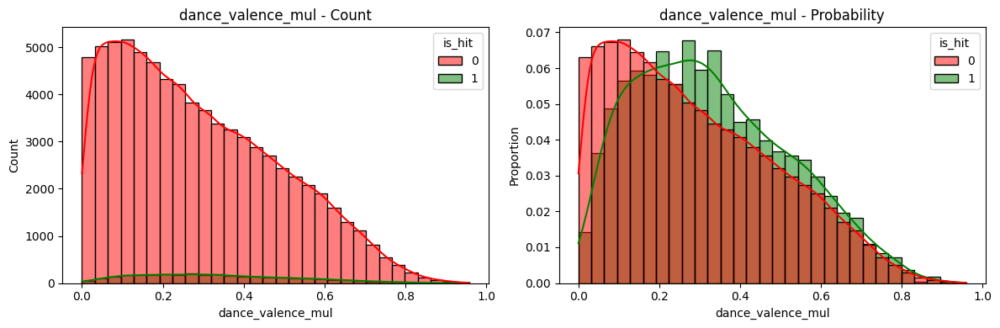

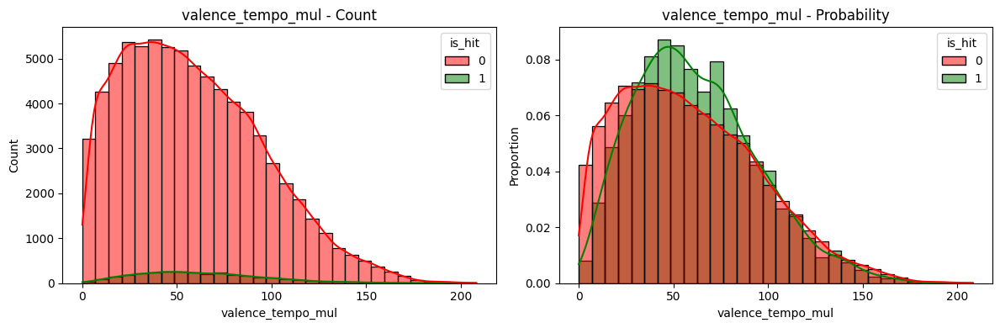

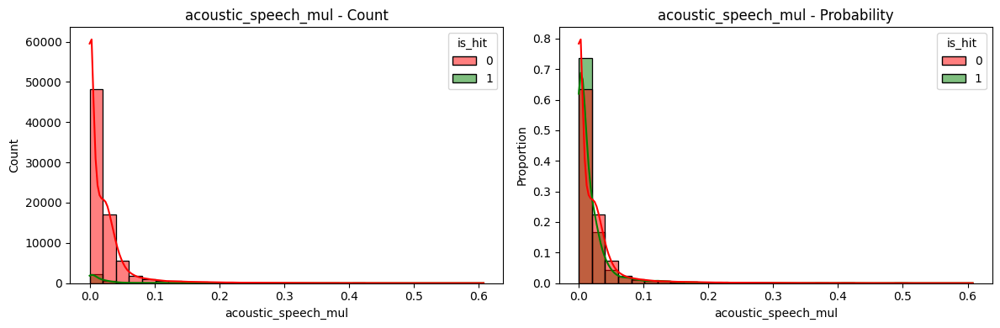

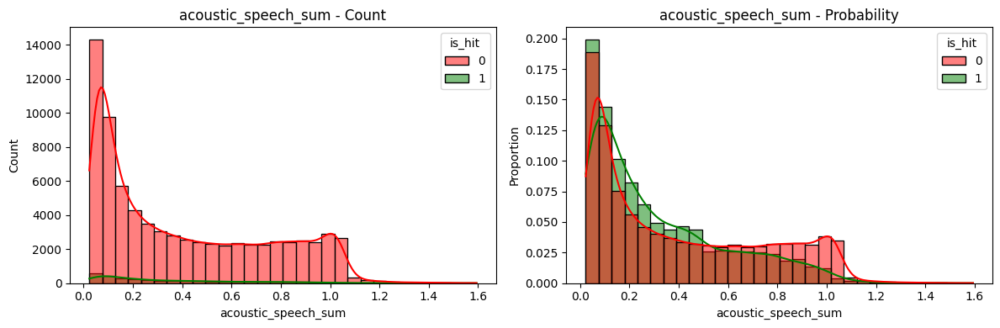

In [ ]:
for col in new_numerical_features:
    fig, axes = plt.subplots(1, 2, figsize=(12, 4), sharex=True)

    # --- Left: Count ---
    sns.histplot(data=df_final, x=col, hue="is_hit", bins=30, kde=True,
                 palette={0: "red", 1: "green"}, alpha=0.5, ax=axes[0])
    axes[0].set_title(f"{col} - Count")
    axes[0].set_xlabel(col)
    axes[0].set_ylabel("Count")

    # --- Right: Probability ---
    sns.histplot(data=df_final, x=col, hue="is_hit", bins=30, stat="probability",
                 common_norm=False, kde=True,
                 palette={0: "red", 1: "green"}, alpha=0.5, ax=axes[1])
    axes[1].set_title(f"{col} - Probability")
    axes[1].set_xlabel(col)
    axes[1].set_ylabel("Proportion")

    plt.tight_layout()
    plt.show()

1. Popularity
*เพลงที่เป็น hit (is_hit=1) จะกระจุกตัวอยู่ในช่วง Popularity สูง (70–90) อย่างชัดเจน
เพลงทั่วไป (is_hit=0) กระจายกว้าง แต่ส่วนใหญ่ popularity < 40 -> บอกได้ว่า Popularity เป็นตัวแปรที่มีความสัมพันธ์สูงและใช้แยก hit/non-hit ได้ดี

2. Duration (ความยาวเพลง)
* Distribution ของ hit และ non-hit ไม่ต่างกันมาก
* ทั้งสองกลุ่มมีช่วงเวลาอยู่ระหว่าง 11.5–12.5 (log scale) -> Duration ไม่ใช่ตัวแปรหลักในการทำนายความเป็น hit

3. Danceability
* เพลง hit จะมีค่า danceability สูงกว่า (กระจุกที่ 0.6–0.8)
* เพลง non-hit กระจายกว้างกว่า และมีสัดส่วนเยอะในช่วงต่ำกว่า 0.5 -> เพลงที่มี danceability มีโอกาสเป็น hit สูงกว่า

4. Energy
* เพลง hit กระจายอยู่ช่วง 0.6–0.9 ค่อนข้างมาก
* เพลง non-hit แม้จะมีกระจายคล้ายกัน แต่มีเยอะในช่วง energy ต่ำด้วย -> เพลงที่ energetic มาก มีโอกาสเป็น hit มากกว่า

5. Valence (อารมณ์บวก/ลบ)
* Distribution ของ hit กับ non-hit ค่อนข้าง overlap กัน
* เพลง hit มีค่าเฉลี่ยกลาง ๆ (0.4–0.6) แต่ไม่ได้ต่างกันชัดเจน -> Valence มีผล แต่ไม่ใช่ตัวแปรหลักที่ชัด

6. Acousticness
* เพลง hit มักมีค่า acousticness ต่ำ (ไม่ acoustic มาก)
* non-hit พบได้มากในเพลงที่ acoustic สูง ๆ (>0.5) -> เพลง acoustic สูงมีโอกาสไม่ดังมากกว่า

7. Instrumentalness
* ส่วนใหญ่ทั้ง hit และ non-hit มีค่าต่ำ (เพลงมีเนื้อร้อง)
* เพลง instrumental สูง ๆ (ไม่มีเนื้อร้อง) มักไม่เป็น hit -> Instrumentalness สูงสัมพันธ์กับ non-hit

8. Liveness
* Distribution คล้ายกันระหว่าง hit และ non-hit
* เพลง live (ค่า liveness สูง) ไม่ได้เป็นตัวแยกชัด -> Liveness ไม่มีผลมาก

9. Speechiness
* เพลงที่ hit ส่วนใหญ่ speechiness ต่ำ (ไม่ได้เป็น spoken word/rap จ๋า)
* non-hit มีการกระจายกว้างกว่า -> เพลงที่ speechiness สูง ๆ ไม่ค่อยเป็น hit

10. Tempo
* Distribution ของ tempo ของ hit และ non-hit overlap กันมาก
* แต่เพลง hit มีแนวโน้มกระจุกในช่วง 100–130 BPM -> Tempo มีผลเล็กน้อย แต่ไม่ชัดเจน

11. Loudness
* เพลง hit มีค่า loudness สูงกว่า (เสียงดัง, production หนา)
* non-hit มักกระจายไปในช่วงเสียงเบากว่า -> Loudness เป็นอีกปัจจัยสำคัญที่แยก hit/non-hit ได้

categerical vs categerical


Cross Tab: explicit vs is_hit


is_hit,0,1
explicit,,
0,0.966569,0.033431
1,0.915722,0.084278


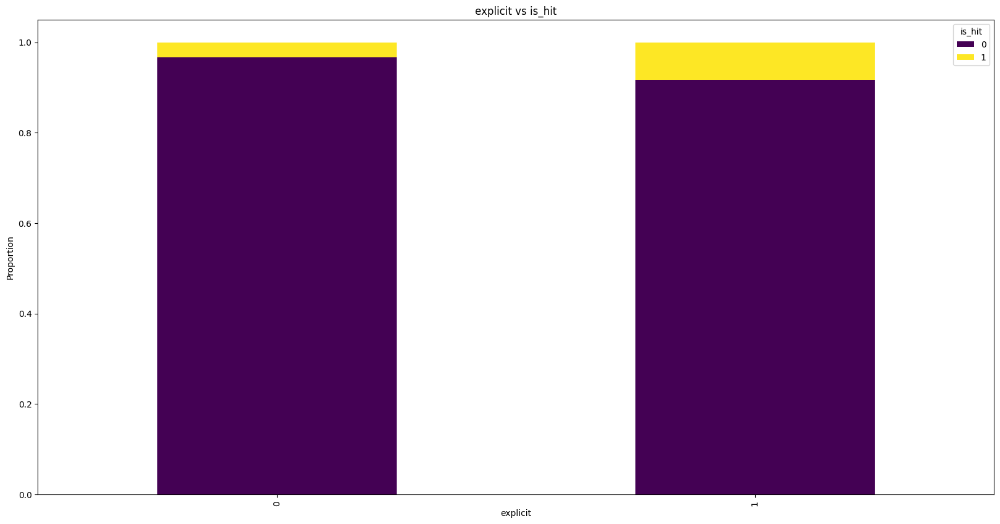


Cross Tab: key vs is_hit


is_hit,0,1
key,,
0,0.965953,0.034047
1,0.954670,0.045330
2,0.967626,0.032374
3,0.955908,0.044092
4,0.963084,0.036916
5,0.962840,0.037160
6,0.954243,0.045757
7,0.972331,0.027669
8,0.950470,0.049530


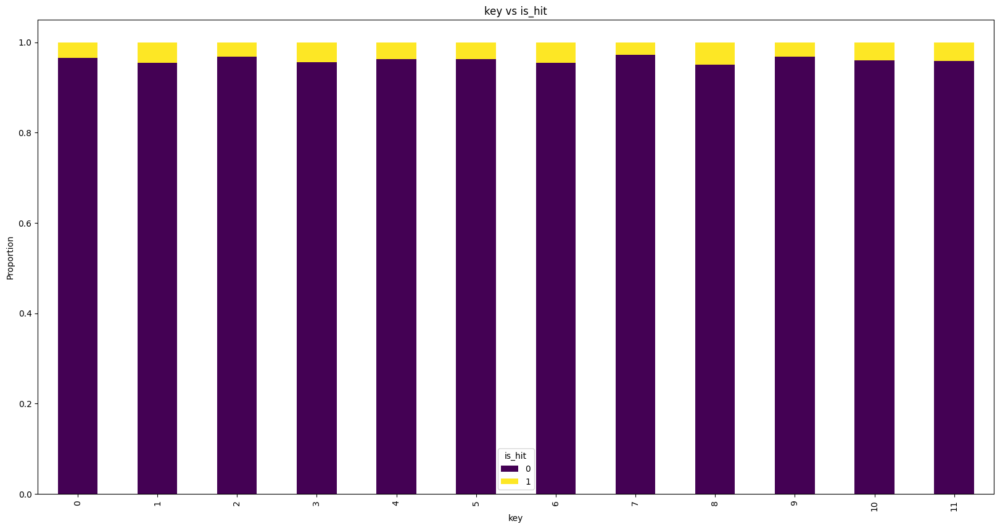


Cross Tab: mode vs is_hit


is_hit,0,1
mode,,
0,0.960264,0.039736
1,0.963841,0.036159


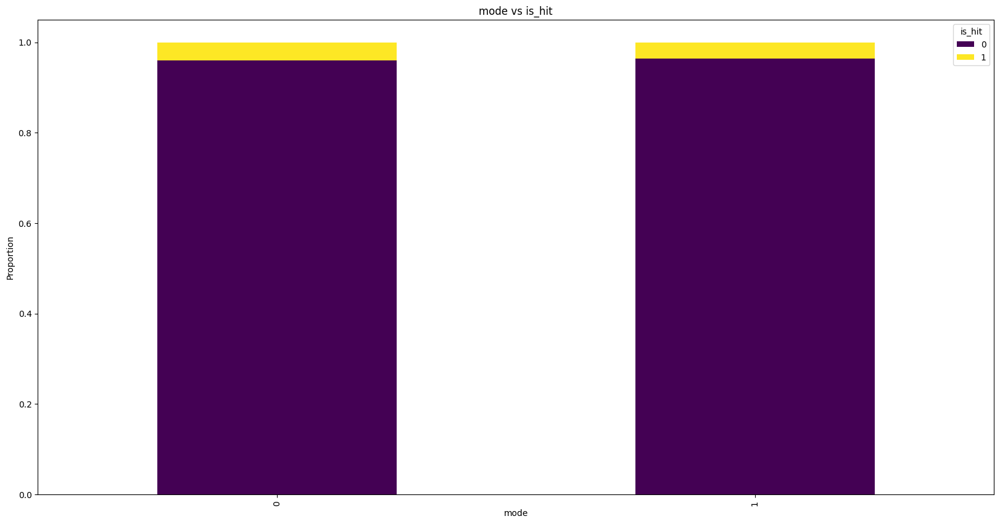


Cross Tab: time_signature vs is_hit


is_hit,0,1
time_signature,,
3,0.974330,0.025670
4,0.961161,0.038839
5,0.982215,0.017785


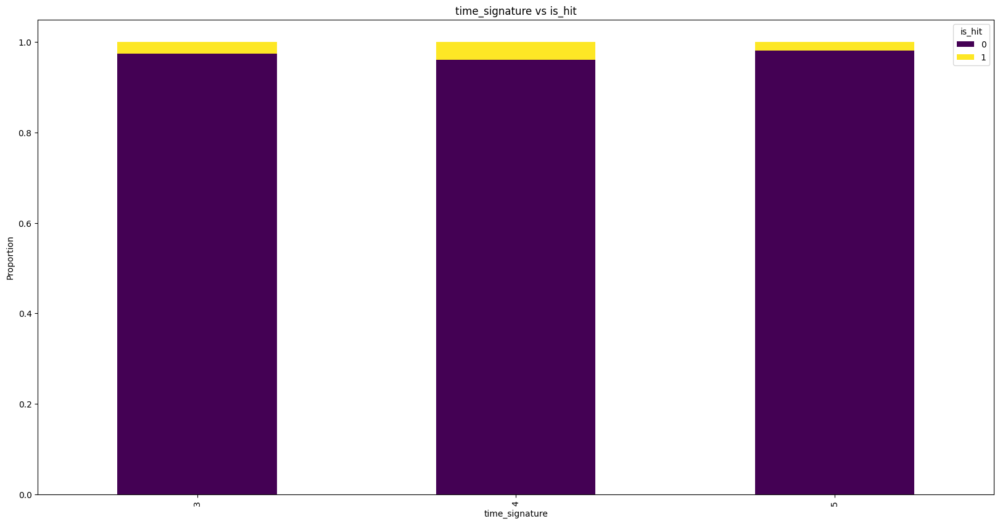

In [ ]:
# --- Define function for crosstab + stacked bar ---
def plot_crosstab(cat_var, target="is_hit"):
    ct = pd.crosstab(df_final[cat_var], df_final[target], normalize="index")
    print(f"\nCross Tab: {cat_var} vs {target}")
    display(ct)  # แสดงตาราง cross tab

    # วาด stacked bar
    ct.plot(kind="bar", stacked=True, figsize=(20,10), colormap="viridis")
    plt.title(f"{cat_var} vs {target}")
    plt.ylabel("Proportion")
    plt.xlabel(cat_var)
    plt.legend(title=target)
    plt.show()

for cat in new_categorical_features:
  if cat != 'is_hit':
    plot_crosstab(cat)

* เกือบทุก genre ส่วนใหญ่เป็นเพลงไม่ฮิต (0)

* เพลง hit มีสัดส่วนค่อนข้างน้อยในทุก genre บาง genre มีสัดส่วนเพลง hit มากกว่าค่าเฉลี่ย

* บาง genre มีโอกาส hit(1) มากกว่า genre อื่น ๆ หมายความว่า genre อาจมีผลต่อความน่าจะเป็นที่จะเป็น hit

###**Multivariate Analysis**

correlation matrix + heatmap

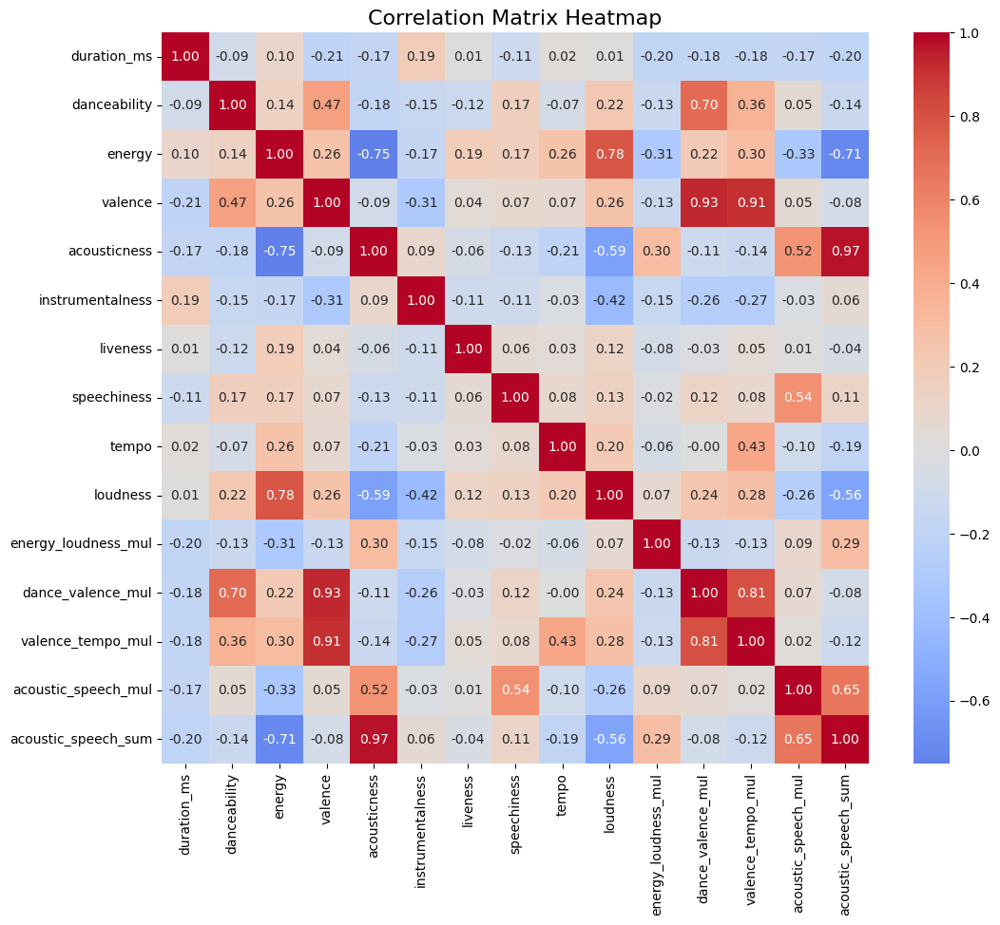

In [ ]:
plt.figure(figsize=(12,10))
corr = df_final[new_numerical_features].corr()  # คำนวณเฉพาะตัวเลข
sns.heatmap(corr, cmap="coolwarm", center=0, annot=True, fmt=".2f")
plt.title("Correlation Matrix Heatmap", fontsize=16)
plt.show()

1. Energy ↔ Loudness (0.78)
* เพลงที่ loudness สูง มักจะมี energy สูง → ความสัมพันธ์ชัดเจน

2. Danceability ↔ Valence (0.47)
* เพลงที่มี danceability สูง มักมีความรู้สึก positive (valence สูง) แปลว่าเพลงแนว upbeat/dance-pop มี mood สดใสมากกว่า

3. Energy ↔ Acousticness (-0.75)
* เพลงที่มี energy สูง มัก acousticness ต่ำ (เช่น เพลง EDM/rock จะไม่ acoustic)
ในทางกลับกัน เพลง acoustic มัก energy ต่ำ

4. Loudness ↔ Acousticness (-0.60)
* ยิ่งเพลงดังมาก → acousticness ยิ่งต่ำ

5. Valence ↔ Loudness (0.28)
* เพลงดังมักมี valence (positive mood) สูงกว่า → เช่น เพลง pop, dance

6. Popularity กับ features อื่น ๆ
* ความสัมพันธ์กับ features อื่น ๆ ค่อนข้างต่ำ (0.00–0.05 เท่านั้น)
* แสดงว่า popularity ไม่ได้ถูกกำหนดชัดเจนด้วย feature ทางเทคนิคอย่าง energy, loudness หรือ tempo แต่ขึ้นอยู่กับปัจจัยอื่น ( เช่น genre, explicit, การตลาด, ศิลปิน ฯลฯ)

Pairplot

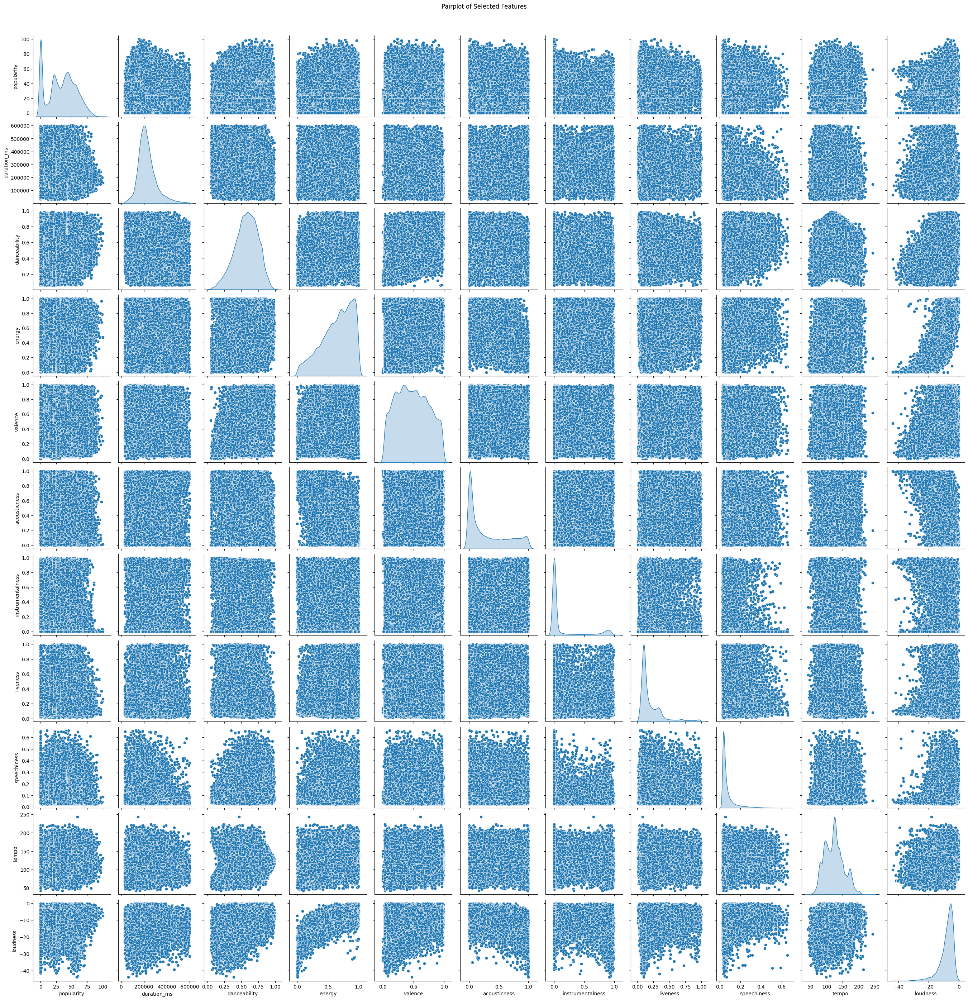

In [ ]:
sns.pairplot(df_final[new_numerical_features], diag_kind="kde")
plt.suptitle("Pairplot of Selected Features", y=1.02)
plt.show()

Group by + Aggregation

   track_genre  explicit       mean  median  count
0     acoustic         0  43.148734    48.0    948
1     acoustic         1  30.346154    28.0     52
2     afrobeat         0  24.348765    21.0    972
3     afrobeat         1  26.555556    24.5     18
4     alt-rock         0  33.641189    45.0    942
5     alt-rock         1  39.321429    59.0     56
6  alternative         0  24.552632     1.0    836
7  alternative         1  23.237805     0.5    164
8      ambient         0  44.161224    50.0    980
9      ambient         1  57.200000    59.0      5


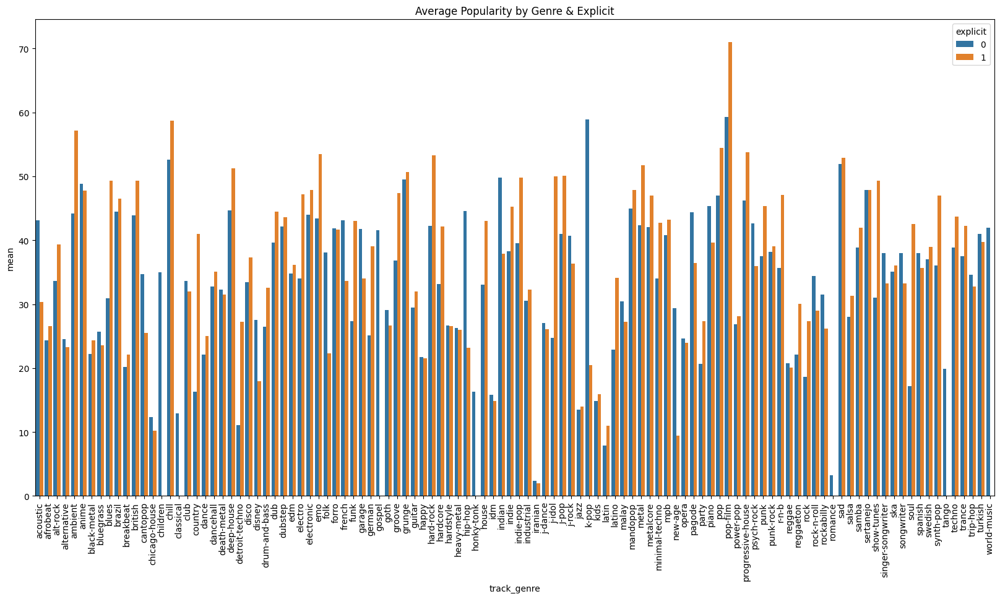

In [ ]:
grouped = df_final.groupby(["track_genre", "explicit"])["popularity"].agg(["mean","median","count"]).reset_index()
print(grouped.head(10))

# วาด barplot
plt.figure(figsize=(20,10))
sns.barplot(data=grouped, x="track_genre", y="mean", hue="explicit")
plt.xticks(rotation=90)
plt.title("Average Popularity by Genre & Explicit")
plt.show()

* Genre เป็นปัจจัยหลักที่ส่งผลต่อระดับ popularity
* Explicit มีผลต่อ popularity แต่จำกัดอยู่ที่บาง genre โดยเฉพาะแนว urban/rap/hip-hop

   track_genre  mode       mean  median  count
0     acoustic     0  39.516304    45.0    184
1     acoustic     1  43.151961    47.5    816
2     afrobeat     0  24.822314    21.0    484
3     afrobeat     1  23.974308    21.0    506
4     alt-rock     0  38.592179    46.0    358
5     alt-rock     1  31.368750    44.0    640
6  alternative     0  24.824873     1.0    394
7  alternative     1  24.019802     1.0    606
8      ambient     0  42.838275    50.0    371
9      ambient     1  45.066775    50.0    614


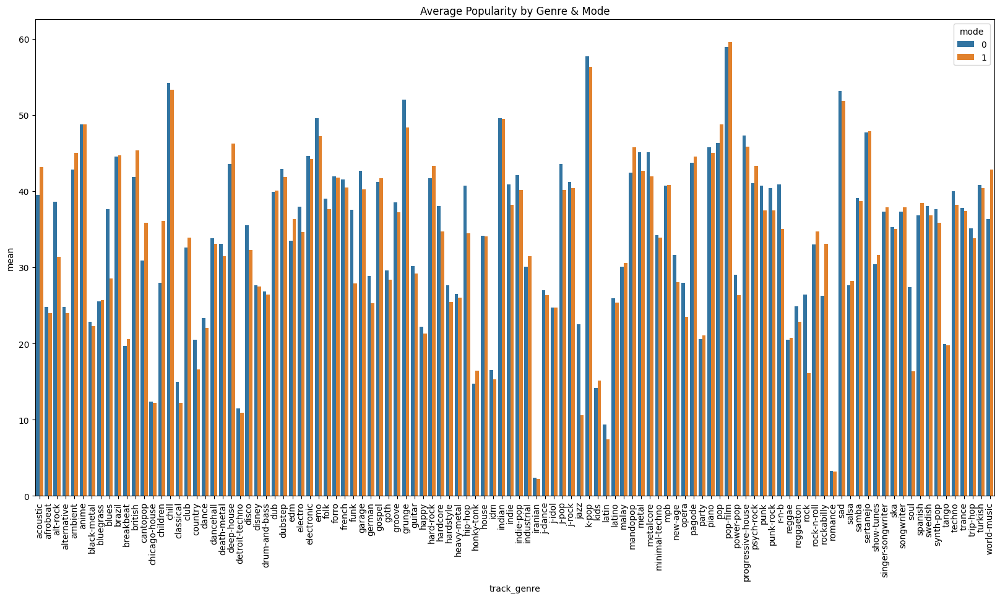

In [ ]:
grouped = df_final.groupby(["track_genre", "mode"])["popularity"].agg(["mean","median","count"]).reset_index()
print(grouped.head(10))

# วาด barplot
plt.figure(figsize=(20,10))
sns.barplot(data=grouped, x="track_genre", y="mean", hue="mode")
plt.xticks(rotation=90)
plt.title("Average Popularity by Genre & Mode")
plt.show()

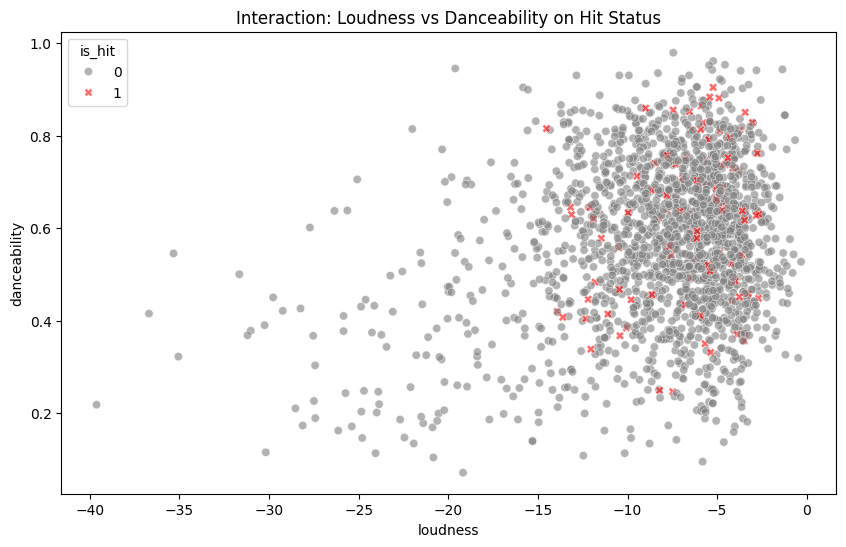

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=df_final.sample(2000),
    x='loudness',
    y='danceability',
    hue='is_hit',
    style='is_hit',
    alpha=0.6,
    palette={0: 'gray', 1: 'red'}
)
plt.title("Interaction: Loudness vs Danceability on Hit Status")
plt.show()

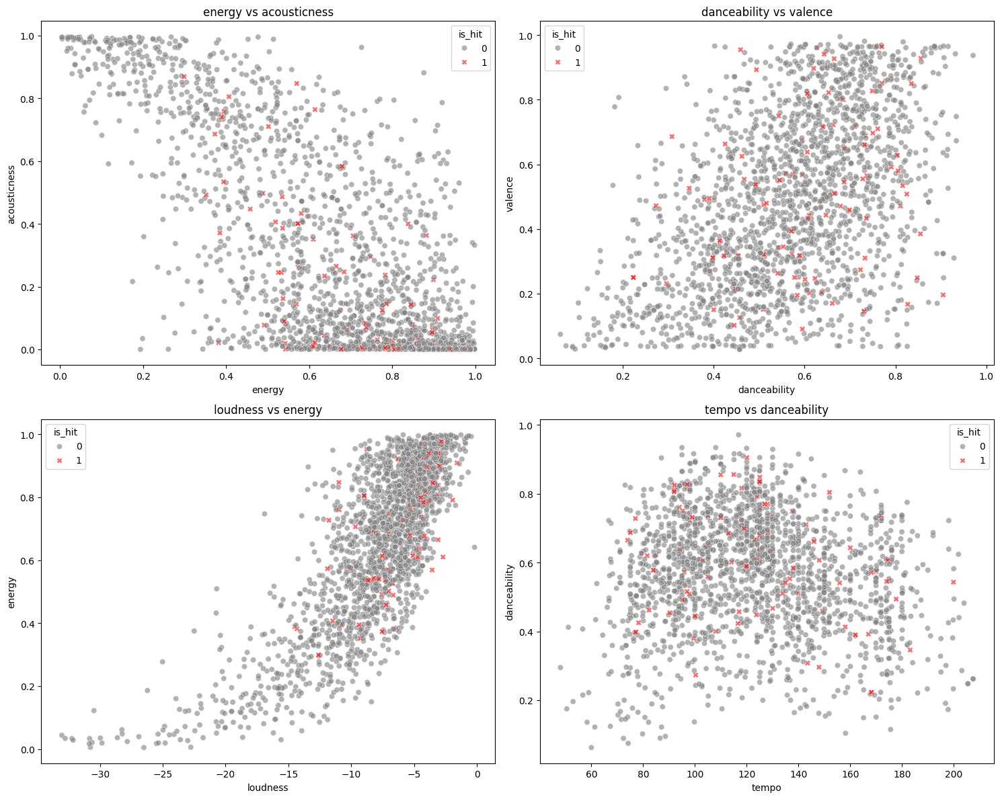

In [ ]:
# กำหนดคู่ที่น่าสนใจ
interesting_pairs = [
    ('energy', 'acousticness'),   # Digital vs Analog
    ('danceability', 'valence'),  # Mood Map
    ('loudness', 'energy'),       # Redundancy Check
    ('tempo', 'danceability')     # Rhythm Sweet Spot
]

plt.figure(figsize=(15, 12))

# สุ่มข้อมูลมาแค่ 2000 จุด เพื่อให้กราฟไม่อืดและดูรู้เรื่อง
plot_df = df_final.sample(n=2000, random_state=42)

for i, (x_col, y_col) in enumerate(interesting_pairs):
    plt.subplot(2, 2, i+1)

    # Scatter plot แยกสีตาม Hit/Non-Hit
    sns.scatterplot(
        data=plot_df,
        x=x_col,
        y=y_col,
        hue='is_hit',
        palette={0: 'gray', 1: 'red'}, # ให้เพลงฮิตสีแดงเด่นๆ เพลงไม่ฮิตสีเทาจางๆ
        alpha=0.6,
        style='is_hit' # เปลี่ยนรูปทรงจุดด้วย เผื่อดูสีไม่ออก
    )

    plt.title(f"{x_col} vs {y_col}")
    plt.xlabel(x_col)
    plt.ylabel(y_col)

plt.tight_layout()
plt.show()

เปรียบเทียบในแต่ละ genre
* บาง genre popularity ของ mode 1 (major) สูงกว่า เช่น acoustic, ambient
* บาง genre popularity ของ mode 0 (minor) สูงกว่า เช่น alt-rock, grunge
* บาง genre แตกต่างไม่มาก เช่น afrobeat, alternative

การกระจาย popularity
* genre ที่ popularity สูงชัดเจน เช่น ambient, pop, k-pop, edm (mean popularity สูงเกิน 40-50)
* genre ที่ popularity ต่ำ เช่น alternative, death-metal (mean popularity ต่ำกว่า 30)

กลุ่มที่จำนวนต่างกันมาก
* acoustic mode=1 มี 815 เพลง → mean popularity 43.1
* acoustic mode=0 มี 184 เพลง → mean popularity 39.5  
→ แปลว่าเพลง acoustic ที่เป็น major key มีเยอะกว่าและนิยมมากกว่า

Insight
* Major key (mode=1) โดยรวมมักจะได้รับความนิยมสูงกว่าเล็กน้อยในหลาย genre → บ่งบอกว่าเพลง major key ฟังง่ายและเข้าถึงคนฟังมากกว่า

* Minor key (mode=0) เด่นเฉพาะในบาง genre ที่นิยมความรู้สึก “เศร้า” “ดาร์ค” เช่น alt-rock, grunge

In [ ]:
# เลือกเฉพาะ numerical features ที่น่าจะมีผล
agg_features = ["danceability", "energy", "speechiness", "acousticness",
                "instrumentalness", "valence", "tempo", "loudness", "duration_ms"]

hit_stats = df_final.groupby("is_hit")[agg_features].mean().T
print("ค่าเฉลี่ยของ Features ตามเพลงดัง/ไม่ดัง:")
display(hit_stats)


ค่าเฉลี่ยของ Features ตามเพลงดัง/ไม่ดัง:


is_hit,0,1
danceability,0.570460,0.616701
energy,0.642250,0.672087
speechiness,0.077503,0.074975
acousticness,0.312866,0.220207
instrumentalness,0.146937,0.035504
valence,0.480898,0.505109
tempo,122.965026,120.239529
loudness,-8.141270,-6.625225
duration_ms,226987.000029,218452.130769


เพลง hit มีลักษณะร่วม
* ฟังง่าย เต้นง่าย (สูงกว่าใน danceability & energy)
* มีเนื้อร้อง (vocal-based) (instrumentalness ต่ำ)
* โทนเพลง positive/happy (valence สูงกว่า)
* เสียงโดยรวมดัง (loudness สูงกว่า → ผ่านการ mastering ให้ดัง)
* acoustic มีไม่เยอะ

สิ่งที่ไม่ค่อยมีผล
* speechiness (การพูด/rap)
* tempo (เร็ว/ช้าใกล้เคียงกัน)
* duration (ความยาวเพลงไม่ต่าง)

In [ ]:
genre_hit = df_final.groupby("track_genre")["is_hit"].mean().sort_values(ascending=False)
print("Top 10 แนวเพลงที่มีสัดส่วนเพลงดังสูง:")
display(genre_hit.head(10))

Top 10 แนวเพลงที่มีสัดส่วนเพลงดังสูง:


,is_hit
track_genre,
pop,0.317000
dance,0.245245
electro,0.241725
k-pop,0.226815
house,0.221443
metal,0.217871
rock,0.198000
indie,0.185000
edm,0.182365


In [ ]:
explicit_hit = df_final.groupby("explicit")["is_hit"].mean()
print("สัดส่วนเพลงดังใน explicit และ non-explicit:")
display(explicit_hit)

สัดส่วนเพลงดังใน explicit และ non-explicit:


,is_hit
explicit,
0,0.045665
1,0.099042


In [ ]:
mode_hit = df_final.groupby("mode")["is_hit"].mean()
print("สัดส่วนเพลงดังตามโหมด (Major/Minor):")
display(mode_hit)

สัดส่วนเพลงดังตามโหมด (Major/Minor):


,is_hit
mode,
0,0.054410
1,0.047499


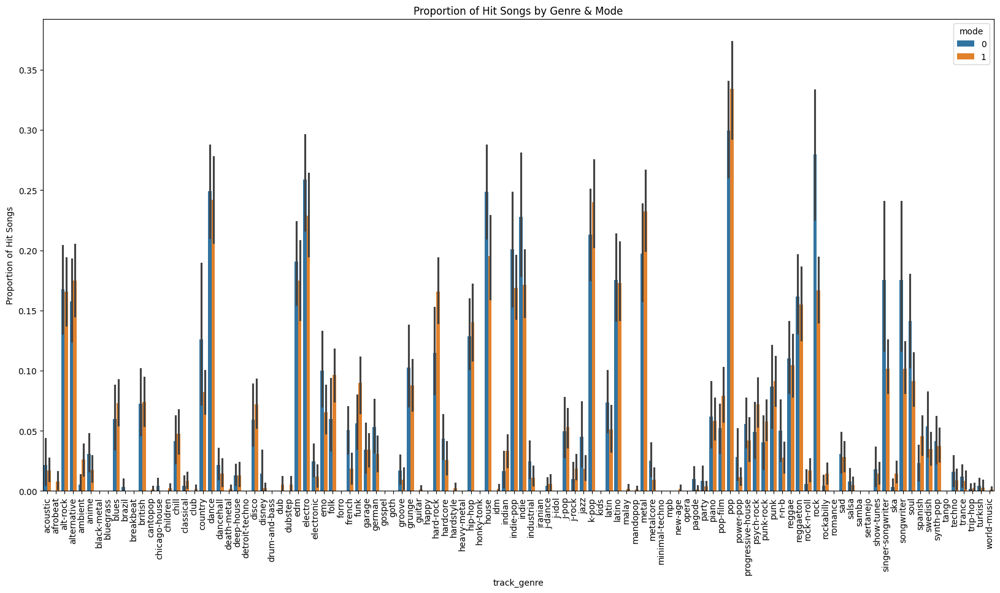

In [ ]:
plt.figure(figsize=(20,10))
sns.barplot(data=df_final, x="track_genre", y="is_hit", hue="mode")
plt.xticks(rotation=90)
plt.title("Proportion of Hit Songs by Genre & Mode")
plt.ylabel("Proportion of Hit Songs")
plt.show()

* Mode (major/minor) มีผลต่อโอกาส Hit แต่ไม่ใช่ทุก genre → ในเพลง pop/latin Major = โอกาสดังสูงกว่า แต่ใน rock/metal Minor ก็สามารถดังได้
* Genre เป็นตัวกำหนดหลัก ว่าเพลงมีโอกาสเป็น Hit แค่ไหน
* การดู Genre & Mode ร่วมกัน (interaction features) จะช่วยให้โมเดลทำนาย Hit ได้แม่นขึ้น

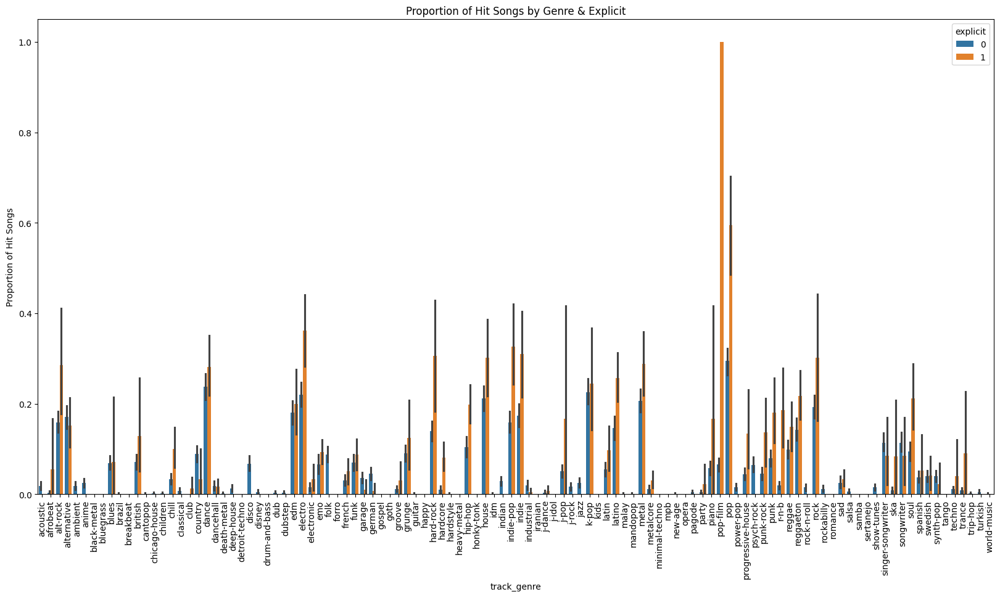

In [ ]:
plt.figure(figsize=(20,10))
sns.barplot(data=df_final, x="track_genre", y="is_hit", hue="explicit")
plt.xticks(rotation=90)
plt.title("Proportion of Hit Songs by Genre & Explicit")
plt.ylabel("Proportion of Hit Songs")
plt.show()

* Genre เป็นตัวแปรสำคัญต่อความนิยม (บาง genre มีสัดส่วน hit สูงกว่าชัดเจน)
* Explicit มีผล แต่ขึ้นอยู่กับ genre → ใน pop/hip-hop การเป็น explicit เพิ่มโอกาส hit, แต่ใน genre acoustic/classical ไม่ค่อยมีผล
* Genre & Explicit interaction → การพิจารณาสองตัวแปรร่วมกัน (interaction) จะช่วยทำนาย hit ได้ดีกว่าใช้แยกเดี่ยว

###**Pattern and Trend Detection**

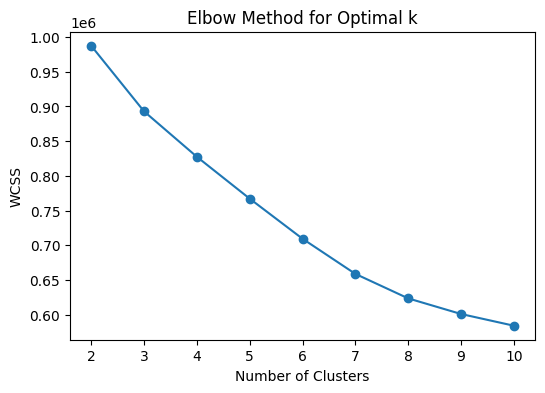

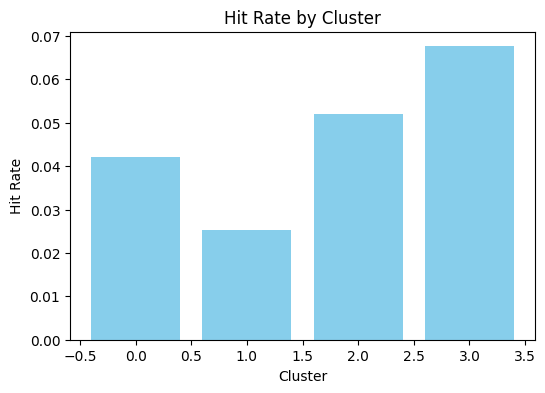

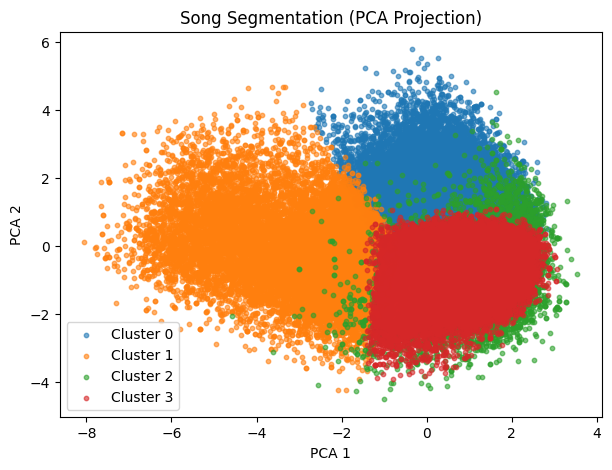

,cluster,hit_rate,num_songs
0,0,0.042221,33348
1,1,0.025330,22227
2,2,0.051906,8631
3,3,0.067597,44987


In [ ]:
# --- 1. เลือก Numerical Feature สำหรับ Clustering ---
X = df_final[new_numerical_features]

# --- 2. Scaling ---
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# --- 3. เลือกจำนวน Cluster ด้วย Elbow Method ---
wcss = []  # Within-Cluster Sum of Squares
K = range(2, 11)  # ลองตั้งแต่ 2 ถึง 10 cluster
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(X_scaled)
    wcss.append(kmeans.inertia_)

plt.figure(figsize=(6,4))
plt.plot(K, wcss, marker='o')
plt.title("Elbow Method for Optimal k")
plt.xlabel("Number of Clusters")
plt.ylabel("WCSS")
plt.show()

# --- 4. Fit KMeans ด้วยจำนวน cluster ที่เลือก (สมมติ k=4 จาก elbow) ---
k_optimal = 4
kmeans = KMeans(n_clusters=k_optimal, random_state=42, n_init=10)
clusters = kmeans.fit_predict(X_scaled)
df_final["cluster"] = clusters

# --- 5. Hit-rate ของแต่ละ cluster ---
cluster_summary = df_final.groupby("cluster")["is_hit"].agg(["mean","count"]).reset_index()
cluster_summary.rename(columns={"mean":"hit_rate","count":"num_songs"}, inplace=True)

# --- 6. Visualization: Hit Rate per Cluster ---
plt.figure(figsize=(6,4))
plt.bar(cluster_summary["cluster"], cluster_summary["hit_rate"], color="skyblue")
plt.title("Hit Rate by Cluster")
plt.xlabel("Cluster")
plt.ylabel("Hit Rate")
plt.show()

# --- 7. PCA ลดมิติสำหรับ Visualization ---
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)
df_final["pca1"], df_final["pca2"] = X_pca[:,0], X_pca[:,1]

plt.figure(figsize=(7,5))
for cluster in sorted(df_final["cluster"].unique()):
    subset = df_final[df_final["cluster"] == cluster]
    plt.scatter(subset["pca1"], subset["pca2"], s=10, label=f"Cluster {cluster}", alpha=0.6)
plt.title("Song Segmentation (PCA Projection)")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.legend()
plt.show()

cluster_summary

1. Elbow Method for Optimal k
* กราฟ WCSS (Within-Cluster Sum of Squares) ใช้วัดคุณภาพของการจัดกลุ่ม
* จุด “elbow” อยู่ประมาณ k = 4 → หมายถึงแบ่งเป็น 4 กลุ่มให้ผลเหมาะสมที่สุด
* ถ้าเลือก k น้อยกว่านี้ cluster จะกว้างเกินไป, ถ้าเลือก k มากไปจะ overfitting
2. Hit Rate by Cluster -> ความน่าจะเป็นที่เพลงใน cluster นั้นเป็น hit song
* Cluster 1 → มี Hit Rate สูงที่สุด (~6%)
* Cluster 2 → Hit Rate ต่ำที่สุด (~2%)
* Cluster 0 และ 3 อยู่ระดับกลาง (4–5%)
แสดงว่าบาง cluster มีแนวโน้มที่จะผลิต “เพลงฮิต” มากกว่า cluster อื่น
3. Song Segmentation (PCA Projection) -> ใช้ PCA ลดมิติเป็น 2D เพื่อ visualise 4 clusters เห็นการกระจายชัดเจน
* Cluster 0 (สีน้ำเงิน) → กระจายอยู่ด้านบนขวา - ล่างขวา
* Cluster 1 (สีส้ม) → อยู่ด้านบน-ขวา
* Cluster 2 (สีเขียว) → กินพื้นที่กว้างมาก (หลากหลายเพลง)
* Cluster 3 (สีแดง) → กระจุกด้านขวา


###**Hidden Relationships**

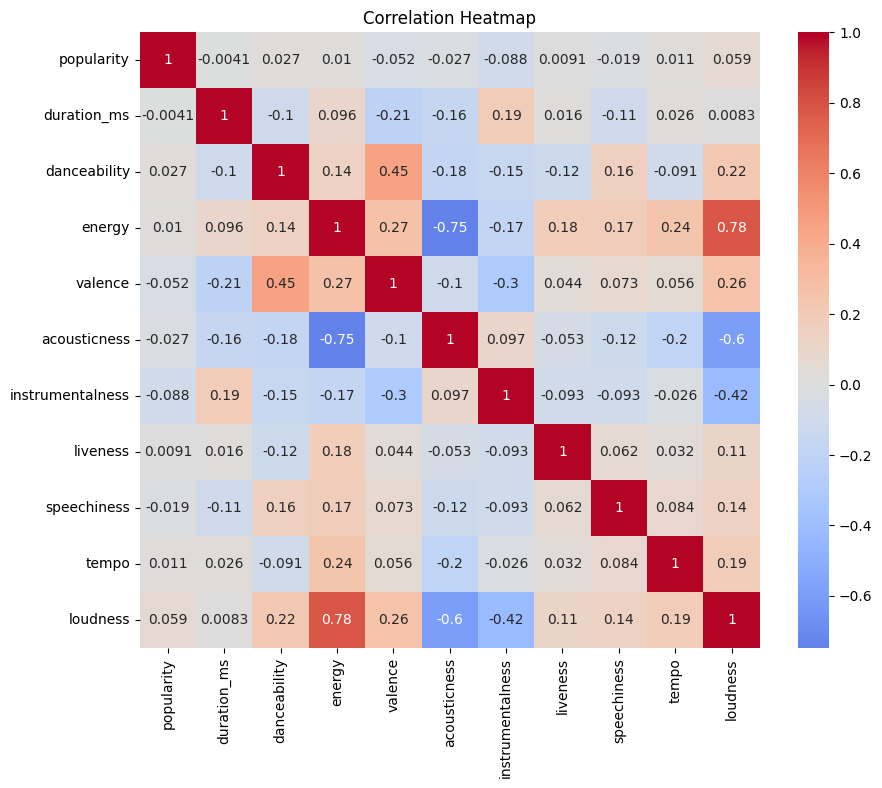

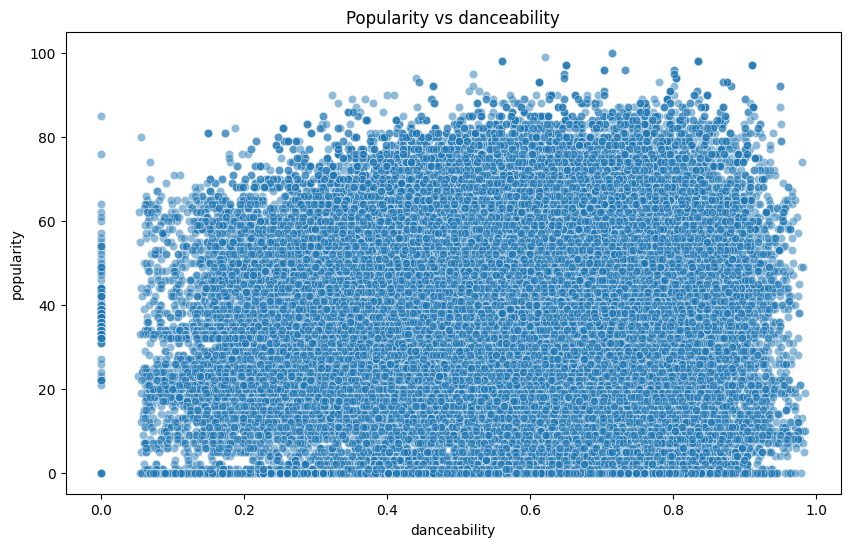

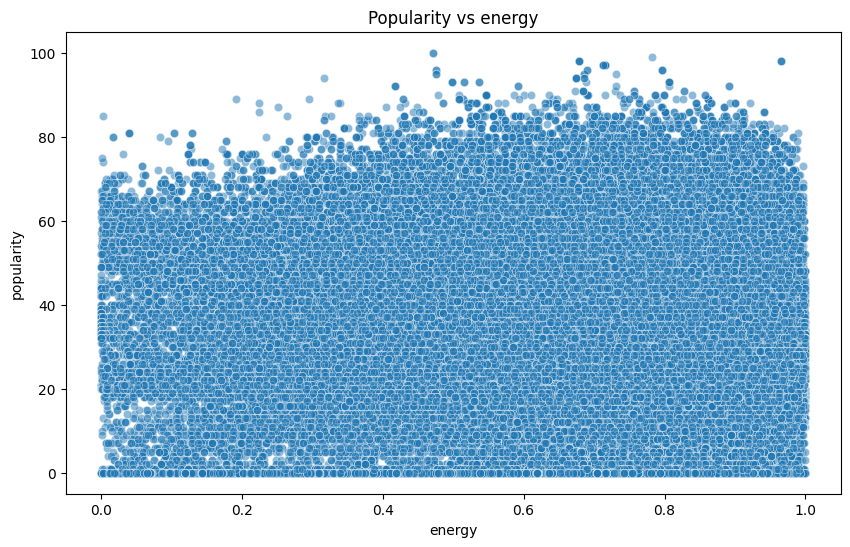

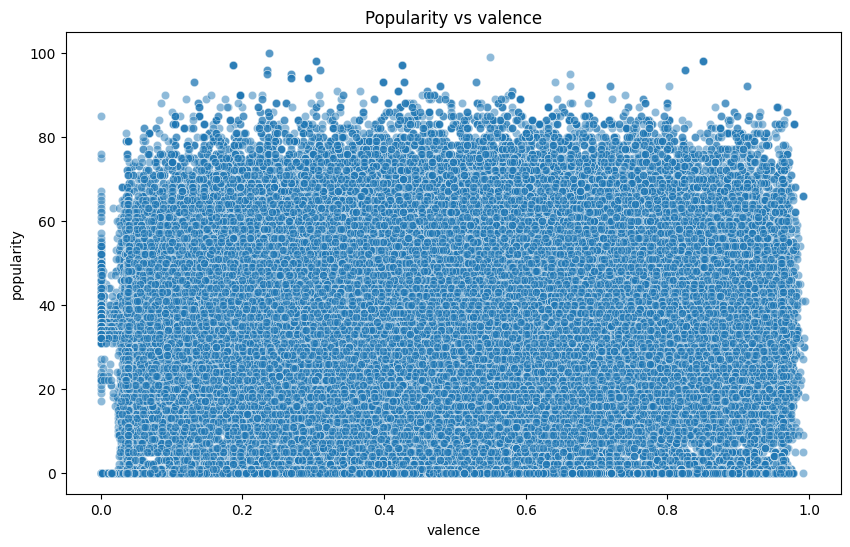

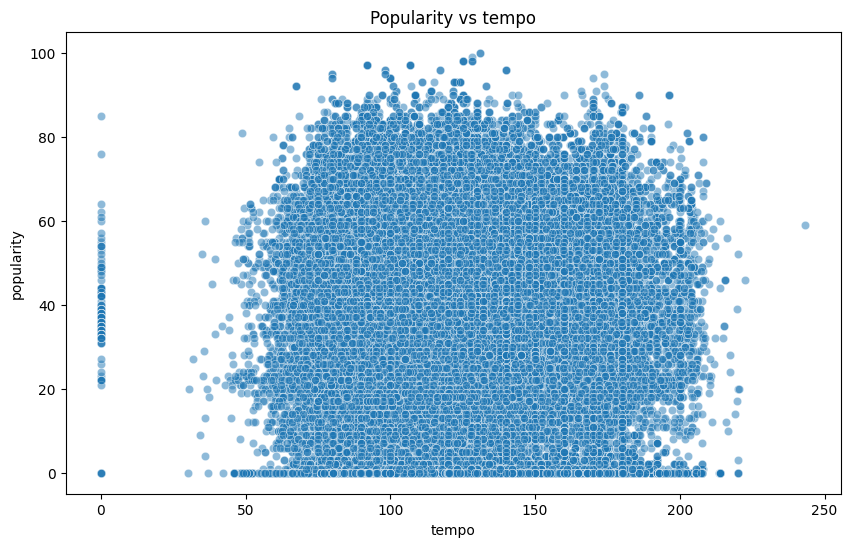

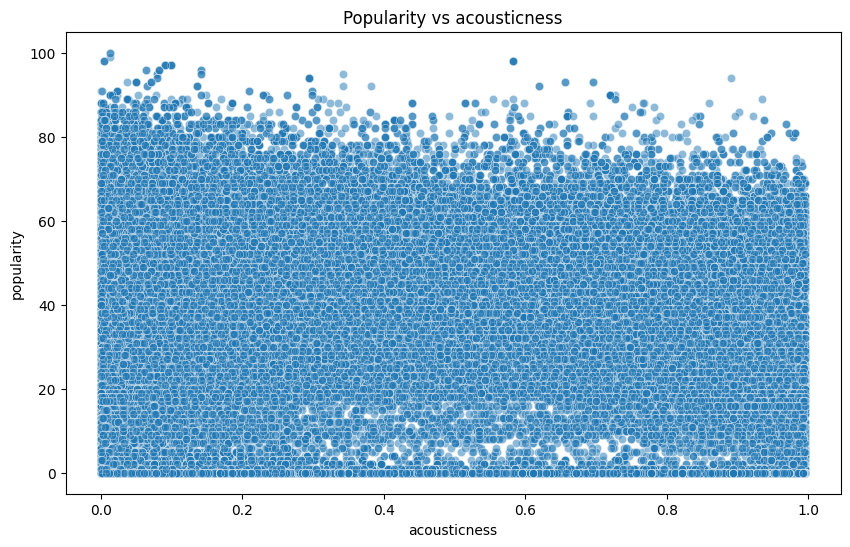

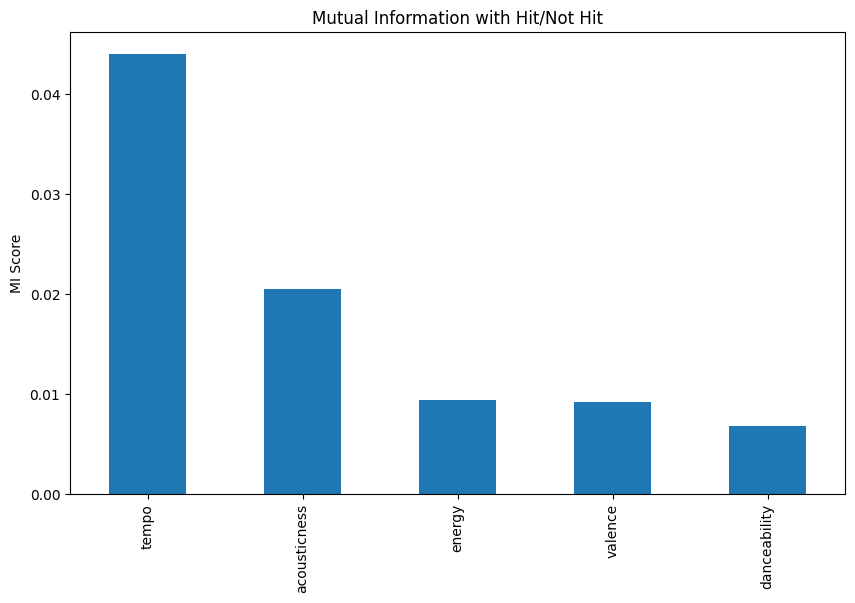

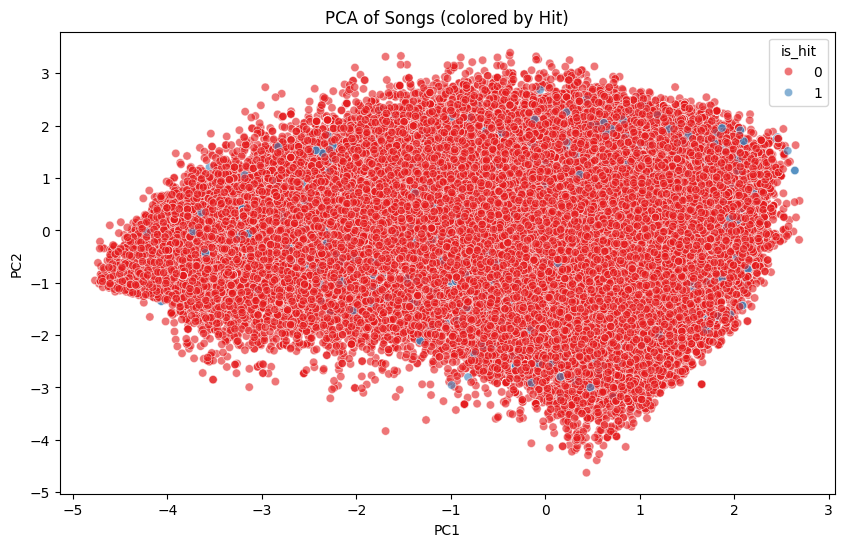

In [ ]:
# 1. Correlation Matrix
# Exclude non-numeric columns before calculating correlation
numerical_df = df_final[new_numerical_features]
plt.figure(figsize=(10,8))
sns.heatmap(numerical_df.corr(), cmap="coolwarm", center=0, annot=True)
plt.title("Correlation Heatmap")
plt.show()

# 2. ความสัมพันธ์ระหว่าง feature และ popularity
features = ["danceability", "energy", "valence", "tempo", "acousticness"]
for f in features:
    plt.figure(figsize=(10,6))
    sns.scatterplot(x=df[f], y=df["popularity"], alpha=0.5)
    plt.title(f"Popularity vs {f}")
    plt.show()

# 3. Mutual Information (สำหรับ target แบบ is_hit)
# Ensure X only contains numerical features for mutual_info_classif
X = df_final[features]
y = df_final["is_hit"]

mi = mutual_info_classif(X, y, random_state=42)
mi_scores = pd.Series(mi, index=features).sort_values(ascending=False)

plt.figure(figsize=(10,6))
mi_scores.plot(kind="bar")
plt.title("Mutual Information with Hit/Not Hit")
plt.ylabel("MI Score")
plt.show()

# 4. PCA เพื่อตรวจ Hidden Patterns
# Ensure X only contains numerical features for PCA
X = df_final[features]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_scaled)

plt.figure(figsize=(10,6))
sns.scatterplot(x=pca_result[:,0], y=pca_result[:,1], hue=df_final["is_hit"], palette="Set1", alpha=0.6)
plt.title("PCA of Songs (colored by Hit)")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()

Insight : Hidden Relationships

1. Correlation Heatmap -> เป็นการดู ความสัมพันธ์เชิงเส้น (linear correlation) ระหว่าง feature ทั้งหมด
* danceability, energy, valence มีความสัมพันธ์บวกกับ popularity เล็กน้อย
* acousticness และ instrumentalness มีความสัมพันธ์เชิงลบกับ energy และ loudness
* Feature ส่วนใหญ่ไม่สัมพันธ์กันมากนัก หมายถึงเพลงมีความหลากหลายสูง
2. Popularity vs Danceability -> กราฟ scatter แสดงความสัมพันธ์ระหว่าง การเต้นได้ (danceability) และ ความนิยม
* มีแนวโน้มว่าเพลงที่ danceable สูง มักมี popularity สูงกว่าเล็กน้อย
* แต่ความสัมพันธ์ไม่ชัดเจนมาก (จุดกระจายทั่ว) มี danceability เพียงอย่างเดียวไม่ได้กำหนดว่าเพลงจะฮิต
3. Popularity vs Energy -> แสดงความสัมพันธ์ระหว่างพลังงานของเพลง (energy) และ ความนิยม
* เพลงที่มี energy สูง มีแนวโน้มได้รับความนิยมมากขึ้นเล็กน้อย
* เช่นเดียวกับ danceability ความสัมพันธ์ไม่แรงมาก แต่สะท้อนว่าเพลง energetic น่าจะดึงดูดผู้ฟัง
4. Popularity vs Valence -> Valence = ความเป็น เพลงอารมณ์ดี/เชิงบวก
* เพลงที่มี valence สูง (อารมณ์ positive) มักจะได้รับความนิยมมากกว่าเล็กน้อย
* แต่ยังมีเพลงที่ valence ต่ำแต่ฮิต → บอกว่าอารมณ์เพลงไม่ใช่ factor เดียว
5. Popularity vs Tempo -> Tempo = ความเร็วของเพลง
* ไม่มีความสัมพันธ์เชิงเส้นชัดเจน
* เพลงที่มี tempo ทุกระดับสามารถเป็นที่นิยมได้
* แต่จาก Mutual Information (MI) พบว่า tempo เป็นตัวแปรที่มี informative power สูงที่สุดในการทำนาย hit
6. Popularity vs Acousticness
* เพลง acousticness สูงยังสามารถเป็นที่นิยมได้ (มีหลายจุด popularity สูงที่ acousticness > 0.5)
* แต่โดยรวมเพลง acoustic น้อยจะนิยมมากกว่า เพลงที่ปรับแต่งโปรดักชันจะฮิตง่ายกว่า
7. Mutual Information with Hit/Not Hit -> บอกว่า feature ไหนมีประโยชน์ในการทำนาย is_hit มากที่สุด
* tempo → สำคัญที่สุด
* acousticness, energy, valence, danceability มีผลบ้างแต่ไม่มาก
* แสดงว่า “hit song” ไม่ได้เกิดจาก factor เดียว แต่ combination ของหลาย feature
8. PCA of Songs (colored by Hit) -> ลดมิติด้วย PCA เหลือ 2 มิติ แล้ว plot โดยใช้ is_hit
* จุด hit (สีน้ำเงิน) กระจายอยู่ทั่วไป หมายถึง hit ไม่ได้ถูกจำกัดใน cluster เดียว
* เพลง hit สามารถเกิดขึ้นได้ในหลาย style/feature combination

สร้าง interaction features เพื่อตรวจสอบว่า features ไหนบ้างที่นำมาวิเคราะห์ร่วมกันแล้วทำให้แม่นยำมากที่สุด โดยเลือกจาก feature ที่ค่อนข้างมีผลต่อความนิยม

📊 Correlation กับ is_hit (Linear Relationship):
dance_valence_avg      0.042045
energy_loudness_mul    0.035602
dance_valence_mul      0.033873
valence_tempo_mul      0.008285
acoustic_speech_mul   -0.031215
acoustic_speech_sum   -0.063230
Name: is_hit, dtype: float64

📊 Top 10 Genre_Mode (Non-linear Relationship via MI):
gm_pop_0               0.002627
gm_electro_0           0.001943
gm_honky-tonk_1        0.001856
gm_latino_1            0.001778
gm_show-tunes_1        0.001531
gm_guitar_1            0.001424
gm_alternative_0       0.001422
gm_minimal-techno_0    0.001338
gm_trip-hop_0          0.001331
gm_bluegrass_0         0.001314
dtype: float64


/tmp/ipython-input-153832673.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=corr_scores.values, y=corr_scores.index, palette="coolwarm")


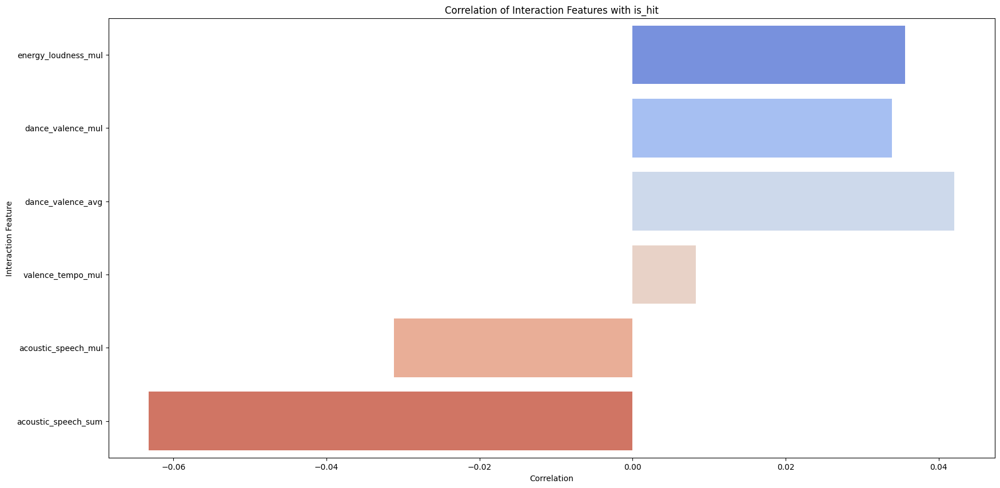

/tmp/ipython-input-153832673.py:43: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=mi_series.values, y=mi_series.index, palette="viridis")


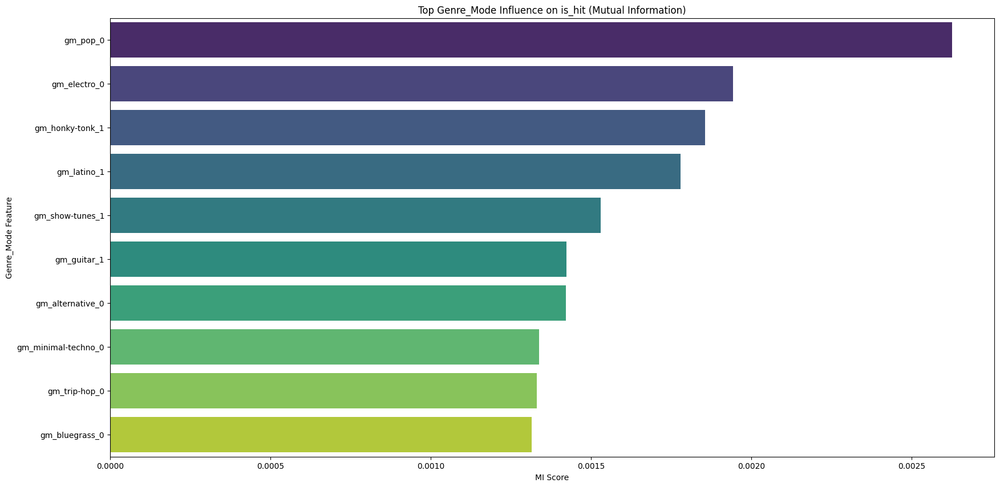

In [ ]:
from sklearn.feature_selection import mutual_info_classif # <--- เปลี่ยน library ตรงนี้

# ... (ส่วนสร้าง interaction features ด้านบนเหมือนเดิม) ...

# 1. เลือกฟีเจอร์ที่สนใจ
interaction_features = [
    "energy_loudness_mul",
    "dance_valence_mul", "dance_valence_avg",
    "valence_tempo_mul",
    "acoustic_speech_mul", "acoustic_speech_sum"
]

# 2. คำนวณ Correlation (ใช้ได้ แต่ต้องระวังว่ามันวัดแค่เชิงเส้น)
# หมายเหตุ: is_hit เป็น 0/1 การใช้ Point-Biserial correlation (ซึ่งสูตรเดียวกับ Pearson) ถือว่ายอมรับได้
corr_scores = df_final[interaction_features + ["is_hit"]].corr()["is_hit"].drop("is_hit")

# 3. คำนวณ Mutual Information (สำหรับ Categorical)
X_cat = pd.get_dummies(df_final["genre_mode"], prefix="gm")

# --- 🔥 แก้ไขตรงนี้: ใช้ classif แทน regression ---
mi_scores = mutual_info_classif(X_cat, df_final["is_hit"], random_state=42)

# รวมผล
mi_series = pd.Series(mi_scores, index=X_cat.columns).sort_values(ascending=False).head(10)

# 4. แสดงผลและวาดกราฟ (เหมือนเดิม)
print("📊 Correlation กับ is_hit (Linear Relationship):")
print(corr_scores.sort_values(ascending=False))

print("\n📊 Top 10 Genre_Mode (Non-linear Relationship via MI):")
print(mi_series)

# 5. วาดกราฟ Correlation ของ interaction features
plt.figure(figsize=(20,10))
sns.barplot(x=corr_scores.values, y=corr_scores.index, palette="coolwarm")
plt.title("Correlation of Interaction Features with is_hit")
plt.xlabel("Correlation")
plt.ylabel("Interaction Feature")
plt.show()

# 6. วาดกราฟ Mutual Information ของ genre_mode
plt.figure(figsize=(20,10))
sns.barplot(x=mi_series.values, y=mi_series.index, palette="viridis")
plt.title("Top Genre_Mode Influence on is_hit (Mutual Information)")
plt.xlabel("MI Score")
plt.ylabel("Genre_Mode Feature")
plt.show()

####Correlation vs is_hit
hit rate
* dance_valence_avg	0.0477	ยิ่งเพลงมีค่าค่าเฉลี่ยของ danceability + valence สูงขึ้น (เพลงเต้นง่าย + ฟีลบวก) ยิ่งมีโอกาสเป็นเพลง hit มากขึ้น
* dance_valence_mul	0.0389	ลักษณะคล้ายกับด้านบน แต่ใช้การคูณ → ชี้ว่าเพลงที่ทั้งเต้นง่ายและมีอารมณ์บวกพร้อมกันมีแนวโน้มเป็น hit
* energy_loudness_mul	0.0374	เพลงที่มีพลังงานสูงและเสียงดัง มีแนวโน้มเป็นเพลง hit
* valence_tempo_mul	0.0134	เพลงเร็วและมีอารมณ์บวกเล็กน้อยสัมพันธ์กับ hit แต่ไม่แรงมาก

non-hit rate
* acoustic_speech_mul	-0.0348	เพลงที่ทั้งอะคูสติกสูงและมี speechiness (พูดมากกว่าเป็นเพลง) สูง → มีแนวโน้ม ไม่ เป็น hit
* acoustic_speech_sum	-0.0636	ยิ่งเพลงอะคูสติก + speechiness สูงรวมกัน ยิ่งมีโอกาสเป็น non-hit (strong negative correlation)

สรุป
* เพลง hit มักจะ  
เต้นง่าย + ฟีลบวก (danceability, valence สูง)  
พลังงานสูง + ดัง  
ไม่ค่อยอะคูสติก/พูดเยอะ

####Top genre vs is_hit
* gm_techno_0 → เพลงที่ไม่ใช่ Techno มีแนวโน้มเป็น hit มากกว่าเพลง Techno
* gm_trip-hop_1 → Trip-hop โหมด 1 (major key) มีผลกับ hit (อาจเพราะ sample เล็ก แต่ดูโดดเด่น)
* gm_guitar_0 → ไม่ใช่ guitar-genre มีโอกาสเป็น hit มากกว่า
* gm_sleep_1 → เพลงที่อยู่ใน "sleep" genre แต่เป็น major key มีผลสัมพันธ์กับ hit (น่าสนใจ เพราะ sleep songs ที่เป็น major อาจได้รับความนิยมมากกว่าที่คิด)
* gm_reggaeton_1 / gm_cantopop_1 / gm_spanish_1 / gm_power-pop_1 / gm_mandopop_1 → genre เหล่านี้มีผลเชิงบวกกับการเป็น hit

สรุปภาพรวม:  
Hit songs มีแนวโน้ม  
อยู่ใน genre pop, reggaeton, cantopop, spanish pop, power-pop, mandopop  
อยู่ใน key ที่เป็น major (mode = 1)  
ไม่ค่อยอยู่ใน techno หรือ guitar-based genre

Insight
* Feature Engineering: สามารถใช้ interaction features ที่เกี่ยวกับ danceability, valence, energy, loudness เพื่อสร้าง model prediction ได้

* Target Genre Selection: เน้นเพลง pop, reggaeton, cantopop, spanish pop จะเพิ่มโอกาสเจอเพลง hit

* Filtering: ตัดเพลงอะคูสติกที่มี speechiness สูง เพราะมีโอกาสไม่เป็น hit

/tmp/ipython-input-2707308857.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=mi_series.values, y=mi_series.index, palette="mako")


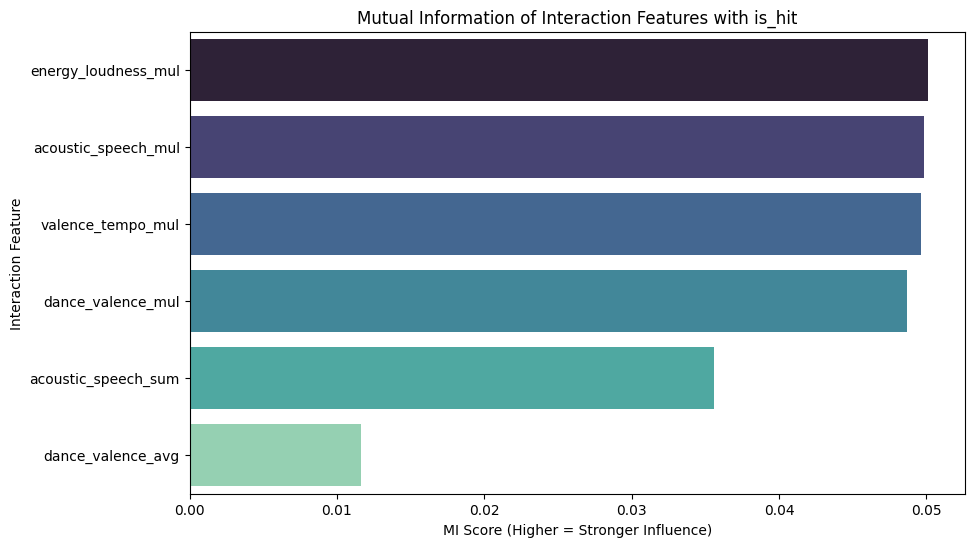

In [ ]:
# ฟีเจอร์ผสม
interaction_features = [
    "energy_loudness_mul",
    "dance_valence_mul", "dance_valence_avg",
    "valence_tempo_mul",
    "acoustic_speech_mul", "acoustic_speech_sum"
]

X = clean_df[interaction_features]
y = clean_df["is_hit"]

# Mutual Information
mi_scores = mutual_info_classif(X, y, random_state=42)
mi_series = pd.Series(mi_scores, index=interaction_features).sort_values(ascending=False)

# Plot
plt.figure(figsize=(10,6))
sns.barplot(x=mi_series.values, y=mi_series.index, palette="mako")
plt.title("Mutual Information of Interaction Features with is_hit")
plt.xlabel("MI Score (Higher = Stronger Influence)")
plt.ylabel("Interaction Feature")
plt.show()

Mutual Information (MI) คือ MI เป็นค่าที่บอกว่า ฟีเจอร์ให้ข้อมูลใหม่แค่ไหน เกี่ยวกับ target (ในที่นี้คือ is_hit)
* ถ้า MI = 0 → ฟีเจอร์นั้น ไม่มีความสัมพันธ์เลย กับ target (ไม่ช่วยทำนาย)
* ถ้า MI > 0 และค่ามากขึ้น → ฟีเจอร์นั้น ช่วยแยกแยะ hit/non-hit ได้ดีขึ้น

/usr/local/lib/python3.12/dist-packages/mlxtend/frequent_patterns/fpcommon.py:161: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


                                 antecedents  \
174                  (high_dance, high_loud)   
176                (high_loud, high_valence)   
167    (high_dance, high_loud, high_valence)   
180                (high_dance, high_energy)   
121                  (high_dance, high_loud)   
166     (high_dance, high_energy, high_loud)   
134                  (high_dance, high_loud)   
152                (high_loud, high_valence)   
172  (high_dance, high_energy, high_valence)   
120                (high_dance, high_energy)   

                             consequents   support  confidence      lift  
174  (high_energy, is_hit, high_valence)  0.011050    0.042732  2.436997  
176    (high_dance, high_energy, is_hit)  0.011050    0.038573  2.392386  
167                (high_energy, is_hit)  0.011050    0.058215  2.259748  
180    (high_loud, is_hit, high_valence)  0.011050    0.043335  2.254351  
121                (high_energy, is_hit)  0.014578    0.056377  2.188419  
166               (is

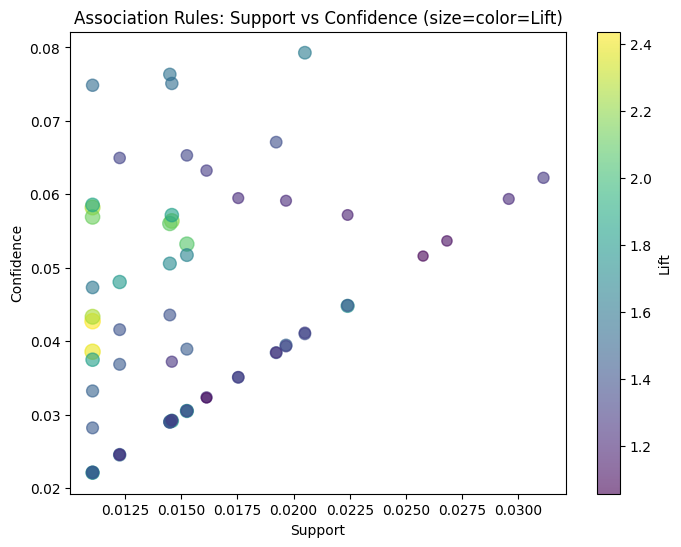

In [ ]:
# --- 1. เลือก Features ที่มีความหมายชัดเจน ---
df_apriori = clean_df.copy()

# แปลง feature numerical ให้เป็น bin (High/Low)
df_apriori['high_dance'] = (df_apriori['danceability'] > df_apriori['danceability'].median()).astype(int)
df_apriori['high_energy'] = (df_apriori['energy'] > df_apriori['energy'].median()).astype(int)
df_apriori['high_valence'] = (df_apriori['valence'] > df_apriori['valence'].median()).astype(int)
df_apriori['high_loud'] = (df_apriori['loudness'] > df_apriori['loudness'].median()).astype(int)

# เราอาจใช้ genre_mode บางตัวที่สำคัญ (จาก MI)
top_genres = ["techno", "trip-hop", "reggaeton", "cantopop", "spanish", "power-pop", "mandopop"]
for g in top_genres:
    df_apriori[f"genre_{g}"] = (df_apriori['track_genre'].str.contains(g)).astype(int)

# target (is_hit) ก็แปลงเป็น item
df_apriori['is_hit'] = df_apriori['is_hit'].astype(int)

# --- 2. เตรียม Data ให้เป็น One-Hot ---
df_items = df_apriori[
    ['high_dance', 'high_energy', 'high_valence', 'high_loud',
     'genre_techno', 'genre_trip-hop', 'genre_reggaeton', 'genre_cantopop',
     'genre_spanish', 'genre_power-pop', 'genre_mandopop',
     'is_hit']
]

# --- 3. Apriori Algorithm ---
frequent_itemsets = apriori(df_items, min_support=0.01, use_colnames=True)

# --- 4. Association Rules ---
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1.0)

# กรองให้ดูเฉพาะกฎที่ predict is_hit = 1
rules = rules[rules['consequents'].apply(lambda x: 'is_hit' in x)]

# จัดเรียงตาม lift เพื่อตัว pattern ที่มีผลมากที่สุด
rules_sorted = rules.sort_values(by='lift', ascending=False)

# แสดง top 10 rules
print(rules_sorted[['antecedents', 'consequents', 'support', 'confidence', 'lift']].head(10))

# --- 5. วาดกราฟ Lift vs Confidence เพื่อดูความสัมพันธ์ ---
import matplotlib.pyplot as plt
plt.figure(figsize=(8,6))
plt.scatter(rules_sorted['support'], rules_sorted['confidence'],
            s=rules_sorted['lift']*50, alpha=0.6, c=rules_sorted['lift'], cmap='viridis')
plt.xlabel("Support")
plt.ylabel("Confidence")
plt.title("Association Rules: Support vs Confidence (size=color=Lift)")
plt.colorbar(label="Lift")
plt.show()

## **Summary project progress**

สรุปขั้นตอนสำคัญของแต่ละขั้น
1. Data Loading -> โหลด dataset เข้ามา
2. Cleaning -> จัดการ Missing Values, Duplicate Rows, Outliers และตรวจสอบ Data Type
3. Transforming -> มีการแปลงค่าบาง Feature และทำการ Scaling
4. Enriching -> สร้าง Feature ใหม่ (is_hit)
5. Validating -> ตรวจสอบคุณภาพข้อมูลหลังการทำความสะอาด
6. Exploratory Data Analysis (EDA) -> วิเคราะห์ข้อมูลเพื่อหา Insight ต่างๆ ทั้งแบบ Univariate, Bivariate และ Multivariate


ภาพรวมข้อมูล และการทำความสะอาด
* Dataset มีขนาดใหญ่ และค่อนข้างสะอาด มี missing value เพียงเล็กน้อยในคอลัมน์เกี่ยวกับชื่อเพลง และศิลปิน ซึ่งได้ทำการลบแถวที่มี missing value ออกไปแล้ว
* Dataset ไม่มี duplicate rows ในข้อมูลเริ่มต้น แต่หลังจากจัดการ outlier บางส่วนด้วยการแทนที่ค่า median ทำให้เกิด duplicate rows ขึ้นเล็กน้อย (ประมาณ 6.27%) ซึ่งพิจารณาแล้วว่ายอมรับได้เนื่องจาก dataset มีขนาดใหญ่
มีการแปลงข้อมูลบางส่วน เช่น explicit เป็นตัวเลข, track_genre เป็นตัวเลขด้วย Label Encoding, และ scale บาง feature เช่น duration_ms, instrumentalness, liveness เพื่อเตรียมข้อมูลสำหรับการวิเคราะห์ และสร้างโมเดล

### การสรุป Insight จาก EDA



1. ปัจจัยใดบ้างที่มีผลต่อความนิยมของเพลง (Popularity) ?  
ปัจจัยที่สัมพันธ์กับ Popularity มากที่สุด ได้แก่
* แนวเพลง (Genre) → อิทธิพลสูงสุด
* Energy, Danceability, Loudness → มีผลบวกเล็กน้อย
* Acousticness, Instrumentalness → มีผลลบเล็กน้อย
* ฟีเจอร์อื่น ๆ เช่น Tempo, Valence, Liveness → แทบไม่มีผลชัดเจน

2. แนวเพลง (Genre) มีผลต่อความนิยม Popularity หรือไม่? เพลงแนวไหนมีความนิยมเฉลี่ยสูงที่สุด?
* มีผลอย่างมาก ต่อความนิยม Popularity ค่ะ จากการวิเคราะห์ Bivariate Analysis ระหว่าง track_genre และ is_hit พบว่าแนวเพลงที่แตกต่างกันมีสัดส่วนเพลงฮิต (is_hit = 1) ที่แตกต่างกันอย่างชัดเจน
แนวเพลงที่มีสัดส่วนเพลงดังสูงที่สุด 10 อันดับแรก ได้แก่ Pop, Dance, Electro, K-Pop, House, Metal, Rock, Indie, EDM, และ Indie-pop โดยเฉพาะแนวเพลง Pop มีสัดส่วนเพลงฮิตสูงที่สุด แสดงว่าแนวเพลงมีอิทธิพลอย่างมากต่อโอกาสที่เพลงจะได้รับความนิยมสูง

3. มี Missing Values หรือค่าผิดปกติไหม
* Missing Values: ในข้อมูลเริ่มต้นมี Missing Values เพียงเล็กน้อยในคอลัมน์ artists, album_name, และ track_name ซึ่งได้ทำการลบแถวที่มีค่า Missing Values ออกไปแล้ว และหลังจากทำความสะอาดข้อมูลแล้ว ไม่มี Missing Values เหลืออยู่ใน Dataset
* ค่าผิดปกติ (Outliers): พบค่าผิดปกติในหลายคอลัมน์ที่เป็น Numerical Features เช่น duration_ms, tempo, loudness, speechiness, liveness, instrumentalness ซึ่งได้ดำเนินการจัดการไปแล้ว โดยมีการใช้ Winsorization และการลบแถว Outlier ที่มีค่า Z-score สูง หรืออยู่นอกช่วงที่กำหนดตามโดเมนของข้อมูล แต่จะมีค่า outlier จากการหา z-score ซึ่งไม่มีผลต่อการทำ EDA เนื่องจากเป็น outlier ทางค่าสถติ

### สรุปเบื้องต้นสำหรับ Predictive Analytics ในอนาคต

* is_hit (การเป็นเพลงดัง/ไม่ดัง) เป็น target variable ในการสร้างโมเดล
* explicit และ track_genre เป็น categorical features ที่มีความสัมพันธ์กับ is_hit อย่างชัดเจน
* Numerical features แม้จะมีความสัมพันธ์กับ popularity ต่ำเมื่อดูเดี่ยวๆ แต่เมื่อพิจารณาค่าเฉลี่ยตามกลุ่ม is_hit พบความแตกต่าง ซึ่งอาจเป็นประโยชน์ในการสร้างโมเดล
* การทำ Clustering ช่วยให้เห็นกลุ่มเพลงที่มีแนวโน้มเป็นเพลงที่มีความนิยมสูง ซึ่งอาจนำไปใช้ในการสร้าง feature ใหม่ หรือเป็นส่วนหนึ่งของโมเดล

## **Data pre-processing**

โค้ดตรวจสอบว่า Data Pre-processing  
ผลที่ได้จากโค้ดนี้จะเช็คให้เลยว่า:  
✔ Missing values อยู่ไหม  
✔ มีแถวซ้ำไหม  
✔ Data types ถูกต้องหรือไม่  
✔ มี categorical ที่ยังไม่ encode ไหม  
✔ มีคอลัมน์ constant ไหม (ใช้ทำโมเดลไม่ได้)  
✔ Outliers อยู่คอลัมน์ไหนบ้าง (สำคัญสำหรับ KNN)  
✔ Distribution ของ target (check imbalance)

In [ ]:
def check_preprocessing(df, target_col=None):

    print("========== DATA PRE-PROCESSING CHECK ==========\n")

    # 1) Missing Values
    missing = df.isnull().sum()
    print("1) Missing Values:")
    print(missing[missing > 0] if missing.sum() > 0 else "✔ No missing values \n")

    # 2) Duplicate Rows
    dup = df.duplicated().sum()
    print(f"2) Duplicate Rows: {'❌ Found ' + str(dup) if dup > 0 else '✔ No duplicates'} \n")

    # 3) Data Types
    print("3) Data Types:")
    print(df.dtypes)
    print()

    # 4) Categorical Columns that need Encoding
    cat_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
    if target_col in cat_cols:
        cat_cols.remove(target_col)
    print("4) Categorical Columns:")
    print(cat_cols if len(cat_cols) > 0 else "✔ No categorical columns to encode \n")
    print(" \n")

    # 5) Constant Columns
    constant_cols = [col for col in df.columns if df[col].nunique() == 1]
    print("5) Constant Columns:")
    print(constant_cols if len(constant_cols) > 0 else "✔ No constant columns \n")

    # 6) Check for Outliers (numeric only)
    print("6) Possible Outliers (IQR method): ")
    num_cols = df.select_dtypes(include=[np.number]).columns
    outlier_report = {}
    for col in num_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        outliers = df[(df[col] < Q1 - 1.5*IQR) | (df[col] > Q3 + 1.5*IQR)][col].count()
        if outliers > 0:
            outlier_report[col] = outliers

    print(outlier_report if len(outlier_report) > 0 else "✔ No major outliers detected \n")
    print(" \n")

    # 7) Check if Target Balanced (for classification)
    if target_col:
        print("7) Target Distribution:")
        print(df[target_col].value_counts(normalize=True))
        print()

    print("========== CHECK COMPLETE ==========")


In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

df = pd.read_csv("/content/SuperClean.csv")

check_preprocessing(df, target_col="is_hit")

========== DATA PRE-PROCESSING CHECK ==========

1) Missing Values:
✔ No missing values 

2) Duplicate Rows: ✔ No duplicates 

3) Data Types:
popularity               int64
duration_ms              int64
explicit                 int64
danceability           float64
energy                 float64
key                      int64
loudness               float64
mode                     int64
speechiness            float64
acousticness           float64
instrumentalness       float64
liveness               float64
valence                float64
tempo                  float64
time_signature           int64
track_genre             object
is_hit                   int64
energy_loudness_mul    float64
dance_valence_mul      float64
dance_valence_avg      float64
valence_tempo_mul      float64
acoustic_speech_mul    float64
acoustic_speech_sum    float64
dtype: object

4) Categorical Columns:
['track_genre']
 

5) Constant Columns:
✔ No constant columns 

6) Possible Outliers (IQR method): 
{'popu

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# กำหนด X และ y
X = df.drop(columns=['popularity', 'is_hit'])
y = df['is_hit']

# เพิ่ม stratify=y เพื่อรักษาสัดส่วน 0/1 ให้เท่ากันทั้ง Train และ Test
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.1,
    random_state=42,
    shuffle=True,
    stratify=y
)

print(f"Train shape: {X_train.shape}, Test shape: {X_test.shape}")

Train shape: (71003, 21), Test shape: (7890, 21)


In [ ]:
# ตัด time_signature ทิ้งไปเลย (ตามคำขอ)
X_train = X_train.drop(columns=['time_signature'], errors='ignore')
X_test = X_test.drop(columns=['time_signature'], errors='ignore')

# ทำ One-Hot Encoding ให้กับ 'key'
# (แตกเป็น key_0, key_1, ... key_11)
X_train = pd.get_dummies(X_train, columns=['key'], drop_first=False)
X_test = pd.get_dummies(X_test, columns=['key'], drop_first=False)

X_train, X_test = X_train.align(X_test, join='left', axis=1, fill_value=0)

print(f"✅ One-Hot Key เสร็จสิ้น (ตัด Time Signature แล้ว)")
print(f"จำนวนคอลัมน์ปัจจุบัน: {X_train.shape[1]}")

✅ One-Hot Key เสร็จสิ้น (ตัด Time Signature แล้ว)
จำนวนคอลัมน์ปัจจุบัน: 31


In [ ]:
# สร้างตัวแปรชั่วคราวเพื่อคำนวณค่าเฉลี่ยจาก Train set เท่านั้น (ป้องกัน Data Leakage)
train_temp = X_train.copy()
train_temp['is_hit'] = y_train

# คำนวณ Hit Rate ของแต่ละแนวเพลง
genre_hit_rate = train_temp.groupby('track_genre')['is_hit'].mean()

# Map ค่าลงไปใน X_train และ X_test
X_train['genre_encoded'] = X_train['track_genre'].map(genre_hit_rate)
X_test['genre_encoded'] = X_test['track_genre'].map(genre_hit_rate)

# กรณีเจอ Genre ใน Test ที่ไม่มีใน Train (ค่าจะเป็น NaN) ให้เติมด้วยค่าเฉลี่ยรวม
global_mean = y_train.mean()
X_train['genre_encoded'].fillna(global_mean, inplace=True)
X_test['genre_encoded'].fillna(global_mean, inplace=True)

# ลบคอลัมน์ track_genre ที่เป็นตัวหนังสือออก
X_train = X_train.drop(columns=['track_genre'])
X_test = X_test.drop(columns=['track_genre'])

/tmp/ipython-input-3606085458.py:14: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_train['genre_encoded'].fillna(global_mean, inplace=True)
/tmp/ipython-input-3606085458.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=Tr

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# --- Log Transformation ---
# ใช้กับข้อมูลที่เบ้ขวา (Right Skewed) เพื่อดัดกราฟให้สวย
cols_to_log = ['duration_ms', 'liveness', 'speechiness', 'instrumentalness']

for col in cols_to_log:
    X_train[col] = np.log1p(X_train[col])
    X_test[col]  = np.log1p(X_test[col])

# --- Robust Scaling ---
# ใช้กับข้อมูลที่มี Outlier (แต่รูปทรงกราฟโอเค) หรือหน่วยเป็น dB
cols_robust = ['loudness', 'tempo']
scaler_robust = RobustScaler()

X_train[cols_robust] = scaler_robust.fit_transform(X_train[cols_robust])
X_test[cols_robust]  = scaler_robust.transform(X_test[cols_robust])

# --- MinMax Scaling ---
# ปรับข้อมูลที่เหลือ (รวมถึงตัวที่ Log แล้ว) ให้อยู่ในช่วง 0-1
cols_minmax = cols_to_log + ['danceability', 'energy', 'valence', 'acousticness', 'energy_loudness_mul',
    'valence_tempo_mul',
    'acoustic_speech_sum',
    'dance_valence_mul',
    'dance_valence_avg',
    'acoustic_speech_mul',
    'loudness', 'tempo'
]
scaler_minmax = MinMaxScaler()

X_train[cols_minmax] = scaler_minmax.fit_transform(X_train[cols_minmax])
X_test[cols_minmax]  = scaler_minmax.transform(X_test[cols_minmax])

print("\n--- Train Set Statistics (Processed) ---")
print(X_train.describe().round(2))

print("\n--- Test Set Statistics (Processed) ---")
# สังเกตว่า Test set อาจมีค่า min < 0 หรือ max > 1 ได้บ้าง (ซึ่งถูกต้องแล้วตามธรรมชาติ)
print(X_test.describe().round(2))


--- Train Set Statistics (Processed) ---
       duration_ms  explicit  danceability    energy  loudness      mode  \
count     71003.00  71003.00      71003.00  71003.00  71003.00  71003.00   
mean          0.66      0.08          0.55      0.64      0.81      0.63   
std           0.12      0.27          0.18      0.25      0.11      0.48   
min           0.00      0.00          0.00      0.00      0.00      0.00   
25%           0.59      0.00          0.43      0.46      0.77      0.00   
50%           0.66      0.00          0.56      0.68      0.84      1.00   
75%           0.73      0.00          0.69      0.85      0.88      1.00   
max           1.00      1.00          1.00      1.00      1.00      1.00   

       speechiness  acousticness  instrumentalness  liveness   valence  \
count     71003.00      71003.00          71003.00  71003.00  71003.00   
mean          0.11          0.32              0.18      0.25      0.48   
std           0.14          0.34              0.33 

In [ ]:
# หาคอลัมน์ที่มีคำว่า 'key' ผสมอยู่
key_cols = [col for col in X_train.columns if 'key' in col]

print(f"จำนวนคอลัมน์ Key ที่พบ: {len(key_cols)}")
print(f"รายชื่อคอลัมน์: {key_cols}")

จำนวนคอลัมน์ Key ที่พบ: 12
รายชื่อคอลัมน์: ['key_0', 'key_1', 'key_2', 'key_3', 'key_4', 'key_5', 'key_6', 'key_7', 'key_8', 'key_9', 'key_10', 'key_11']


### SMOTE

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# กำหนดคอลัมน์ที่เป็นตัวหนังสือ
cols_to_drop_objects = X_train.select_dtypes(include=['object']).columns.tolist()

X_train = X_train.drop(columns=cols_to_drop_objects, errors='ignore')
X_test = X_test.drop(columns=cols_to_drop_objects, errors='ignore')

print("-" * 30)
print(f"เหลือคอลัมน์ใน X_train: {X_train.shape[1]} คอลัมน์")
print(f"รายชื่อคอลัมน์ที่เหลือ: {X_train.columns.tolist()}")

------------------------------
เหลือคอลัมน์ใน X_train: 31 คอลัมน์
รายชื่อคอลัมน์ที่เหลือ: ['duration_ms', 'explicit', 'danceability', 'energy', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'energy_loudness_mul', 'dance_valence_mul', 'dance_valence_avg', 'valence_tempo_mul', 'acoustic_speech_mul', 'acoustic_speech_sum', 'key_0', 'key_1', 'key_2', 'key_3', 'key_4', 'key_5', 'key_6', 'key_7', 'key_8', 'key_9', 'key_10', 'key_11', 'genre_encoded']


In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# ทำ SMOTE กับ X_train (ทำเฉพาะ Train เท่านั้น!)
print("กำลังทำ SMOTE...")
smote = SMOTE(sampling_strategy=0.3, random_state=42)
X_train_res, y_train_res = smote.fit_resample(X_train, y_train)

print(f"Original Train: {y_train.value_counts().to_dict()}")
print(f"Resampled Train: {y_train_res.value_counts().to_dict()}")

กำลังทำ SMOTE...
Original Train: {0: 68343, 1: 2660}
Resampled Train: {0: 68343, 1: 20502}


## **Build Machine Learning Model**

### **Naive bayes**

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

X_train_nb = X_train_res
X_test_nb = X_test

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

print(f"X_train shape: {X_train_nb.shape}")
print(f"X_test shape: {X_test_nb.shape}")
print(f"y_train shape: {y_train_res.shape}")
print(f"y_test shape: {y_test.shape}")

X_train shape: (88845, 31)
X_test shape: (7890, 31)
y_train shape: (88845,)
y_test shape: (7890,)


In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Initialize and train the Naive Bayes model
naive_bayes_model = GaussianNB()
naive_bayes_model.fit(X_train_nb, y_train_res)

GaussianNB()

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

naive_bayes_model.score(X_test_nb, y_test)

0.7229404309252218

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Make predictions on the test set
y_pred_nb = naive_bayes_model.predict(X_test_nb)

# ประเมินผล
print("Test Accuracy:", accuracy_score(y_test, y_pred_nb))
print("\nClassification Report:\n", classification_report(y_test, y_pred_nb))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred_nb))

Test Accuracy: 0.7229404309252218

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.72      0.83      7594
           1       0.09      0.73      0.17       296

    accuracy                           0.72      7890
   macro avg       0.54      0.73      0.50      7890
weighted avg       0.95      0.72      0.81      7890


Confusion Matrix:
 [[5488 2106]
 [  80  216]]


In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

def conf_matrix_plot(model, x_data, y_data):

    model_pred = model.predict(x_data)
    cm = confusion_matrix(y_data, model_pred, labels=model.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                  display_labels=model.classes_,
                                 )

    disp.plot(values_format='')
    plt.show()

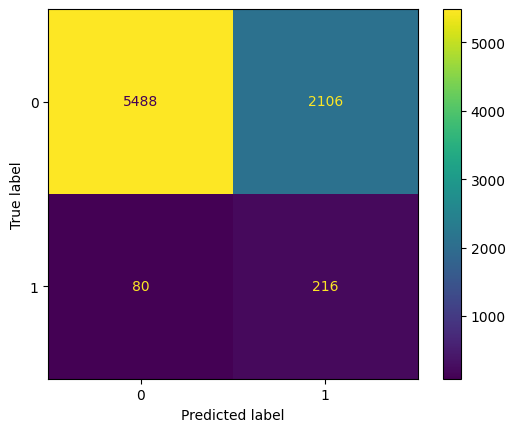

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

conf_matrix_plot(naive_bayes_model, X_test_nb, y_test)

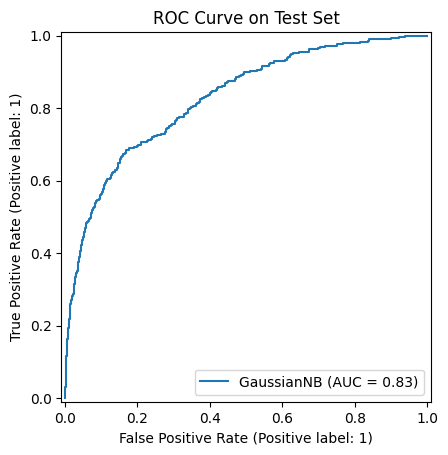

In [ ]:
from sklearn.metrics import RocCurveDisplay
warnings.filterwarnings("ignore", category=DeprecationWarning)

RocCurveDisplay.from_estimator(naive_bayes_model, X_test_nb, y_test)
plt.title('ROC Curve on Test Set')
plt.show()

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

y_preds_series = pd.Series(y_pred_nb)

# Now you can use value_counts()
y_preds_series.value_counts()

,count
0,5568
1,2322


### **KNN Model**

ภาพรวมขั้นตอนการทำโมเดล KNN

KNN เป็นโมเดลที่อิงจาก “ระยะทาง” จึงต้องมี preprocessing ที่ถูกต้อง

ขั้นตอนทั้งหมด:

1. เลือกฟีเจอร์ (X) และ target (y)

2. แบ่ง train/test

3. Scaling ข้อมูล (สำคัญมาก!!)

4. สร้างโมเดล KNN

5. Train model (fit())

6. Test model (predict())

7. Evaluate (accuracy, confusion matrix)

8. Tune K (เลือก K ที่ดีที่สุด)

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

X_train_knn = X_train_res
X_test_knn = X_test

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

knn = KNeighborsClassifier(n_neighbors=5)   # เริ่มจาก K=5

#### Hyperparameter Tuning (RandomSearchCV + GridSearchCV)

ใช้ Random Search เพื่อหาคร่าวๆ

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

# 1. ตั้ง Range ให้กว้างๆ ไว้ก่อน
param_dist = {
    "n_neighbors": range(1, 31, 2),        # ลองตั้งแต่ 1 ถึง 31 (โดดทีละ 2)
    "weights": ["uniform", "distance"],    # ลองทั้ง 2 แบบ
    "metric": ["euclidean", "manhattan"]   # ลองทั้ง 2 สูตร
}

# 2. สุ่มมาเทสแค่ 10 รูปแบบพอ (เร็วมาก)
random_search = RandomizedSearchCV(
    estimator=KNeighborsClassifier(),
    param_distributions=param_dist,
    n_iter=10,                  # ⚠️ สุ่มมา 10 แบบพอ
    cv=3,                       # 3-Fold ก็พอสำหรับเทส
    scoring="f1",               # เน้น F1 (เพราะเราแคร์เพลงฮิต)
    n_jobs=-1,
    random_state=42
)

random_search.fit(X_train_res, y_train_res)

print(f"Best params from Random Search: {random_search.best_params_}")

Best params from Random Search: {'weights': 'uniform', 'n_neighbors': 1, 'metric': 'euclidean'}


ใช้ Grid Search เพื่อ finetune

In [ ]:
# สมมติรอบแรกได้ K=13 เราจะลองเช็คแค่ 11, 13, 15 (บวกลบนิดหน่อย)
param_grid_focused = {
    "n_neighbors": [1, 3, 5, 7],
    "weights": ["uniform"],
    "metric": ["euclidean"]
}

grid_search_final = GridSearchCV(
    estimator=KNeighborsClassifier(),
    param_grid=param_grid_focused,
    cv=5,                                  # รอบนี้เอาชัวร์ ใช้ 5-Fold ไปเลย
    scoring="f1",
    n_jobs=-1
)

grid_search_final.fit(X_train_knn, y_train_res)

print(f"🏆 The Real Best Params: {grid_search_final.best_params_}")
print(f"🏆 Best F1 Score: {grid_search_final.best_score_}")

🏆 The Real Best Params: {'metric': 'euclidean', 'n_neighbors': 1, 'weights': 'uniform'}
🏆 Best F1 Score: 0.883564592050039


#### ดูผล GridSearch (best K + best score)

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

best_params = grid_search_final.best_params_
best_score = grid_search_final.best_score_

print(f"Best cross-validation score: {best_score:.3f}")
print("Best params:", best_params)

Best cross-validation score: 0.884
Best params: {'metric': 'euclidean', 'n_neighbors': 1, 'weights': 'uniform'}


#### ใช้โมเดลที่ดีที่สุดไปทดสอบบน Test set

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# ดึงโมเดลที่ดีที่สุดออกมา
best_knn_model = grid_search_final.best_estimator_

# ทำนายบน test set
y_pred_knn = best_knn_model.predict(X_test)

# ประเมินผล
print("Test Accuracy:", accuracy_score(y_test, y_pred_knn))
print("\nClassification Report:\n", classification_report(y_test, y_pred_knn))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred_knn))

Test Accuracy: 0.9108998732572877

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.94      0.95      7594
           1       0.13      0.23      0.16       296

    accuracy                           0.91      7890
   macro avg       0.55      0.59      0.56      7890
weighted avg       0.94      0.91      0.92      7890


Confusion Matrix:
 [[7118  476]
 [ 227   69]]


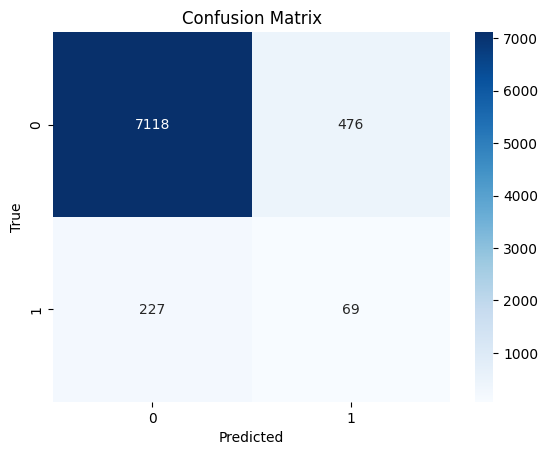

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

y_pred_knn = best_knn_model.predict(X_test_knn)

cm = confusion_matrix(y_test, y_pred_knn)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

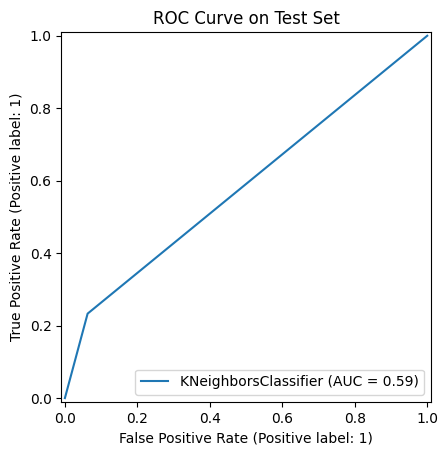

In [ ]:
from sklearn.metrics import RocCurveDisplay
warnings.filterwarnings("ignore", category=DeprecationWarning)

RocCurveDisplay.from_estimator(best_knn_model, X_test_knn, y_test)
plt.title('ROC Curve on Test Set')
plt.show()

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 3592 (\N{THAI CHARACTER CHO CHAN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 3633 (\N{THAI CHARACTER MAI HAN-AKAT}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 3610 (\N{THAI CHARACTER BO BAIMAI}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 3648 (\N{THAI CHARACTER SARA E}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 3614 (\N{THAI CHARACTER PHO PHAN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(byt

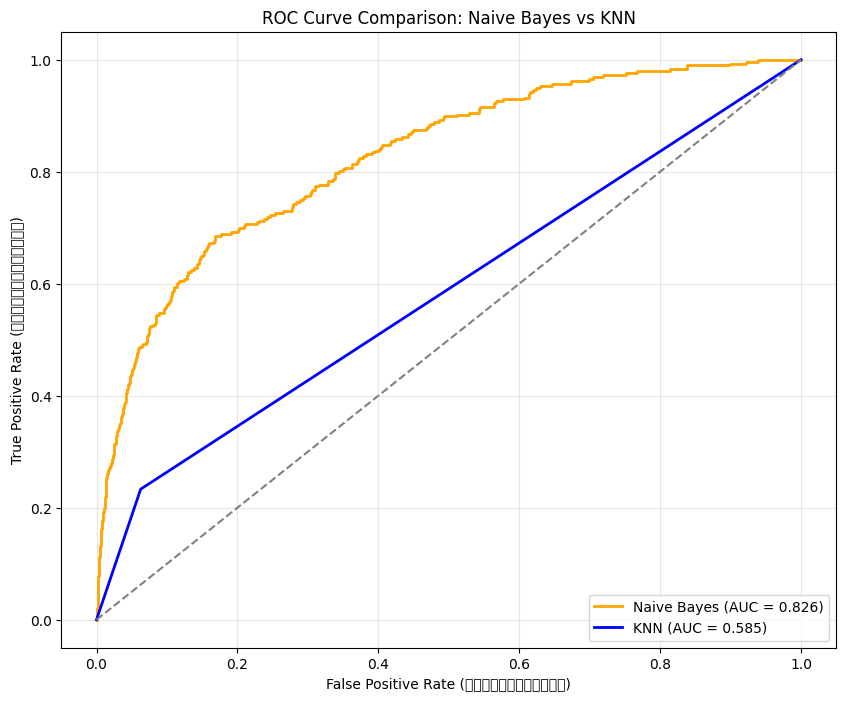

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, roc_auc_score

warnings.filterwarnings("ignore", category=DeprecationWarning)

# 1. เตรียมข้อมูล (Probability)
# .predict_proba จะให้ค่าความมั่นใจออกมา (ไม่ใช่แค่ 0 หรือ 1)
# เราเอาคอลัมน์ [:, 1] คือความน่าจะเป็นที่จะเป็น "Hit"
y_prob_nb = naive_bayes_model.predict_proba(X_test)[:, 1]
y_prob_knn = best_knn_model.predict_proba(X_test)[:, 1]

# 2. คำนวณ ROC & AUC
fpr_nb, tpr_nb, _ = roc_curve(y_test, y_prob_nb)
auc_nb = roc_auc_score(y_test, y_prob_nb)

fpr_knn, tpr_knn, _ = roc_curve(y_test, y_prob_knn)
auc_knn = roc_auc_score(y_test, y_prob_knn)

# 3. วาดกราฟเทียบกัน
plt.figure(figsize=(10, 8))

# เส้นโมเดล Naive Bayes
plt.plot(fpr_nb, tpr_nb, label=f'Naive Bayes (AUC = {auc_nb:.3f})', color='orange', linewidth=2)

# เส้นโมเดล KNN
plt.plot(fpr_knn, tpr_knn, label=f'KNN (AUC = {auc_knn:.3f})', color='blue', linewidth=2)

# เส้นประตรงกลาง (เดามั่ว)
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')

plt.xlabel('False Positive Rate (ทายผิดว่าฮิต)')
plt.ylabel('True Positive Rate (จับเพลงฮิตได้)')
plt.title('ROC Curve Comparison: Naive Bayes vs KNN')
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.show()

### RandomForest

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

from sklearn.ensemble import RandomForestClassifier

# 1. สร้างโมเดล Random Forest
rf_model = RandomForestClassifier(
    n_estimators=200,           # ใช้ต้นไม้ 200 ต้น (ช่วยเรื่องความแม่นยำ)
    max_depth=20,               # จำกัดความลึก (กัน Overfitting)
    min_samples_leaf=2,         # ต้องมีข้อมูลอย่างน้อย 2 ตัวในใบไม้ (ลด Noise)
    class_weight='balanced',    # <--- พระเอก! สั่งให้แคร์เพลงฮิตมากกว่าเพลงทั่วไป
    random_state=42,
    n_jobs=-1                   # ใช้ทุก Core CPU
)

rf_model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=20,
                       min_samples_leaf=2, n_estimators=200, n_jobs=-1,
                       random_state=42)


--- Random Forest Results ---
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      7594
           1       0.25      0.49      0.33       296

    accuracy                           0.92      7890
   macro avg       0.61      0.71      0.64      7890
weighted avg       0.95      0.92      0.94      7890



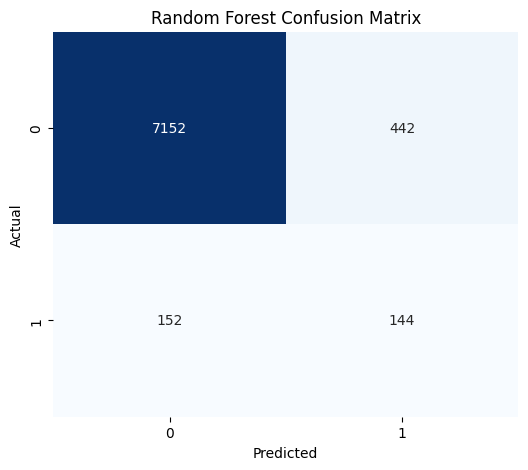

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# 2. วัดผล
print("\n--- Random Forest Results ---")
y_pred_rf = rf_model.predict(X_test)

print(classification_report(y_test, y_pred_rf))

# 3. แสดง Confusion Matrix แบบสวยๆ
cm = confusion_matrix(y_test, y_pred_rf)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Random Forest Confusion Matrix')
plt.show()

/tmp/ipython-input-1690962455.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_imp_df, palette='viridis')


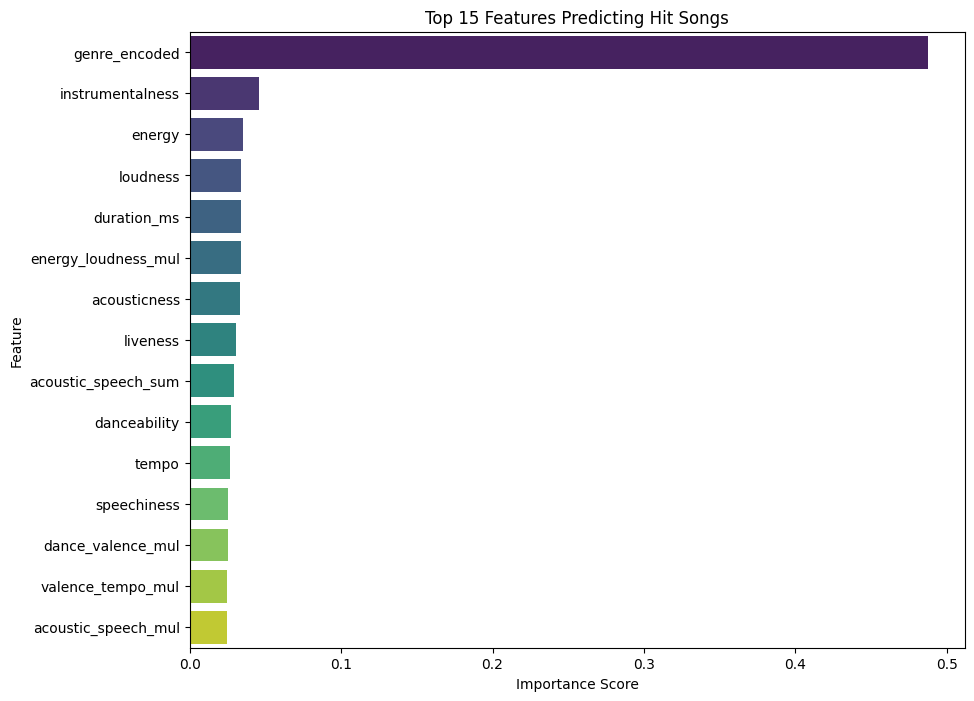

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# ดึงค่าความสำคัญออกมา
importances = rf_model.feature_importances_
feature_names = X_train.columns

# สร้าง DataFrame และเรียงลำดับ
feature_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False).head(15) # เอา Top 15

# พล็อตกราฟ
plt.figure(figsize=(10, 8))
sns.barplot(x='Importance', y='Feature', data=feature_imp_df, palette='viridis')
plt.title('Top 15 Features Predicting Hit Songs')
plt.xlabel('Importance Score')
plt.show()

### RandomForest + SMOTE

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

from sklearn.ensemble import RandomForestClassifier

# 1. สร้างโมเดล Random Forest
rf_model_2 = RandomForestClassifier(
    n_estimators=200,           # ใช้ต้นไม้ 200 ต้น (ช่วยเรื่องความแม่นยำ)
    max_depth=20,               # จำกัดความลึก (กัน Overfitting)
    min_samples_leaf=2,         # ต้องมีข้อมูลอย่างน้อย 2 ตัวในใบไม้ (ลด Noise)
    random_state=42,
    n_jobs=-1                   # ใช้ทุก Core CPU
)

rf_model_2.fit(X_train_res, y_train_res)

RandomForestClassifier(max_depth=20, min_samples_leaf=2, n_estimators=200,
                       n_jobs=-1, random_state=42)


--- Random Forest Results ---
              precision    recall  f1-score   support

           0       0.98      0.96      0.97      7594
           1       0.28      0.43      0.34       296

    accuracy                           0.94      7890
   macro avg       0.63      0.69      0.65      7890
weighted avg       0.95      0.94      0.94      7890



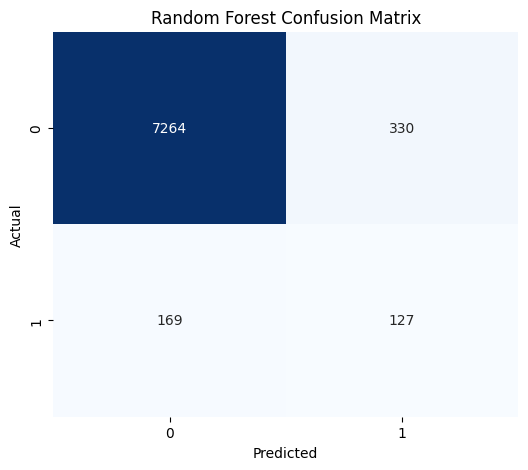

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# 2. วัดผล
print("\n--- Random Forest Results ---")
y_pred_rf_smote = rf_model_2.predict(X_test)

print(classification_report(y_test, y_pred_rf_smote))

# 3. แสดง Confusion Matrix แบบสวยๆ
cm = confusion_matrix(y_test, y_pred_rf_smote)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Random Forest Confusion Matrix')
plt.show()

/tmp/ipython-input-3877331801.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_imp_df, palette='viridis')


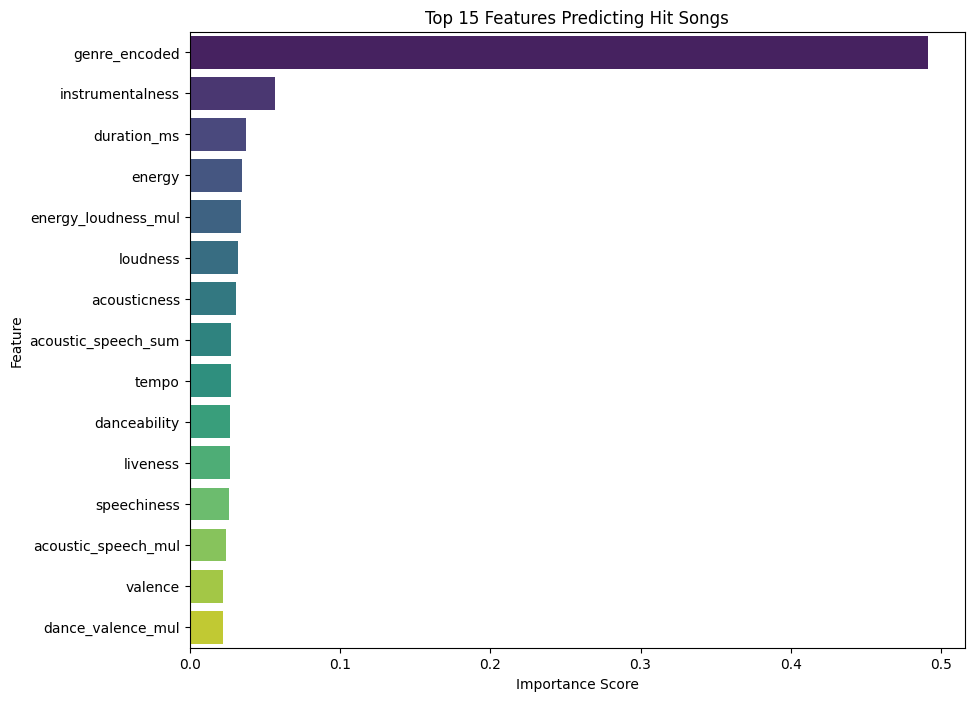

In [ ]:
warnings.filterwarnings("ignore", category=DeprecationWarning)

# ดึงค่าความสำคัญออกมา
importances = rf_model_2.feature_importances_
feature_names = X_train.columns

# สร้าง DataFrame และเรียงลำดับ
feature_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False).head(15) # เอา Top 15

# พล็อตกราฟ
plt.figure(figsize=(10, 8))
sns.barplot(x='Importance', y='Feature', data=feature_imp_df, palette='viridis')
plt.title('Top 15 Features Predicting Hit Songs')
plt.xlabel('Importance Score')
plt.show()

## **Summary**

### Summary of Model Performance

| Model | TN | FP | FN | TP | Precision (Hit=1) | Recall (Hit=1) | F1 (Hit=1) | Accuracy |
|------|-----|------|------|-----|-------------------|------------------|-------------|-----------|
| **Naive Bayes** | 5488 | 2106 | 80 | 216 | **0.09** | **0.73** | 0.17 | 0.72 |
| **KNN** | 7118 | 476 | 227 | 69 | **0.13** | **0.23** | 0.16 | 0.91 |
| **Random Forest (No SMOTE)** | 7152 | 442 | 152 | 144 | **0.25** | **0.49** | 0.33 | 0.92 |
| **Random Forest (With SMOTE)** | 7264 | 330 | 169 | 127 | **0.27** | **0.43** | 0.33 | 0.92 |


| Model                          | False Positive | False Negative | F1-Score | จุดเด่น / จุดด้อย |
|-------------------------------|----------------|----------------|----------|----------------------|
| **Naive Bayes**               | 2,106 เพลง     | 80 เพลง        | 0.17     | *ทายผิดว่าเป็นฮิตเยอะมาก → ไม่เหมาะกับงานนี้ เพราะ Precision ต่ำมาก (0.09)* |
| **KNN**                       | 476 เพลง       | 227 เพลง       | 0.16     | *สมดุลกว่า Naive Bayes ทำนายฮิตได้ดีขึ้น แต่ยังจับเพลงฮิตจริงได้น้อย (Recall 0.23)* |
| **Random Forest (No SMOTE)**  | 442 เพลง       | 152 เพลง       | 0.33     | *แม่นกว่า KNN และ NB มาก จับเพลงฮิตได้ดีขึ้น แต่ยังมี bias ไปทาง Non-Hit* |
| **Random Forest (SMOTE)**     | **330 เพลง (น้อยที่สุด)** | 169 เพลง | **0.33–0.35 (สูงสุด)** | *ดีที่สุด! Precision สูง (0.25) False Positive ต่ำสุด เหมาะสำหรับใช้แนะนำเพลงที่ “มีโอกาสติดชาร์ตสูง”* |


In [ ]:
# ==========================================
# ตั้งค่าตัวแปร (สมมติว่ามีตัวแปรเหล่านี้อยู่แล้ว)
# ==========================================
# รวมโมเดลไว้ใน Dictionary เพื่อวนลูปทำรายงาน
models = {
    "Naive Bayes": y_pred_nb,
    "KNN (K=1)": y_pred_knn,
    "RF (No SMOTE)": y_pred_rf,
    "RF (SMOTE)": y_pred_rf_smote
}

# ==========================================
# ส่วนแสดงเฉลย (Ground Truth)
# ==========================================
total_hits = sum(y_test == 1)
total_non_hits = sum(y_test == 0)

print(f"--- ความจริง (Ground Truth) ---")
print(f"เพลงทั้งหมดในข้อสอบ: {len(y_test):,} เพลง")
print(f"เพลงที่ฮิตจริงๆ มี:   {total_hits} เพลง")
print(f"เพลงที่ไม่ฮิตจริงๆ มี: {total_non_hits:,} เพลง")
print("="*60 + "\n")

# ==========================================
# ส่วนสรุปผลแบบภาษาคน (Human-Readable Report)
# ==========================================
results_list = []

for name, preds in models.items():
    tn, fp, fn, tp = confusion_matrix(y_test, preds).ravel()

    # คำนวณ %
    recall = (tp / total_hits) * 100 if total_hits > 0 else 0
    precision = (tp / (tp + fp)) * 100 if (tp + fp) > 0 else 0

    print(f"โมเดล: {name}")
    print(f"   หาเพลงฮิตเจอ:       {tp} เพลง (จากทั้งหมด {total_hits} เพลง) --> คิดเป็น {recall:.1f}%")
    print(f"   ทายมั่วว่าฮิต (ผิด):    {fp} เพลง (ฟังฟรีๆ ไป {fp} เพลง)")
    print(f"   ความแม่นยำ:         ทายว่าฮิต 100 ครั้ง ถูกจริง {precision:.1f} ครั้ง")
    print("-" * 40)

    # เก็บใส่ตารางไว้ดูเทียบกันตอนจบ
    results_list.append({
        "Model": name,
        "หาเจอ (Recall)": f"{tp}/{total_hits} ({recall:.1f}%)",
        "ทายมั่ว (FP)": f"{fp} เพลง",
        "ความแม่น (Precision)": f"{precision:.1f}%"
    })

# ==========================================
# ตารางสรุปจบ (Final Comparison)
# ==========================================
df_summary = pd.DataFrame(results_list).set_index("Model")
display(df_summary)

--- ความจริง (Ground Truth) ---
เพลงทั้งหมดในข้อสอบ: 7,890 เพลง
เพลงที่ฮิตจริงๆ มี:   296 เพลง
เพลงที่ไม่ฮิตจริงๆ มี: 7,594 เพลง

โมเดล: Naive Bayes
   หาเพลงฮิตเจอ:       216 เพลง (จากทั้งหมด 296 เพลง) --> คิดเป็น 73.0%
   ทายมั่วว่าฮิต (ผิด):    2106 เพลง (ฟังฟรีๆ ไป 2106 เพลง)
   ความแม่นยำ:         ทายว่าฮิต 100 ครั้ง ถูกจริง 9.3 ครั้ง
----------------------------------------
โมเดล: KNN (K=1)
   หาเพลงฮิตเจอ:       69 เพลง (จากทั้งหมด 296 เพลง) --> คิดเป็น 23.3%
   ทายมั่วว่าฮิต (ผิด):    476 เพลง (ฟังฟรีๆ ไป 476 เพลง)
   ความแม่นยำ:         ทายว่าฮิต 100 ครั้ง ถูกจริง 12.7 ครั้ง
----------------------------------------
โมเดล: RF (No SMOTE)
   หาเพลงฮิตเจอ:       144 เพลง (จากทั้งหมด 296 เพลง) --> คิดเป็น 48.6%
   ทายมั่วว่าฮิต (ผิด):    442 เพลง (ฟังฟรีๆ ไป 442 เพลง)
   ความแม่นยำ:         ทายว่าฮิต 100 ครั้ง ถูกจริง 24.6 ครั้ง
----------------------------------------
โมเดล: RF (SMOTE)
   หาเพลงฮิตเจอ:       127 เพลง (จากทั้งหมด 296 เพลง) --> คิดเป็น 42.9%
   ทายมั่วว่าฮิต (ผิด): 

,หาเจอ (Recall),ทายมั่ว (FP),ความแม่น (Precision)
Model,,,
Naive Bayes,216/296 (73.0%),2106 เพลง,9.3%
KNN (K=1),69/296 (23.3%),476 เพลง,12.7%
RF (No SMOTE),144/296 (48.6%),442 เพลง,24.6%
RF (SMOTE),127/296 (42.9%),330 เพลง,27.8%


### **Data Pre-processing, Cleaning, Transforming & Enriching**  

## **1. Data Preprocessing — ตรวจสอบและจัดเตรียมข้อมูลเบื้องต้น**

### 1.1 ตรวจสอบ Missing Values
พบ Missing ในคอลัมน์  
- `artists`  
- `album_name`  
- `track_name`  

➡ วิธีแก้: ลบแถวที่มี Missing Values

---

### 1.2 ลบคอลัมน์ที่ไม่จำเป็น
เพื่อลด noise และลดจำนวนฟีเจอร์ที่ไม่เกี่ยวข้อง  
คอลัมน์ที่ถูกลบ:
- `Unnamed: 0`
- `track_id`
- `artists`
- `album_name`
- `track_name`

---

### 1.3 แยกประเภทของฟีเจอร์
- **Numerical Features:** duration_ms, tempo, loudness, energy, valence, acousticness ฯลฯ  
- **Categorical Features:** explicit, key, mode, time_signature, track_genre  

---

### 1.4 ตรวจสอบ Outliers
ใช้ทั้ง  
- **Z-score**  
- **IQR**  

พบ outliers สูงในคอลัมน์  
- `duration_ms`  
- `instrumentalness`  
- `tempo`  

➡ ยังไม่ลบทันที รอจัดการในขั้นตอน Transform

---

<br>

# **2. Transforming รอบแรก — Cleaning / Filtering**

### 2.1 ลบ Podcast / Non-music Tracks
- ลบแถวที่มี `speechiness > 0.66`  
(มักเป็น Podcast, Spoken word)

---

### 2.2 แก้ค่า Time Signature ผิดปกติ
- ช่วงปกติคือ 3–7  
- หากนอกช่วง → แทนด้วย median

---

### 2.3 ลบเพลงที่มีค่าฟีเจอร์ผิดโดเมน
ตัวอย่างฟีเจอร์ที่กรองออก:
- `duration_ms` < 30,000 หรือ > 600,000  
- `tempo` < 40 หรือ > 250  
- `loudness` < -60 หรือ > 0  

ช่วยลดข้อมูลผิดปกติและทำให้ dataset สะอาดขึ้น

---

### 2.4 ลบ Missing ของ popularity
เพราะใช้สร้าง target variable → ต้องครบ 100%

---

### 📉 ผลลัพธ์หลัง Cleaning
จำนวนข้อมูลลดลงจาก:  
113,999 → 112,267 → 109,193 → **78,893 แถว**

---

<br>

# **3. Enriching — เพิ่มคุณค่าของข้อมูล**

### 3.1 สร้าง Target Variable: `is_hit`
เงื่อนไขเพลงฮิต:
- `popularity ≥ 70` → 1 (Hit Song)  
- `popularity < 70` → 0 (Non-Hit)

สัดส่วนข้อมูล (Class Imbalance):  
- Non-hit ≈ 95.2%  
- Hit ≈ 4.8%

---

<br>

# **4. Transform & Cleaning รอบสอง**

### 4.1 แปลง Data Types
- explicit → boolean → integer (0/1)

---

### 4.2 ลบ Genre ที่ไม่ใช่เพลงจริง
เช่น:  
`white-noise`, `rain`, `sleep`, `asmr`, `comedy`, `sound-effects`, `study`  

จำนวนที่ลบ: **3,074 แถว**

---

### 4.3 ลบข้อมูลซ้ำแบบ Advanced
ลบ duplicates โดยดูจากฟีเจอร์เสียง เช่น  
tempo, loudness, valence, energy, instrumentalness, speechiness

ผลลัพธ์:  
109,193 → **78,893 แถว**

---

<br>

# **5. Feature Engineering — สร้างฟีเจอร์ใหม่**

### สร้าง Interaction Features:
- `energy_loudness_mul  = energy * loudness`
- `dance_valence_mul    = danceability * valence`
- `dance_valence_avg    = (danceability + valence) / 2`
- `valence_tempo_mul    = valence * tempo`
- `acoustic_speech_mul  = acousticness * speechiness`
- `acoustic_speech_sum  = acousticness + speechiness`

### Genre Encoding (ป้องกัน Data Leakage)
- คำนวณ hit-rate ของ `track_genre` จาก **Train set เท่านั้น**
- สร้างฟีเจอร์ใหม่ `genre_encoded`
- ลบคอลัมน์ `track_genre` เดิมออก

---

<br>

# **6. Train/Test Split**

- 90% → Train  
- 10% → Test  
- `stratify = y` เพื่อรักษาสัดส่วน Hit/Non-hit  
- `random_state = 42`

ผลลัพธ์:
- Train = **71,003 แถว**  
- Test = **7,890 แถว**

---

<br>

# **7. Log Transformation**

ใช้กับฟีเจอร์ที่มี Right Skewed Distribution เช่น:
- `duration_ms`
- `liveness`
- `speechiness`
- `instrumentalness`

ฟังก์ชันที่ใช้: `np.log1p()`

---

<br>

# **8. Scaling — Robust + MinMax**

### 8.1 Robust Scaling  
ใช้กับฟีเจอร์ที่มี outliers หนัก:
- `loudness`
- `tempo`

ให้ความทนทานต่อ outliers เพราะใช้ median + IQR

---

### 8.2 MinMax Scaling  
ใช้กับฟีเจอร์ทั้งหมดที่เหลือ รวมถึงค่าที่ผ่าน log เช่น:
- danceability  
- energy  
- valence  
- acousticness  
- interaction features ทั้งหมด  

ทำให้ค่าทั้งหมดอยู่ในช่วง **0–1**  
เหมาะกับโมเดลที่ sensitive เช่น KNN

---

# สรุปกระบวนการทั้งหมด
1. **Cleaning:** ลบข้อมูลที่ผิดปกติ / Non-music / podcasts  
2. **Transform:** แก้ Outliers, Log Transform  
3. **Enrich:** สร้าง Target (`is_hit`), Encode Genre  
4. **Feature Engineering:** Interaction Features  
5. **Train/Test Split:** 90/10 พร้อม Stratify  
6. **Scaling:** Robust + MinMax

---



### **สรุปผลการสร้างและการประเมินโมเดล Machine Learning**

หลังจากที่เราได้เตรียมข้อมูลอย่างครบถ้วนแล้ว เราได้ทำการสร้างและประเมินโมเดล Machine Learning เพื่อคาดการณ์เพลงฮิต (โดย `is_hit = 1`) โดยได้ทดลองสร้าง 3 โมเดลหลัก ได้แก่ Naive Bayes, K-Nearest Neighbors (KNN) และ Random Forest (ในสองรูปแบบ คือแบบไม่ใช้ SMOTE และใช้ SMOTE) ก่อนเริ่มสร้างโมเดล เราได้จัดการปัญหา Class Imbalance โดยการใช้เทคนิค SMOTE (Synthetic Minority Over-sampling Technique) ในอัตราส่วน 0.3 สำหรับชุดข้อมูล Train ในบางโมเดล เพื่อให้โมเดลสามารถเรียนรู้จาก Class เพลงฮิตได้ดียิ่งขึ้น

### 1. โมเดล Naive Bayes

**การสร้างและการ Train:** โมเดล Gaussian Naive Bayes ถูกนำมาใช้ด้วยความรวดเร็วและเรียบง่าย โดยทำการ Train ด้วยชุดข้อมูลที่ผ่านการทำ SMOTE แล้ว (X_train_res, y_train_res)

**ผลลัพธ์บน Test Set:**
*   **Recall (ความสามารถในการหาเพลงฮิตเจอ):** โมเดลนี้มี Recall สูงถึง 73.0% ซึ่งหมายความว่าสามารถระบุเพลงฮิตได้ 216 เพลง จากทั้งหมด 296 เพลงฮิตจริงในชุดทดสอบ
*   **Precision (ความแม่นยำในการทายว่าฮิต):** อย่างไรก็ตาม Precision ของโมเดลนี้ต่ำมาก เพียง 9.3% ซึ่งหมายความว่าหากโมเดลทายว่ามีเพลงฮิต 100 ครั้ง จะถูกจริงเพียง 9.3 ครั้งเท่านั้น
*   **False Positive (ทายผิดว่าฮิต):** โมเดลมีการทายผิดว่าเป็นเพลงฮิตสูงถึง 2,106 เพลง

**ข้อสรุป:** โมเดล Naive Bayes แม้จะมีความสามารถในการตรวจจับเพลงฮิตได้ดี (Recall สูง) แต่มี Precision ที่ต่ำมากและมี False Positive สูง ทำให้ไม่เหมาะกับการใช้งานจริงที่ต้องการความแม่นยำในการคัดกรองเพลงฮิต เนื่องจากผู้ใช้งานจะต้องเสียเวลาไปกับเพลงที่ถูกทายผิดจำนวนมาก

### 2. โมเดล K-Nearest Neighbors (KNN)

**การสร้างและการ Train:** โมเดล KNN ถูก Train โดยใช้ชุดข้อมูลที่ผ่านการทำ SMOTE แล้ว (X_train_res, y_train_res) โดยเน้นที่การวัดระยะทางระหว่างจุดข้อมูล

**การปรับ Hyperparameter:** เราใช้ RandomizedSearchCV ในการค้นหาช่วงของ Hyperparameter ที่เหมาะสม และตามด้วย GridSearchCV เพื่อ Fine-tune อย่างละเอียด โดยได้ค่าที่ดีที่สุดสำหรับ `n_neighbors = 1`, `weights = 'uniform'` และ `metric = 'euclidean'` ด้วย Best F1 Score 0.884 จากการตรวจสอบชุด Train.

**ผลลัพธ์บน Test Set:**
*   **Recall (ความสามารถในการหาเพลงฮิตเจอ):** โมเดลนี้มี Recall อยู่ที่ 23.3% โดยสามารถระบุเพลงฮิตได้ 69 เพลง จาก 296 เพลงฮิตจริง
*   **Precision (ความแม่นยำในการทายว่าฮิต):** Precision ของ KNN อยู่ที่ 12.7%
*   **False Positive (ทายผิดว่าฮิต):** โมเดลมี False Positive ที่ 476 เพลง ซึ่งน้อยกว่า Naive Bayes อย่างมีนัยสำคัญ

**ข้อสรุป:** โมเดล KNN ที่ปรับจูนแล้วให้ผลลัพธ์ที่สมดุลกว่า Naive Bayes อย่างมาก มี Precision ที่ดีขึ้นและ False Positive ที่ลดลงมาก ทำให้เป็นตัวเลือกที่เหมาะสมสำหรับการใช้งานที่ต้องการลดจำนวนเพลงที่ทายผิดว่าเป็นเพลงฮิต ขณะที่ยังคงมีความสามารถในการค้นหาเพลงฮิตอยู่บ้าง

### 3. โมเดล Random Forest

**3.1 Random Forest (ไม่มี SMOTE)**

**การสร้างและการ Train:** โมเดลถูกสร้างด้วย `n_estimators=200`, `max_depth=20`, `min_samples_leaf=2` และใช้ `class_weight='balanced'` เพื่อให้โมเดลให้ความสำคัญกับ Class เพลงฮิตมากขึ้น โดย Train ด้วยชุดข้อมูล X_train และ y_train ดั้งเดิม (ไม่ได้ทำ SMOTE)

**ผลลัพธ์บน Test Set:**
*   **Recall (ความสามารถในการหาเพลงฮิตเจอ):** โมเดลนี้มี Recall อยู่ที่ 48.6% โดยสามารถระบุเพลงฮิตได้ 144 เพลง จาก 296 เพลงฮิตจริง
*   **Precision (ความแม่นยำในการทายว่าฮิต):** Precision อยู่ที่ 24.6%
*   **False Positive (ทายผิดว่าฮิต):** โมเดลมี False Positive ที่ 442 เพลง

**ข้อสรุป:** โมเดล Random Forest ที่ไม่ใช้ SMOTE ให้ Recall ที่ดีใกล้เคียงกับ KNN และมี Precision ที่ยอมรับได้ โดยเป็นตัวเลือกที่ดีสำหรับการค้นหาเพลงฮิตจำนวนมาก.

**3.2 Random Forest (ใช้ SMOTE)**

**การสร้างและการ Train:** โมเดลนี้ใช้ Hyperparameter คล้ายกับเวอร์ชันแรก แต่ไม่ได้ใช้ `class_weight='balanced'` เนื่องจากปัญหา Class Imbalance ถูกจัดการด้วย SMOTE ในชุดข้อมูล X_train_res และ y_train_res แล้ว

**ผลลัพธ์บน Test Set:**
*   **Recall (ความสามารถในการหาเพลงฮิตเจอ):** โมเดลนี้มี Recall อยู่ที่ 42.9% โดยสามารถระบุเพลงฮิตได้ 127 เพลง จาก 296 เพลงฮิตจริง
*   **Precision (ความแม่นยำในการทายว่าฮิต):** Precision สูงที่สุดในบรรดาโมเดลทั้งหมดที่ 27.8%
*   **False Positive (ทายผิดว่าฮิต):** โมเดลมี False Positive ที่ต่ำที่สุดที่ 330 เพลง

**ข้อสรุป:** โมเดล Random Forest ที่ใช้ SMOTE ให้ Precision ที่สูงที่สุด ซึ่งหมายความว่าเมื่อโมเดลนี้ทายว่าเพลงใดเป็นเพลงฮิต ความน่าจะเป็นที่จะถูกมีสูงกว่าโมเดลอื่น ๆ อย่างไรก็ตาม Recall จะลดลงเล็กน้อย ทำให้พลาดการระบุเพลงฮิตจริงไปบ้าง แต่เหมาะสำหรับสถานการณ์ที่ต้องการความแม่นยำสูงสุดในการคัดกรองเพลงฮิต

### สรุปถึงการแก้ปัญหาที่ได้ตั้งไว้

### **การคาดการณ์เพลงฮิต: ข้อได้เปรียบเชิงกลยุทธ์ในอุตสาหกรรมเพลง**

ในยุคที่อุตสาหกรรมเพลงมีการแข่งขันสูง การรู้ล่วงหน้าว่าเพลงใหม่มีโอกาสเป็น **เพลงฮิต (Hit Song)** หรือไม่  
ถือเป็นข้อได้เปรียบสำคัญสำหรับค่ายเพลง ศิลปิน และทีมการตลาด เพราะช่วย:

- วางแผนโปรโมตได้ตรงจุด  
- ใช้งบประมาณอย่างคุ้มค่า  
- ลดความเสี่ยงในการลงทุนในเพลงที่ไม่มีศักยภาพ  
- ขยายกำไรจากเพลงที่มีโอกาสเป็นไวรัล  

แต่การคาดการณ์ว่าเพลงจะฮิตหรือไม่นั้นไม่ง่าย เพราะข้อมูลของเพลงหนึ่งๆ มีหลายมิติ เช่น  
**acoustic features, tempo, energy, valence, loudness, speechiness**  
รวมถึง metadata อื่นๆ ที่ซับซ้อนและมีความสัมพันธ์เชิงลึก  
ซึ่งมนุษย์ไม่สามารถมองเห็น pattern ได้ชัดเจน จึงต้องอาศัย **Machine Learning**

---

# โมเดล Machine Learning เพื่อการคาดการณ์เพลงฮิต

เราได้ทดลองโมเดลหลายตัว แต่โมเดลที่โดดเด่น และให้ประโยชน์เชิงกลยุทธ์สูงสุดคือ

- **K-Nearest Neighbors (KNN)**  
- **Random Forest (RF) + SMOTE**

---

## 1) KNN — โมเดลที่ให้สมดุลดีที่สุดในการค้นหาเพลงฮิต

### **ผลการทำงานของ KNN**
- **Recall:** 23.3%  
  → จับเพลงฮิตได้ 69 เพลง จากทั้งหมด 296 เพลง  
- **Precision:** 12.7%  
- **F1-Score:** 0.16  
- **False Positive:** 476 เพลง (ทายว่าฮิตแต่ไม่ฮิต)

### จุดเด่นของ KNN
- ให้ความสมดุลระหว่างการจับเพลงฮิตและจำนวนรายการที่ทำนายผิด
- เหมาะสำหรับการหา *“เพลงที่มีแววเป็นฮิต”* ในกลุ่มกว้าง
- ควบคุม false positive ได้ดีกว่า Naive Bayes

### คำแนะนำสำหรับศิลปิน/ค่ายเพลง
หากเพลงของคุณมีคุณสมบัติที่โมเดล KNN บ่งชี้ว่ามีโอกาสฮิตสูง ถือเป็นสัญญาณที่ดีในการลงทุนโปรโมต และขยายงบประมาณการตลาดในช่องทางต่างๆ เพื่อเร่งการเข้าถึงผู้ฟัง

---

## 2) Random Forest + SMOTE — โมเดลที่แม่นยำที่สุดในการ “ยืนยัน” เพลงฮิต

### **ผลการทำงานของ RF (SMOTE)**
- **Recall:** 42.9%  
  → จับเพลงฮิตได้มากที่สุด (127 เพลงจาก 296)  
- **Precision:** 27.8% (สูงที่สุด)  
- **F1-Score:** 0.33  
- **False Positive ต่ำสุด:** 330 เพลง  

### จุดเด่นของ RF (SMOTE)
- มีความแม่นยำสูงที่สุดเมื่อทำนายว่าเพลงเป็นฮิต  
- False Positive ต่ำ→ ลดความเสี่ยงในการทุ่มโปรโมตผิดเพลง  
- เหมาะกับสถานการณ์ที่ต้องการความมั่นใจสูง

### คำแนะนำสำหรับศิลปิน/ค่ายเพลง
หากเพลงของคุณได้รับการยืนยันจากโมเดล RF (SMOTE) ว่ามีโอกาสฮิต นี่คือสัญญาณที่ชัดเจนมากว่าควรผลักดันเพลงนี้อย่างเต็มที่ การทราบถึงความแม่นยำในระดับนี้ช่วยให้สามารถจัดสรรงบประมาณโปรโมตได้อย่างตรงจุด และลดความเสี่ยงจากการลงทุนในเพลงที่ไม่มีศักยภาพลงได้มาก

---

# สรุป

- **KNN** → ดีสำหรับ “ค้นหาเพลงที่มีแววเป็นฮิต” (สแกนกว้าง, ดูแนวโน้ม)  
- **Random Forest (SMOTE)** → ดีสำหรับ “ยืนยันเพลงที่ควรลงทุนโปรโมต” (แม่นยำสูง)  

การใช้ทั้ง 2 โมเดลร่วมกัน  
ช่วยสร้างระบบคัดกรองเพลงฮิตแบบ 2 ชั้น (Two-Stage Hit Prediction):

**Stage 1: KNN** ตรวจจับเพลงที่มีศักยภาพ  
**Stage 2: RF (SMOTE)** ยืนยันเพลงที่ควรโปรโมตจริง  

ช่วยให้ค่ายเพลงลดต้นทุน แต่เพิ่มความสำเร็จของเพลงได้อย่างมีประสิทธิภาพที่สุด

---
